In [1]:
import numpy as np
import batman

import matplotlib.pyplot as plt
%matplotlib inline

import scipy
import scipy.stats as sp
import scipy.optimize as spopt

import emcee
import corner

import os
import time as t

import models_fit

from astropy.table import Table, Column
from astropy.stats import sigma_clip

In [2]:
# loading full data set for BIC calculation afterwards
foldername = 'ch2/01_Photometry/Fixed_Exact/Run11'          # location of data file
filename_full = 'new_ch2_datacube_full_AORs464.dat'  # name of data file

# get full data
FLUX, TIME, XDATA, YDATA = models_fit.get_full_data(foldername, filename_full)

# chronological order
index = np.argsort(TIME)
FLUX  = FLUX[index]
TIME  = TIME[index]
XDATA = XDATA[index]
YDATA = YDATA[index]

# crop the first AOR (11 to be changed manually)
FLUX  = FLUX[int(11*63):]
TIME  = TIME[int(11*63):]
XDATA = XDATA[int(11*63):]
YDATA = YDATA[int(11*63):]

# mask
mask = np.zeros(len(FLUX))
ind  = np.unique(np.concatenate((np.where(np.isnan(FLUX))[0], np.where(np.isnan(XDATA))[0], np.where(np.isnan(YDATA))[0])))
mask[ind] = 1 
FLUX = np.ma.masked_array(FLUX, mask=mask)
XDATA = np.ma.masked_array(XDATA, mask=mask)
YDATA = np.ma.masked_array(YDATA, mask=mask)

# Sigma clip per data cube
FLUX_clip  = sigma_clip(FLUX, sigma=6, iters=1)
XDATA_clip = sigma_clip(FLUX, sigma=6, iters=1)
YDATA_clip = sigma_clip(YDATA, sigma=3.5, iters=1)

# normalizing the flux
FLUX_clip = FLUX_clip/np.ma.median(FLUX_clip)

In [3]:
# paths
foldername = 'ch2/01_Photometry/Fixed_Exact/Run11'          # location of data file
filename   = 'new_ch2_datacube_binned_AORs464.dat'  # name of data file

save_path  = 'ch2/03_Model_Fitting/'            # location where outputs will be saved

# importing data
flux, flux_err, time, xdata, ydata, psfxw, psfyw = models_fit.get_data(foldername, 
                                                                       filename)

# sorting chronologically
index     = np.argsort(time)
time0      = time[index]
flux0      = flux[index]
flux_err0  = flux_err[index]
xdata0     = xdata[index]
ydata0     = ydata[index]
psfxw0     = psfxw[index]
psfyw0     = psfyw[index]

# determing AOR delimitation (do it manually for now...)
break1     = time0[11]                             # 0-11
break2     = time0[343]                            # 12-343
break3     = time0[676]                            # 344-676
break4     = time0[1009]                           # 677-1009
break5     = time0[1333]                           # 1010-1333
break6     = time0[1675]                           # 1334-1675
break7     = time0[2008]                           # 1676-2008
break8     = time0[2341]                           # 2009-2341
break9     = time0[2398]                           # 2342-2398

breaks     = np.array([break1, break2, break3, break4, break5, break6, break7, break8]) 

# chop dithered-calibration AOR
time       = time0[11:2398]
flux       = flux0[11:2398]
flux_err   = flux_err0[11:2398]
xdata      = xdata0[11:2398]
ydata      = ydata0[11:2398]
psfxw      = psfxw0[11:2398]
psfyw      = psfyw0[11:2398]

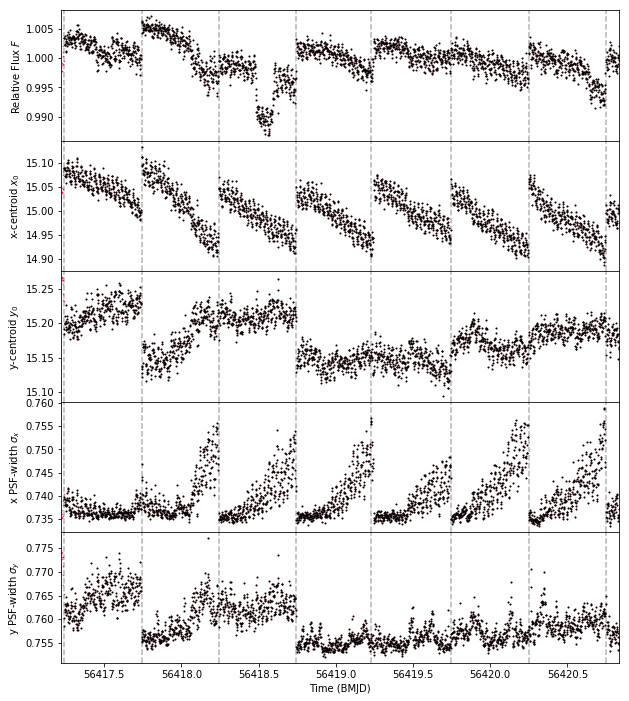

In [4]:
fig, axes = plt.subplots(5, 1, sharex=True, figsize=(10, 12))
#fig.suptitle("CoRoT-2b Observation")

axes[0].plot(time0[index], flux0[index],  'r.', markersize=1, alpha = 0.7)
axes[0].plot(time, flux,  'k.', markersize=2, alpha = 1.0)
axes[0].set_ylabel("Relative Flux $F$")
axes[0].set_xlim((np.min(time0), np.max(time0)))

axes[1].plot(time0[index], xdata0[index],  'r.', markersize=1, alpha = 0.7)
axes[1].plot(time, xdata,  'k.', markersize=2, alpha = 1.0)
axes[1].set_ylabel("x-centroid $x_0$")

axes[2].plot(time0[index], ydata0[index],  'r.', markersize=1, alpha = 0.7)
axes[2].plot(time, ydata, 'k.', markersize=2, alpha = 1.0)
axes[2].set_ylabel("y-centroid $y_0$")

axes[3].plot(time0[index], psfxw0[index],  'r.', markersize=1, alpha = 0.7)
axes[3].plot(time, psfxw, 'k.', markersize=2, alpha = 1.0)
axes[3].set_ylabel("x PSF-width $\sigma _x$")

axes[4].plot(time0[index], psfyw0[index],  'r.', markersize=1, alpha = 0.7)
axes[4].plot(time, psfyw,  'k.', markersize=2, alpha = 1.0)
axes[4].set_ylabel("y PSF-width $\sigma _y$")
axes[4].set_xlabel('Time (BMJD)')

for i in range(5):
    for j in range(len(breaks)):
        axes[i].axvline(x=breaks[j], color ='k', alpha=0.3, linestyle = 'dashed')
        
fig.subplots_adjust(hspace=0)
pathplot1 = save_path + '01_Raw_data.pdf'
fig.savefig(pathplot1, bbox_inches='tight')

# Polynomial order 2; Phase variation order 1

In [5]:
save_poly2_v1  = save_path + 'Poly2_v1/'            # location where outputs will be saved
if not os.path.exists(save_poly2_v1): os.makedirs(save_poly2_v1)

# Some variable def
r_star            = 1.377              # for XO-3 in solar radius
r_sol2jup         = 0.10049            # jupiter radius in solar radius
r_sol2AU          = 214.93946938       # AU radius in solar radius
hrs2days          = 1/24.0             # hour in days

t0   = 56418.540                       # BMJD time
per  = 3.1915239                       # in days
rp   = 0.125/r_star                    # radius (in solar radius)/stellar radius (solar radius) 
a    = 0.0454*r_sol2AU/r_star          # 
inc  = 84.20                           # 90 = edge-on                
ecosw= 0.277*np.cos(np.deg2rad(347.2)) # ecc and w from (Wong et aL. 2014) # np.cos only takes rad
esinw= 0.277*np.sin(np.deg2rad(347.2)) # ecc and w from (Wong et aL. 2014) # np.sin only takes rad
q1   = 0.001
q2   = 0.001
fp   = 0.0015                           # eclipse depth in units of stellar flux

# Phase Variation Parameters (2 params)
A    = 0.1
B    = 0.0

# pre-calculation
mid_x = np.mean(xdata)
mid_y = np.mean(ydata)

# photometric scatter
sigmaf = 0.01

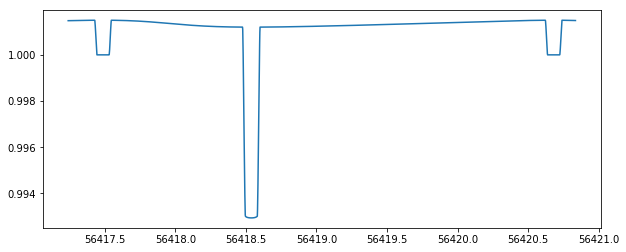

In [6]:
# calculate Initial guess for detector coefficients
astro = models_fit.phase_curve(time, t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B)
resid = flux/astro

plt.figure(figsize=(10,4))
plt.plot(time, astro)

c1 = 1.0
c2 = c3 = c4 = c5 = c6 = 0.0
p0 = np.array([c1, c2, c3, c4, c5, c6])

popt, pcov = scipy.optimize.curve_fit(models_fit.detec_poly, (xdata, ydata, mid_x, mid_y), resid, p0)

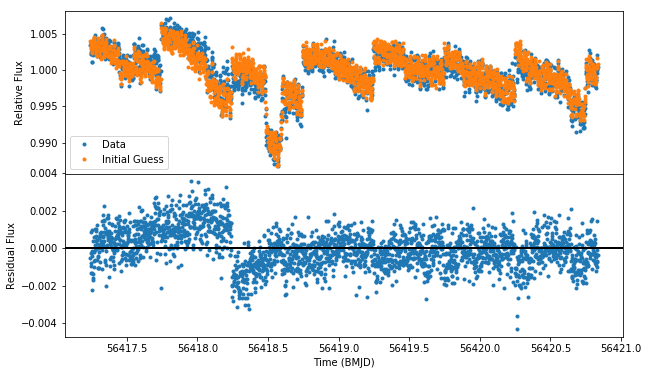

In [7]:
c1, c2, c3, c4, c5, c6 = popt
detect = models_fit.detec_poly((xdata, ydata, mid_x, mid_y), c1, c2, c3, c4, c5, c6)

fig, axes =plt.subplots(nrows=2, ncols=1, sharex=True, figsize=(10,6))
axes[0].plot(time,flux, '.', label = 'Data')
#axes[0].plot(time, resid, '.')
axes[0].plot(time, detect*astro, '.', label = 'Initial Guess')
axes[0].legend()
axes[0].set_ylabel('Relative Flux')

axes[1].plot(time, flux-detect*astro, '.')
axes[1].axhline(y=0, color='k', linewidth=2)
axes[1].set_xlabel('Time (BMJD)')
axes[1].set_ylabel('Residual Flux')

fig.subplots_adjust(hspace=0)

In [8]:
#Log likelihood function
def lnlike(p0, time, flux, xdata, ydata, mid_x, mid_y):
    # unpack p0
    t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, c1, c2, c3, c4, c5, c6, flux_err = p0
    # define model
    model = models_fit.signal_poly(time, per, t0, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, 
                   xdata, ydata, mid_x, mid_y, c1, c2, c3, c4, c5, c6)
    inv_sigma2 = 1.0/(flux_err**2)
    return -0.5*(np.sum((flux-model)**2*inv_sigma2) - len(flux)*np.log(inv_sigma2))

# Probability distribution to draw sample from
def lnprior(p0):
    t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, c1, c2, c3, c4, c5, c6, flux_err = p0
    # gaussian prior for per
    lgpri_per = -0.5*(((per - 3.1915325)/0.0000006)**2.0)
    # gaussian prior for a
    lgpri_a = -0.5*(((a - 7.07)/0.31)**2.0)
    # gaussian prior for i
    lgpri_i = -0.5*(((inc - 84.11)/0.16)**2.0)
    # gaussian prior for ecosw
    lgpri_ecosw = -0.5*(((ecosw - 0.27005)/0.00026)**2.0)
    # gaussian prior for esinw
    lgpri_esinw = -0.5*(((esinw +  0.0612)/0.0083)**2.0)
    # uniform prior for the rest
    if (56418.4 < t0 < 56418.6 and 0 < rp < 1  and 0 < fp < 1 and 
        0 < q1 < 1 and 0 < q2 < 1):
        return 0.0 + lgpri_a + lgpri_i + lgpri_ecosw + lgpri_esinw + lgpri_per
    return -np.inf

# Total probability function
def lnprob(p0, time, flux, xdata, ydata, mid_x, mid_y):
    lp = lnprior(p0)
    if not np.isfinite(lp):
        return -np.inf
    return lp + lnlike(p0, time, flux, xdata, ydata, mid_x, mid_y)

In [9]:
# Getting ready for MCMC

p0 = np.array([t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, c1, c2, c3, c4, c5, c6, sigmaf])

# total nb steps
totalsteps = 0
# instruction for sampling
ndim, nwalkers, nstep = len(p0), 500, 3000
# get scattered starting point in parameter space 
pos = [p0 + 10**(-5)*np.random.randn(ndim) for i in range(nwalkers)]

#sampler
sampler = emcee.EnsembleSampler(nwalkers, ndim, lnprob, 
                                args=(time, flux, xdata, ydata, mid_x, mid_y))

In [10]:
print('Do you want to run an mcmc or load mcmc results? (run/load)')
answer = input()

if (answer=='run'):
    print('Is this your first run? (y/n)')
    answer2 = input()
    if (answer2=='y'):
        # Running MCMC
        print("Running MCMC...")
        tic = t.clock()
        pos, lnprob, state = sampler.run_mcmc(pos, nstep)
        toc = t.clock()
        print("Done.") 
        print("time taken: ")
        print(toc - tic)
        totalsteps += nstep
    else: # continue the chain
        sampler.reset()
        print("Running MCMC...")
        tic = t.clock()
        pos, lnprob, state = sampler.run_mcmc(pos, nstep, rstate0=state)
        toc = t.clock()
        print("Done.") 
        print("time taken: ")
        print(toc - tic)
        totalsteps += nstep

Do you want to run an mcmc or load mcmc results? (run/load)
run
Is this your first run? (y/n)
y
Running MCMC...
Done.
time taken: 
9106.375016293632


In [15]:
np.median(sampler.acceptance_fraction)

0.29533333333333334

In [11]:
# Path names 
pathchain = save_poly2_v1 + 'samplerchainPoly2.npy'
pathposit = save_poly2_v1 + 'samplerposi_Poly2.npy'
pathstate = save_poly2_v1 + 'samplerstatePoly2.npy'
pathlnpro = save_poly2_v1 + 'samplerlnproPoly2.npy'

# move path
movechain = save_poly2_v1 + 'old_chain/samplerchainPoly2.npy'
moveposit = save_poly2_v1 + 'old_chain/samplerposi_Poly2.npy'
movestate = save_poly2_v1 + 'old_chain/samplerstatePoly2.npy'
movelnpro = save_poly2_v1 + 'old_chain/samplerlnproPoly2.npy'

# make old_chain directory
old_chain = save_poly2_v1 + 'old_chain'
if not os.path.exists(old_chain): os.makedirs(old_chain)

# save MCMC run data
if(answer=='run'):
    samplechain = sampler.chain[:,-2000:,:]
    if not os.path.exists(pathchain): 
        np.save(pathchain, sampler.chain[:,-2000:,:])
    else: 
        
        os.rename(pathchain, movechain)
        np.save(pathchain, sampler.chain[:,-2000:,:])
    if not os.path.exists(pathposit): 
        np.save(pathposit, pos)
    else: 
        os.rename(pathposit, moveposit)
        np.save(pathposit, pos)
    if not os.path.exists(pathstate): np.save(pathstate, state[0])
    else: 
        os.rename(pathstate, movestate)
        np.save(pathstate, state[0])
    if not os.path.exists(pathlnpro): np.save(pathlnpro, lnprob)
    else: 
        os.rename(pathlnpro, movelnpro)
        np.save(pathlnpro, lnprob)
            
elif(answer=='load'):
    samplechain = np.load(pathchain)
    pos         = np.load(pathposit)
    state       = np.load(pathstate)
    lnprob      = np.load(pathlnpro)
else:
    print('Error: Invalid answer')

In [22]:
# come back here after you see you corner plot and decide to remove outlier chain
print('Did you see you corner plot already? (y/n)')
answer3 = input()

if (answer3=='y'):
    # if you want to delete the outlier chains
    chain_med  = np.median(samplechain[:,:,0], axis=1)               # [all walkers, all steps, param0=t0]
    clip_index = np.where(np.fabs(chain_med-np.median(chain_med))>3*np.std(chain_med))
    
    # delete bad chains
    samplechain = np.delete(samplechain, clip_index, axis=0)
    pos    = np.delete(pos, clip_index, axis=0) 
    lnprob = np.delete(lnprob, clip_index)
    
    # save new chains
    np.save(pathchain, samplechain)
    np.save(pathposit, pos)
    np.save(pathlnpro, lnprob)

Did you see you corner plot already? (y/n)
y


In [23]:
# print the results
samples = samplechain.reshape((-1, ndim))

p0_name = np.array(['t0', 'per', 'rp', 'a', 'inc', 'ecosw', 'esinw', 'q1', 'q2', 'fp', 
                    'A', 'B', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'sigmaf'])

(MCMC_Results) = list(map(lambda v: (v[1], v[2]-v[1], v[1]-v[0]), zip(*np.percentile(samples, [16, 50, 84],axis=0))))

t0_mcmc, per_mcmc, rp_mcmc, a_mcmc, inc_mcmc, ecosw_mcmc, \
esinw_mcmc, q1_mcmc, q2_mcmc, fp_mcmc, A_mcmc, B_mcmc, \
c1_mcmc, c2_mcmc, c3_mcmc, c4_mcmc, c5_mcmc, c6_mcmc, sigmaf_mcmc = MCMC_Results

for i in range(len(p0)):
    line_new = '{:>8} = {:>16}  +{:>16}  -{:>16}'.format(p0_name[i],MCMC_Results[i][0], MCMC_Results[i][1], MCMC_Results[i][2])
    print(line_new)

      t0 = 56418.539457368846  +0.0004294685131753795  -0.0004164299971307628
     per = 3.1915324739568947  +6.002093524415386e-07  -5.829340774532454e-07
      rp = 0.08984979119672477  +0.0009152741534231568  -0.0008677651074359555
       a = 6.910497985802421  +0.09104816736169852  -0.08886711158115101
     inc = 84.0435716646478  +0.14947003047238638  -0.14959339388595083
   ecosw = 0.2705955942385584  +0.0002373760367749278  -0.00024408416609283945
   esinw = -0.07083372159966504  +0.008253078584954762  -0.008201758705363243
      q1 = 0.06343290787238673  +0.0642610145791764  -0.04039656682576803
      q2 = 0.4411986176324371  +0.3611912774905735  -0.3085735796208173
      fp = 0.0019937412030527424  +8.840558936389293e-05  -8.882178954085673e-05
       A = 0.27455504654903407  +0.016943361883703267  -0.0164225487621254
       B = 0.4260822645675437  +0.026301626795173005  -0.024280917831221993
      c1 = 0.9989597556516371  +9.056867811785274e-05  -8.771999256584895e-05
      c

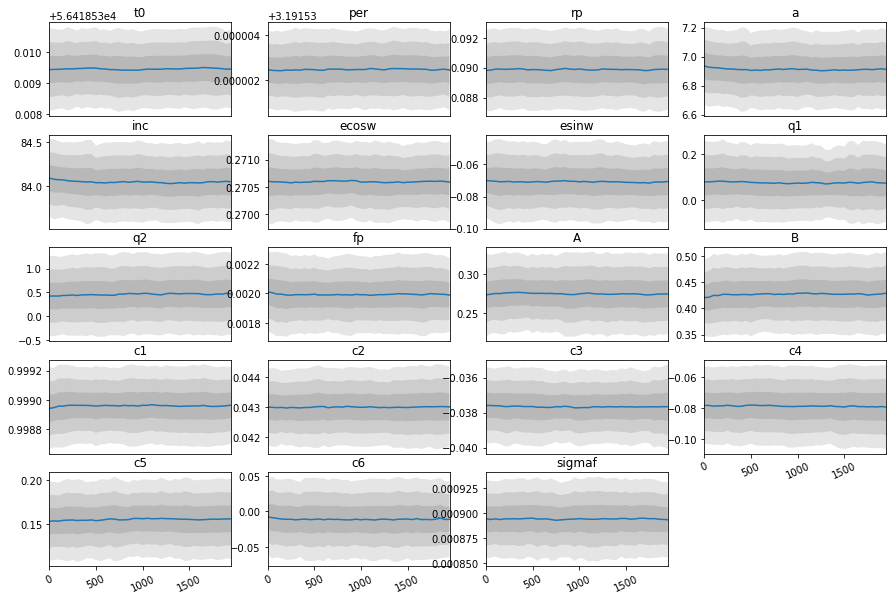

In [24]:
# see if the mcmc has converged
models_fit.walk_style(len(p0), nwalkers, samplechain, 50, 2000, p0_name)

pathplot2 = save_poly2_v1 + '02_Convergence_Criterion.pdf'
plt.savefig(pathplot2, bbox_inches='tight')

In [25]:
mcmc_detect = models_fit.detec_poly((xdata, ydata, mid_x, mid_y), c1_mcmc[0], c2_mcmc[0], 
                                     c3_mcmc[0], c4_mcmc[0], c5_mcmc[0], c6_mcmc[0])

mcmc_pcurve = models_fit.phase_curve(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], 
                                     inc_mcmc[0], ecosw_mcmc[0], esinw_mcmc[0], q1_mcmc[0], 
                                     q2_mcmc[0], fp_mcmc[0], A_mcmc[0], B_mcmc[0])

orb_phase = (time-t0_mcmc[0])/per_mcmc[0]

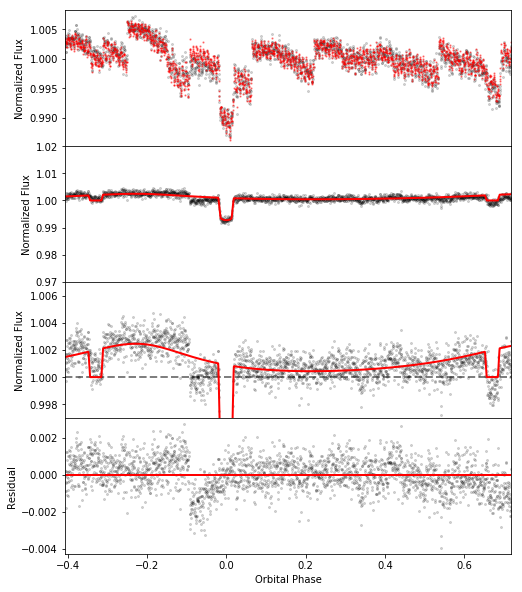

In [26]:
fig, axes = plt.subplots(ncols = 1, nrows = 4, sharex = True, figsize=(8, 10))

axes[0].set_xlim(np.min(orb_phase), np.max(orb_phase))
axes[0].plot(orb_phase, flux, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[0].plot(orb_phase, mcmc_pcurve*mcmc_detect, '.', color = 'r', markersize = 2.5, alpha = 0.4)
#axes[0].set_yticks(np.arange(0.97, 1.03, 0.01))
axes[0].set_ylabel('Normalized Flux')

axes[1].plot(orb_phase, flux/mcmc_detect, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[1].plot(orb_phase, mcmc_pcurve, color = 'r', linewidth=2)
axes[1].set_yticks(np.arange(0.97, 1.02, 0.01))
axes[1].set_ylabel('Normalized Flux')

axes[2].axhline(y=1, color='k', linewidth = 2, linestyle='dashed', alpha = 0.5)
axes[2].plot(orb_phase, flux/mcmc_detect, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[2].plot(orb_phase, mcmc_pcurve, color = 'r', linewidth=2)
axes[2].set_yticks(np.arange(0.998, 1.007, 0.002))
axes[2].set_ylabel('Normalized Flux')
axes[2].set_ylim(0.997, 1.007)

axes[3].plot(orb_phase, flux/mcmc_detect - mcmc_pcurve, 'k.', markersize = 4, alpha = 0.15)
axes[3].axhline(y=0, color='r', linewidth = 2)
axes[3].set_ylabel('Residual')
axes[3].set_xlabel('Orbital Phase')

fig.subplots_adjust(hspace=0)

pathplot3 = save_poly2_v1 + '03_Fit.pdf'
fig.savefig(pathplot3, bbox_inches='tight')

In [27]:
data     = (flux/mcmc_detect)
fit      = mcmc_pcurve
ferr_fit = np.ones(len(flux))*sigmaf_mcmc[0]

# chi-square
chi_bin  = models_fit.get_chi2(data, fit, ferr_fit)
print('chi^2:', chi_bin)
# loglikelihood
logL_bin = models_fit.get_lnlike(data, fit, ferr_fit)
print('Lnlike: ', logL_bin)
# get Bayesian Information Criterion
BIC_bin  = models_fit.get_BIC(logL_bin, ndim, len(data))
print('BIC: ', BIC_bin)

gfit_name = ['chi2-bin', 'lnlike-bin', 'BIC-bin']
gfit_bin = [chi_bin, logL_bin, BIC_bin]

chi^2: 2378.35599633
Lnlike:  15567.569488
BIC:  -30987.360916


In [28]:
# getting goodness of fit on full dataset

FULL_detect = models_fit.detec_poly((XDATA, YDATA, mid_x, mid_y), c1_mcmc[0], c2_mcmc[0], 
                                     c3_mcmc[0], c4_mcmc[0], c5_mcmc[0], c6_mcmc[0])

FULL_detect = np.ma.masked_array(FULL_detect, mask=(XDATA_clip.mask+YDATA_clip.mask))

FULL_pcurve = models_fit.phase_curve(TIME, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], 
                                     inc_mcmc[0], ecosw_mcmc[0], esinw_mcmc[0], q1_mcmc[0], 
                                     q2_mcmc[0], fp_mcmc[0], A_mcmc[0], B_mcmc[0])

FULL_data = (FLUX_clip/FULL_detect)
FULL_fit  = FULL_pcurve
FULL_ferr = np.ones(len(FLUX))*sigmaf_mcmc[0]*np.sqrt(63)

# chi-square
chi_FULL  = models_fit.get_chi2(FULL_data, FULL_fit, FULL_ferr)
print('chi^2:', chi_FULL)
# loglikelihood
logL_FULL = models_fit.get_lnlike(FULL_data, FULL_fit, FULL_ferr)
print('Lnlike: ', logL_FULL)
# get Bayesian Information Criterion
BIC_FULL  = models_fit.get_BIC(logL_FULL, ndim, len(FULL_data))
print('BIC: ', BIC_FULL)

gfit_name2 = ['chi2-full', 'lnlike-full', 'BIC-full']
gfit_full  = [chi_FULL, logL_FULL, BIC_FULL]

chi^2: 53583.3943853
Lnlike:  726006.613528
BIC:  -1451786.42226


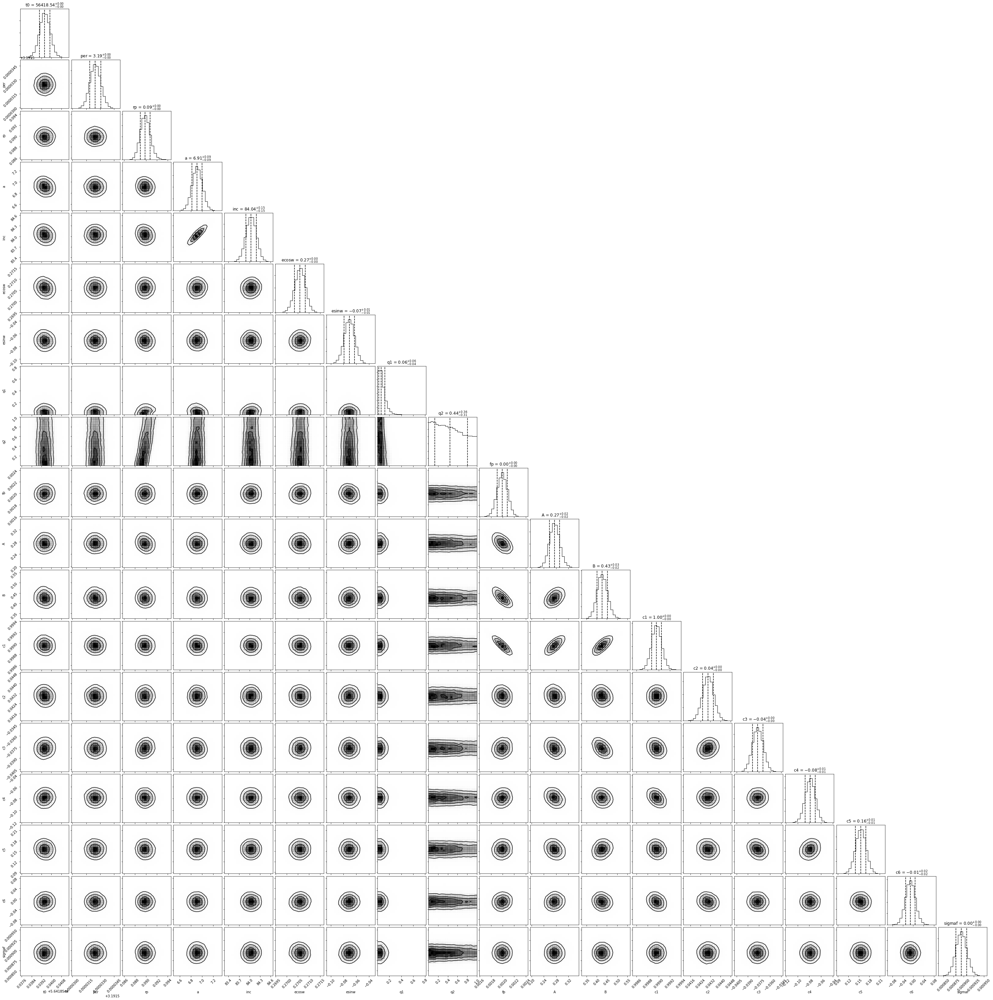

In [29]:
fig = corner.corner(samples, labels=p0_name, quantiles=[0.16, 0.5, 0.84], show_titles=True, 
                    title_kwargs={"fontsize": 12}, plot_datapoints=False)

pathplot4 = save_poly2_v1 + '04_Corner_plot.pdf'
fig.savefig(pathplot4, bbox_inches='tight')

In [30]:
# converting esinw and ecosw
e_chain = np.sqrt(samples[:,5]**2 + samples[:,6]**2)
w_chain = np.rad2deg(np.arctan(samples[:,6]/samples[:,5])) +360

# find a smart way to implement this
'''if (ecosw <= 0):
    w = np.arctan(esinw/ecosw) + np.pi                          # this is in radians!!
else:
    w = np.arctan(esinw/ecosw)'''

# getting u1 and u2 from Kipping (2013) parametrization q1 and q2 
u1_chain = 2*np.sqrt(samples[:,7]**2)*samples[:,8]
u2_chain = np.sqrt(samples[:,7]**2)*(1-2*samples[:,8])

# getting bin-delimitation
binse  = np.linspace(np.min(e_chain), np.max(e_chain), 20)
binsw  = np.linspace(np.min(w_chain), np.max(w_chain), 20)
binsu1 = np.linspace(np.min(u1_chain), np.max(u1_chain), 20)
binsu2 = np.linspace(np.min(u2_chain), np.max(u2_chain), 20)

# derived quantities
v = np.percentile(e_chain, [16, 50, 84])
e_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(w_chain, [16, 50, 84])
w_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(u1_chain, [16, 50, 84])
u1_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(u2_chain, [16, 50, 84])
u2_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

p0_name2      = ['ecc', 'w', 'u1', 'u2']
MCMC_Results2 = [e_mcmc, w_mcmc, u1_mcmc, u2_mcmc]

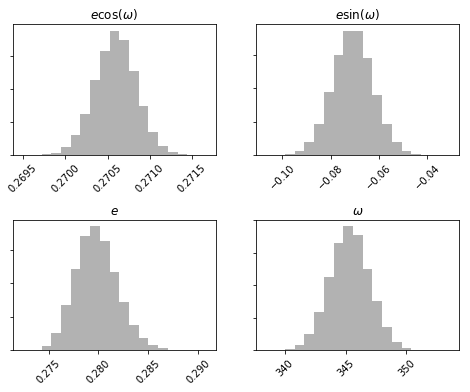

In [31]:
# Plotting Eccentricity and Longitude of Periastron 
fig, axes = plt.subplots(ncols = 2, nrows = 2, figsize = (8,6))
axes[0,0].hist(samples[:,5], bins=np.linspace(np.min(samples[:,5]), np.max(samples[:,5]), 20), color='k', alpha=0.3)
axes[0,1].hist(samples[:,6], bins=np.linspace(np.min(samples[:,6]), np.max(samples[:,6]), 20), color='k', alpha=0.3)
axes[1,0].hist(e_chain, binse, color='k', alpha=0.3)
axes[1,1].hist(w_chain, binsw, color='k', alpha=0.3)

plt.setp(axes[0,0].get_yticklabels(), visible=False)
plt.setp(axes[0,1].get_yticklabels(), visible=False)
plt.setp(axes[1,0].get_yticklabels(), visible=False)
plt.setp(axes[1,1].get_yticklabels(), visible=False)

plt.setp(axes[0,0].get_xticklabels(), rotation = 45)
plt.setp(axes[0,1].get_xticklabels(), rotation = 45)
plt.setp(axes[1,0].get_xticklabels(), rotation = 45)
plt.setp(axes[1,1].get_xticklabels(), rotation = 45)

axes[0,0].set_title('$e \cos (\omega)$', fontsize=12)
axes[0,1].set_title('$e \sin (\omega)$', fontsize=12)
axes[1,0].set_title('$e$', fontsize=12)
axes[1,1].set_title('$\omega$', fontsize=12)

fig.subplots_adjust(hspace=0.5)
fig.subplots_adjust(wspace=0.2)
pathplot5 = save_poly2_v1 + '05_Ecc_Omega.pdf'
fig.savefig(pathplot5, bbox_inches='tight')

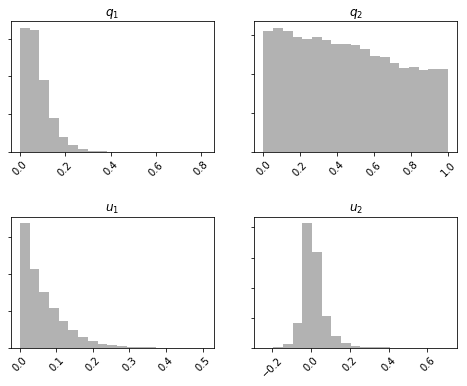

In [32]:
#Limb Darkening Coefficient

fig, axes = plt.subplots(ncols = 2, nrows = 2, figsize = (8,6))
axes[0,0].hist(samples[:,7], bins=np.linspace(np.min(samples[:,7]), np.max(samples[:,7]), 20), color='k', alpha=0.3)
axes[0,1].hist(samples[:,8], bins=np.linspace(np.min(samples[:,8]), np.max(samples[:,8]), 20), color='k', alpha=0.3)
axes[1,0].hist(u1_chain, binsu1, color='k', alpha=0.3)
axes[1,1].hist(u2_chain, binsu2, color='k', alpha=0.3)

plt.setp(axes[0,0].get_yticklabels(), visible=False)
plt.setp(axes[0,1].get_yticklabels(), visible=False)
plt.setp(axes[1,0].get_yticklabels(), visible=False)
plt.setp(axes[1,1].get_yticklabels(), visible=False)

plt.setp(axes[0,0].get_xticklabels(), rotation = 45)
plt.setp(axes[0,1].get_xticklabels(), rotation = 45)
plt.setp(axes[1,0].get_xticklabels(), rotation = 45)
plt.setp(axes[1,1].get_xticklabels(), rotation = 45)

axes[0,0].set_title('$q_1$', fontsize=12)
axes[0,1].set_title('$q_2$', fontsize=12)
axes[1,0].set_title('$u_1$', fontsize=12)
axes[1,1].set_title('$u_2$', fontsize=12)

fig.subplots_adjust(hspace=0.5)
fig.subplots_adjust(wspace=0.2)
fig.subplots_adjust(wspace=0.2)
pathplot6 = save_poly2_v1 + '06_Limb_Dark.pdf'
fig.savefig(pathplot6, bbox_inches='tight')

In [33]:
# determining in-eclipse and in-transit index

# generating transit model
trans, tsect, anomaly = models_fit.transit_model(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], 
                                                 a_mcmc[0], inc_mcmc[0], np.median(e_chain), 
                                                 np.median(np.deg2rad(w_chain)), 
                                                 np.median(u1_chain), np.median(u2_chain))
# generating secondary eclipses model
eclip = models_fit.eclipse(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], inc_mcmc[0], 
                           np.median(e_chain), np.median(np.deg2rad(w_chain)), np.median(u1_chain), np.median(u2_chain), 
                           fp_mcmc[0], tsect)

# get in-transit indices
ind_trans  = np.where(trans!=1)
# get in-eclipse indices
ind_eclip  = np.where((eclip!=(1+fp_mcmc[0])))
# seperating first and second eclipse
ind_ecli1 = ind_eclip[0][np.where(ind_eclip[0]<int(len(time)/2))]
ind_ecli2 = ind_eclip[0][np.where(ind_eclip[0]>int(len(time)/2))]

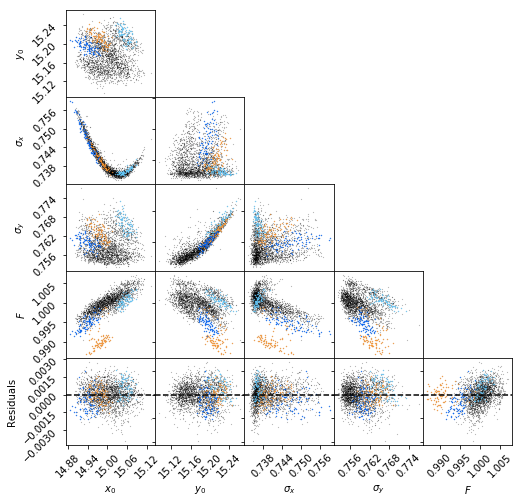

In [34]:
residual = flux/mcmc_detect - mcmc_pcurve

data1 = [xdata, ydata, psfxw, psfyw, flux, residual]
data2 = [xdata[ind_ecli1], ydata[ind_ecli1], psfxw[ind_ecli1], psfyw[ind_ecli1], flux[ind_ecli1], residual[ind_ecli1]]
data3 = [xdata[ind_trans], ydata[ind_trans], psfxw[ind_trans], psfyw[ind_trans], flux[ind_trans], residual[ind_trans]]
data4 = [xdata[ind_ecli2], ydata[ind_ecli2], psfxw[ind_ecli2], psfyw[ind_ecli2], flux[ind_ecli2], residual[ind_ecli2]]
label = ['$x_0$', '$y_0$', '$\sigma _x$', '$\sigma _y$', '$F$', 'Residuals']

models_fit.triangle_colors(data1, data2, data3, data4, label)
pathplot7 = save_poly2_v1 + '07_PSF_Diagnostics.pdf'
fig.savefig(pathplot7, bbox_inches='tight')

In [35]:
ResultMCMC_Params = Table()

for i in range(len(p0_name)):
    ResultMCMC_Params[p0_name[i]] = MCMC_Results[i]
    
for i in range(len(p0_name2)):
    ResultMCMC_Params[p0_name2[i]] = MCMC_Results2[i]
    
for i in range(len(gfit_name)):
    ResultMCMC_Params[gfit_name[i]] = gfit_bin[i]

for i in range(len(gfit_name)):
    ResultMCMC_Params[gfit_name2[i]] = gfit_full[i]
    
pathresu = save_poly2_v1 + '/mcmc_results.npy'
np.save(pathresu, ResultMCMC_Params)

# Polynomial Order 2; Phase Variation order 2

In [9]:
save_poly2_v2  = save_path + 'Poly2_v2/'            # location where outputs will be saved
if not os.path.exists(save_poly2_v2): os.makedirs(save_poly2_v2)

print('Do you want to start with mcmc output from previous fit?(y/n)')
guess = input()

if (guess=='n'):
    C    = 0.001
    D    = 0.0
    
else:
    guesspath = save_poly2_v1 + 'mcmc_results.npy'
    R = np.load(guesspath)
    t0   = R['t0'][0]
    per  = R['per'][0]
    rp   = R['rp'][0]
    a    = R['a'][0]
    inc  = R['inc'][0]             
    ecosw= R['ecosw'][0]
    esinw= R['esinw'][0]
    q1   = R['q1'][0]
    q2   = R['q2'][0]
    fp   = R['fp'][0]

    # Phase Variation Parameters (2 params)
    A    = R['A'][0]
    B    = R['B'][0]
    C    = 0.0
    D    = 0.0
    
    # Phase Variation Parameters (2 params)
    c1   = R['c1'][0]
    c2   = R['c2'][0]
    c3   = R['c3'][0]
    c4   = R['c4'][0]
    c5   = R['c5'][0]
    c6   = R['c6'][0]

    # pre-calculation
    mid_x = np.mean(xdata)
    mid_y = np.mean(ydata)

    # photometric scatter
    sigmaf = R['sigmaf'][0]

Do you want to start with mcmc output from previous fit?(y/n)
y


In [10]:
#Log likelihood function
def lnlike(p0, time, flux, xdata, ydata, mid_x, mid_y):
    # unpack p0
    t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, C, D, c1, c2, c3, c4, c5, c6, sigmaf = p0
    # define model
    model = models_fit.signal_poly(time, per, t0, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, 
                   xdata, ydata, mid_x, mid_y, c1, c2, c3, c4, c5, c6, C=C, D=D)
    inv_sigma2 = 1.0/(sigmaf**2)
    return -0.5*(np.sum((flux-model)**2*inv_sigma2) - len(flux)*np.log(inv_sigma2))

# Probability distribution to draw sample from
def lnprior(p0):
    t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, C, D, c1, c2, c3, c4, c5, c6, sigmaf = p0
    # gaussian prior for per
    lgpri_per = -0.5*(((per - 3.1915325)/0.0000006)**2.0)
    # gaussian prior for a
    lgpri_a = -0.5*(((a - 7.07)/0.31)**2.0)
    # gaussian prior for i
    lgpri_i = -0.5*(((inc - 84.11)/0.16)**2.0)
    # gaussian prior for ecosw
    lgpri_ecosw = -0.5*(((ecosw - 0.27005)/0.00026)**2.0)
    # gaussian prior for esinw
    lgpri_esinw = -0.5*(((esinw +  0.0612)/0.0083)**2.0)
    # uniform prior for the rest
    if (56418.4 < t0 < 56418.6 and 0 < rp < 1  and 0 < fp < 1 and 
        0 < q1 < 1 and 0 < q2 < 1):
        return 0.0 + lgpri_a + lgpri_i + lgpri_ecosw + lgpri_esinw + lgpri_per
    return -np.inf

# Total probability function
def lnprob(p0, time, flux, xdata, ydata, mid_x, mid_y):
    lp = lnprior(p0)
    if not np.isfinite(lp):
        return -np.inf
    return lp + lnlike(p0, time, flux, xdata, ydata, mid_x, mid_y)

In [11]:
# Getting ready for MCMC

p0 = np.array([t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, C, D, c1, c2, c3, c4, c5, c6, sigmaf])

# total nb steps
totalsteps = 0
# instruction for sampling
ndim, nwalkers, nstep = len(p0), 500, 3000
# get scattered starting point in parameter space 
pos = [p0 + 10**(-5)*np.random.randn(ndim) for i in range(nwalkers)]

#sampler
sampler = emcee.EnsembleSampler(nwalkers, ndim, lnprob, 
                                args=(time, flux, xdata, ydata, mid_x, mid_y))

In [12]:
print('Do you want to run an mcmc or load mcmc results? (run/load)')
answer = input()

if (answer=='run'):
    print('Is this your first run? (y/n)')
    answer2 = input()
    if (answer2=='y'):
        # Running MCMC
        print("Running MCMC...")
        tic = t.clock()
        pos, lnprob, state = sampler.run_mcmc(pos, nstep)
        toc = t.clock()
        print("Done.") 
        print("time taken: ")
        print(toc - tic)
        totalsteps += nstep
    else: # continue the chain
        sampler.reset()
        print("Running MCMC...")
        tic = t.clock()
        pos, lnprob, state = sampler.run_mcmc(pos, nstep, rstate0=state)
        toc = t.clock()
        print("Done.") 
        print("time taken: ")
        print(toc - tic)
        totalsteps += nstep

Do you want to run an mcmc or load mcmc results? (run/load)
run
Is this your first run? (y/n)
y
Running MCMC...
Done.
time taken: 
8008.27554764566


In [13]:
# Path names 
pathchain = save_poly2_v2 + 'samplerchainPoly2.npy'
pathposit = save_poly2_v2 + 'samplerposi_Poly2.npy'
pathstate = save_poly2_v2 + 'samplerstatePoly2.npy'
pathlnpro = save_poly2_v2 + 'samplerlnproPoly2.npy'

# move path
movechain = save_poly2_v2 + 'old_chain/samplerchainPoly2.npy'
moveposit = save_poly2_v2 + 'old_chain/samplerposi_Poly2.npy'
movestate = save_poly2_v2 + 'old_chain/samplerstatePoly2.npy'
movelnpro = save_poly2_v2 + 'old_chain/samplerlnproPoly2.npy'

# make old_chain directory
old_chain = save_poly2_v2 + 'old_chain'
if not os.path.exists(old_chain): os.makedirs(old_chain)

# save MCMC run data
if(answer=='run'):
    samplechain = sampler.chain[:,-2000:,:]
    if not os.path.exists(pathchain): 
        np.save(pathchain, sampler.chain[:,-2000:,:])
    else: 
        
        os.rename(pathchain, movechain)
        np.save(pathchain, sampler.chain[:,-2000:,:])
    if not os.path.exists(pathposit): 
        np.save(pathposit, pos)
    else: 
        os.rename(pathposit, moveposit)
        np.save(pathposit, pos)
    if not os.path.exists(pathstate): np.save(pathstate, state[0])
    else: 
        os.rename(pathstate, movestate)
        np.save(pathstate, state[0])
    if not os.path.exists(pathlnpro): np.save(pathlnpro, lnprob)
    else: 
        os.rename(pathlnpro, movelnpro)
        np.save(pathlnpro, lnprob)
            
elif(answer=='load'):
    samplechain = np.load(pathchain)
    pos         = np.load(pathposit)
    state       = np.load(pathstate)
    lnprob      = np.load(pathlnpro)
else:
    print('Error: Invalid answer')

In [ ]:
# come back here after you see you corner plot and decide to remove outlier chain
print('Did you see you corner plot already? (y/n)')
answer3 = input()

if (answer3=='y'):
    # if you want to delete the outlier chains
    chain_med  = np.median(samplechain[:,:,0], axis=1)               # [all walkers, all steps, param0=t0]
    clip_index = np.where(np.fabs(chain_med-np.median(chain_med))>3*np.std(chain_med))
    
    # delete bad chains
    samplechain = np.delete(samplechain, clip_index, axis=0)
    pos    = np.delete(pos, clip_index, axis=0) 
    lnprob = np.delete(lnprob, clip_index)
    
    # save new chains
    np.save(pathchain, samplechain)
    np.save(pathposit, pos)
    np.save(pathlnpro, lnprob)

In [14]:
# print the results
samples = samplechain.reshape((-1, ndim))

p0_name = np.array(['t0', 'per', 'rp', 'a', 'inc', 'ecosw', 'esinw', 'q1', 'q2', 'fp', 
                    'A', 'B', 'C', 'D', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'sigmaf'])

(MCMC_Results) = list(map(lambda v: (v[1], v[2]-v[1], v[1]-v[0]), zip(*np.percentile(samples, [16, 50, 84],axis=0))))

t0_mcmc, per_mcmc, rp_mcmc, a_mcmc, inc_mcmc, ecosw_mcmc, \
esinw_mcmc, q1_mcmc, q2_mcmc, fp_mcmc, A_mcmc, B_mcmc, C_mcmc, D_mcmc, \
c1_mcmc, c2_mcmc, c3_mcmc, c4_mcmc, c5_mcmc, c6_mcmc, sigmaf_mcmc = MCMC_Results

for i in range(len(p0)):
    line_new = '{:>8} = {:>16}  +{:>16}  -{:>16}'.format(p0_name[i],MCMC_Results[i][0], MCMC_Results[i][1], MCMC_Results[i][2])
    print(line_new)

      t0 = 56418.539675658925  +0.0004136856223340146  -0.00042036292870761827
     per = 3.191532488364258  +5.921929226992972e-07  -5.979283681512015e-07
      rp = 0.08771414545872122  +0.0008516048209786797  -0.0007989985238431585
       a = 6.909685334934711  +0.08591251653813536  -0.08506019461799408
     inc = 84.02195896423908  +0.15116359765917764  -0.15090169947737309
   ecosw = 0.2707306347143672  +0.00024308865380301414  -0.00024992847661076123
   esinw = -0.03215010436414935  +0.008981703171939658  -0.00887272444356127
      q1 = 0.059261562340769645  +0.06145473492162829  -0.03703208912556863
      q2 = 0.4490200446139841  +0.3608933340552101  -0.3143733997634424
      fp = 0.0018571668432858434  +8.47821874514498e-05  -8.593905208383306e-05
       A = 0.3431616076690681  +0.020563549278367177  -0.019626479310762557
       B = 0.43234190255610344  +0.02751197839470365  -0.026506115268256192
       C = -0.23851115441777188  +0.02140314685790984  -0.023275740504058784
     

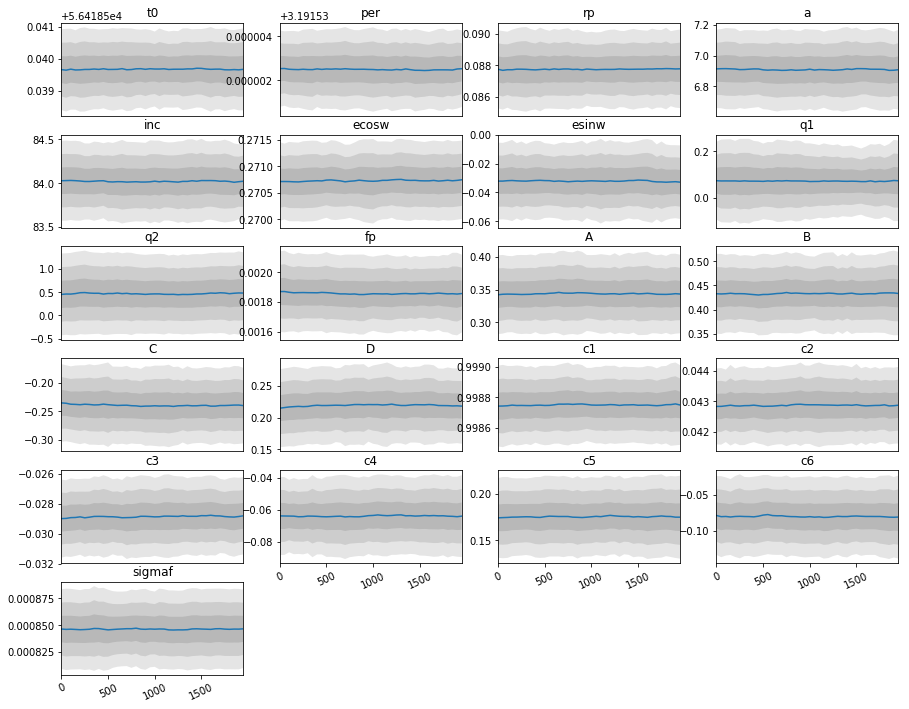

In [15]:
# see if the mcmc has converged
models_fit.walk_style(len(p0), nwalkers, samplechain, 50, 2000, p0_name)

pathplot2 = save_poly2_v2 + '02_Convergence_Criterion.pdf'
plt.savefig(pathplot2, bbox_inches='tight')

In [16]:
mcmc_detect = models_fit.detec_poly((xdata, ydata, mid_x, mid_y), c1_mcmc[0], c2_mcmc[0], 
                                     c3_mcmc[0], c4_mcmc[0], c5_mcmc[0], c6_mcmc[0])

mcmc_pcurve = models_fit.phase_curve(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], 
                                     inc_mcmc[0], ecosw_mcmc[0], esinw_mcmc[0], q1_mcmc[0], 
                                     q2_mcmc[0], fp_mcmc[0], A_mcmc[0], B_mcmc[0], C=C_mcmc[0], D=D_mcmc[0])

orb_phase = (time-t0_mcmc[0])/per_mcmc[0]

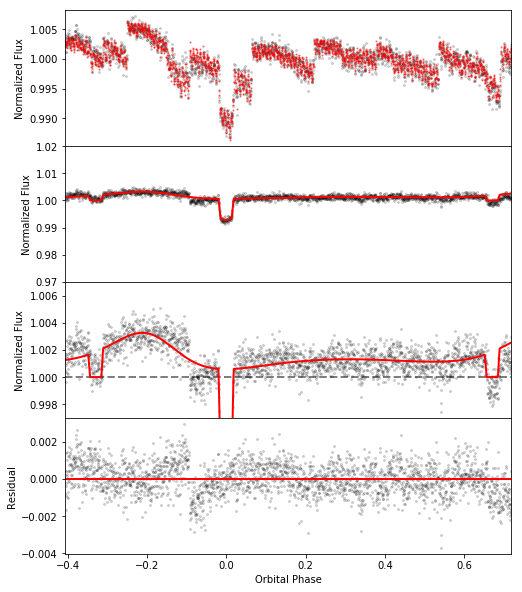

In [17]:
fig, axes = plt.subplots(ncols = 1, nrows = 4, sharex = True, figsize=(8, 10))

axes[0].set_xlim(np.min(orb_phase), np.max(orb_phase))
axes[0].plot(orb_phase, flux, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[0].plot(orb_phase, mcmc_pcurve*mcmc_detect, '.', color = 'r', markersize = 2.5, alpha = 0.4)
#axes[0].set_yticks(np.arange(0.97, 1.03, 0.01))
axes[0].set_ylabel('Normalized Flux')

axes[1].plot(orb_phase, flux/mcmc_detect, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[1].plot(orb_phase, mcmc_pcurve, color = 'r', linewidth=2)
axes[1].set_yticks(np.arange(0.97, 1.02, 0.01))
axes[1].set_ylabel('Normalized Flux')

axes[2].axhline(y=1, color='k', linewidth = 2, linestyle='dashed', alpha = 0.5)
axes[2].plot(orb_phase, flux/mcmc_detect, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[2].plot(orb_phase, mcmc_pcurve, color = 'r', linewidth=2)
axes[2].set_yticks(np.arange(0.998, 1.007, 0.002))
axes[2].set_ylabel('Normalized Flux')
axes[2].set_ylim(0.997, 1.007)

axes[3].plot(orb_phase, flux/mcmc_detect - mcmc_pcurve, 'k.', markersize = 4, alpha = 0.15)
axes[3].axhline(y=0, color='r', linewidth = 2)
axes[3].set_ylabel('Residual')
axes[3].set_xlabel('Orbital Phase')

fig.subplots_adjust(hspace=0)

pathplot3 = save_poly2_v2 + '03_Fit.pdf'
fig.savefig(pathplot3, bbox_inches='tight')

In [18]:
data     = (flux/mcmc_detect)
fit      = mcmc_pcurve
ferr_fit = np.ones(len(flux))*sigmaf_mcmc[0]

# chi-square
chi_bin  = models_fit.get_chi2(data, fit, ferr_fit)
print('chi^2:', chi_bin)
# loglikelihood
logL_bin = models_fit.get_lnlike(data, fit, ferr_fit)
print('Lnlike: ', logL_bin)
# get Bayesian Information Criterion
BIC_bin  = models_fit.get_BIC(logL_bin, ndim, len(data))
print('BIC: ', BIC_bin)

gfit_name = ['chi2-bin', 'lnlike-bin', 'BIC-bin']
gfit_bin = [chi_bin, logL_bin, BIC_bin]

chi^2: 2379.15023869
Lnlike:  15698.4793567
BIC:  -31233.6250683


In [19]:
# getting goodness of fit on full dataset

FULL_detect = models_fit.detec_poly((XDATA, YDATA, mid_x, mid_y), c1_mcmc[0], c2_mcmc[0], 
                                     c3_mcmc[0], c4_mcmc[0], c5_mcmc[0], c6_mcmc[0])

FULL_detect = np.ma.masked_array(FULL_detect, mask=(XDATA_clip.mask+YDATA_clip.mask))

FULL_pcurve = models_fit.phase_curve(TIME, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], 
                                     inc_mcmc[0], ecosw_mcmc[0], esinw_mcmc[0], q1_mcmc[0], 
                                     q2_mcmc[0], fp_mcmc[0], A_mcmc[0], B_mcmc[0], C=C_mcmc[0], D=D_mcmc[0])

FULL_data = (FLUX_clip/FULL_detect)
FULL_fit  = FULL_pcurve
FULL_ferr = np.ones(len(FLUX))*sigmaf_mcmc[0]*np.sqrt(63)

# chi-square
chi_FULL  = models_fit.get_chi2(FULL_data, FULL_fit, FULL_ferr)
print('chi^2:', chi_FULL)
# loglikelihood
logL_FULL = models_fit.get_lnlike(FULL_data, FULL_fit, FULL_ferr)
print('Lnlike: ', logL_FULL)
# get Bayesian Information Criterion
BIC_FULL  = models_fit.get_BIC(logL_FULL, ndim, len(FULL_data))
print('BIC: ', BIC_FULL)

gfit_name2 = ['chi2-full', 'lnlike-full', 'BIC-full']
gfit_full  = [chi_FULL, logL_FULL, BIC_FULL]

chi^2: 59640.9191677
Lnlike:  731359.659835
BIC:  -1462468.64068


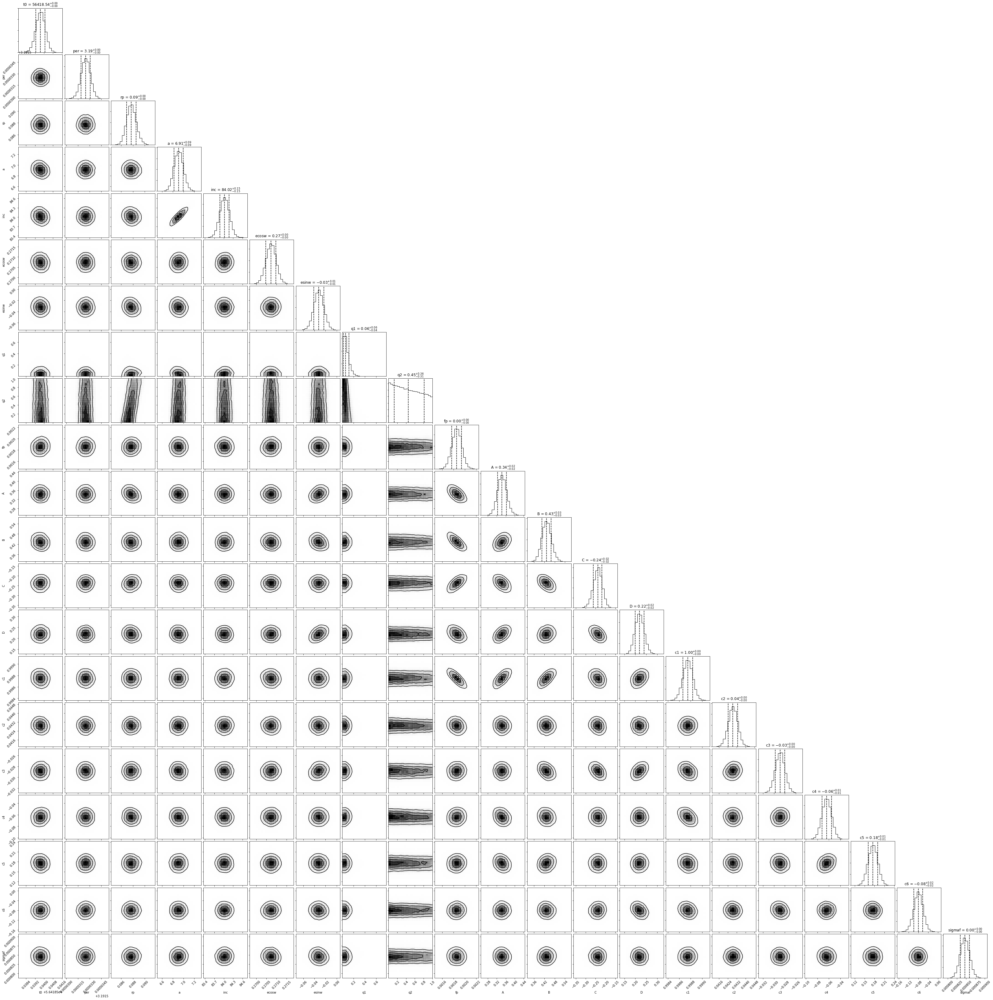

In [20]:
fig = corner.corner(samples, labels=p0_name, quantiles=[0.16, 0.5, 0.84], show_titles=True, 
                    title_kwargs={"fontsize": 12}, plot_datapoints=False)

pathplot4 = save_poly2_v2 + '04_Corner_plot.pdf'
fig.savefig(pathplot4, bbox_inches='tight')

In [21]:
# converting esinw and ecosw
e_chain = np.sqrt(samples[:,5]**2 + samples[:,6]**2)
w_chain = np.rad2deg(np.arctan(samples[:,6]/samples[:,5])) +360

# find a smart way to implement this
'''if (ecosw <= 0):
    w = np.arctan(esinw/ecosw) + np.pi                          # this is in radians!!
else:
    w = np.arctan(esinw/ecosw)'''

# getting u1 and u2 from Kipping (2013) parametrization q1 and q2 
u1_chain = 2*np.sqrt(samples[:,7]**2)*samples[:,8]
u2_chain = np.sqrt(samples[:,7]**2)*(1-2*samples[:,8])

# getting bin-delimitation
binse  = np.linspace(np.min(e_chain), np.max(e_chain), 20)
binsw  = np.linspace(np.min(w_chain), np.max(w_chain), 20)
binsu1 = np.linspace(np.min(u1_chain), np.max(u1_chain), 20)
binsu2 = np.linspace(np.min(u2_chain), np.max(u2_chain), 20)

# derived quantities
v = np.percentile(e_chain, [16, 50, 84])
e_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(w_chain, [16, 50, 84])
w_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(u1_chain, [16, 50, 84])
u1_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(u2_chain, [16, 50, 84])
u2_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

p0_name2      = ['ecc', 'w', 'u1', 'u2']
MCMC_Results2 = [e_mcmc, w_mcmc, u1_mcmc, u2_mcmc]

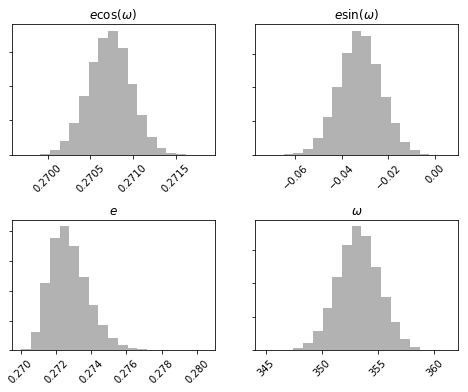

In [22]:
# Plotting Eccentricity and Longitude of Periastron 
fig, axes = plt.subplots(ncols = 2, nrows = 2, figsize = (8,6))
axes[0,0].hist(samples[:,5], bins=np.linspace(np.min(samples[:,5]), np.max(samples[:,5]), 20), color='k', alpha=0.3)
axes[0,1].hist(samples[:,6], bins=np.linspace(np.min(samples[:,6]), np.max(samples[:,6]), 20), color='k', alpha=0.3)
axes[1,0].hist(e_chain, binse, color='k', alpha=0.3)
axes[1,1].hist(w_chain, binsw, color='k', alpha=0.3)

plt.setp(axes[0,0].get_yticklabels(), visible=False)
plt.setp(axes[0,1].get_yticklabels(), visible=False)
plt.setp(axes[1,0].get_yticklabels(), visible=False)
plt.setp(axes[1,1].get_yticklabels(), visible=False)

plt.setp(axes[0,0].get_xticklabels(), rotation = 45)
plt.setp(axes[0,1].get_xticklabels(), rotation = 45)
plt.setp(axes[1,0].get_xticklabels(), rotation = 45)
plt.setp(axes[1,1].get_xticklabels(), rotation = 45)

axes[0,0].set_title('$e \cos (\omega)$', fontsize=12)
axes[0,1].set_title('$e \sin (\omega)$', fontsize=12)
axes[1,0].set_title('$e$', fontsize=12)
axes[1,1].set_title('$\omega$', fontsize=12)

fig.subplots_adjust(hspace=0.5)
fig.subplots_adjust(wspace=0.2)
pathplot5 = save_poly2_v2 + '05_Ecc_Omega.pdf'
fig.savefig(pathplot5, bbox_inches='tight')

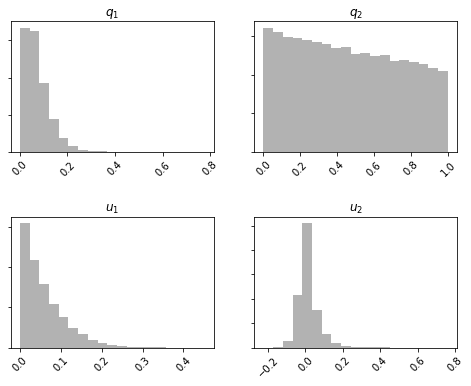

In [23]:
#Limb Darkening Coefficient

fig, axes = plt.subplots(ncols = 2, nrows = 2, figsize = (8,6))
axes[0,0].hist(samples[:,7], bins=np.linspace(np.min(samples[:,7]), np.max(samples[:,7]), 20), color='k', alpha=0.3)
axes[0,1].hist(samples[:,8], bins=np.linspace(np.min(samples[:,8]), np.max(samples[:,8]), 20), color='k', alpha=0.3)
axes[1,0].hist(u1_chain, binsu1, color='k', alpha=0.3)
axes[1,1].hist(u2_chain, binsu2, color='k', alpha=0.3)

plt.setp(axes[0,0].get_yticklabels(), visible=False)
plt.setp(axes[0,1].get_yticklabels(), visible=False)
plt.setp(axes[1,0].get_yticklabels(), visible=False)
plt.setp(axes[1,1].get_yticklabels(), visible=False)

plt.setp(axes[0,0].get_xticklabels(), rotation = 45)
plt.setp(axes[0,1].get_xticklabels(), rotation = 45)
plt.setp(axes[1,0].get_xticklabels(), rotation = 45)
plt.setp(axes[1,1].get_xticklabels(), rotation = 45)

axes[0,0].set_title('$q_1$', fontsize=12)
axes[0,1].set_title('$q_2$', fontsize=12)
axes[1,0].set_title('$u_1$', fontsize=12)
axes[1,1].set_title('$u_2$', fontsize=12)

fig.subplots_adjust(hspace=0.5)
fig.subplots_adjust(wspace=0.2)
fig.subplots_adjust(wspace=0.2)
pathplot6 = save_poly2_v2 + '06_Limb_Dark.pdf'
fig.savefig(pathplot6, bbox_inches='tight')

In [24]:
# determining in-eclipse and in-transit index

# generating transit model
trans, tsect, anomaly = models_fit.transit_model(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], 
                                                 a_mcmc[0], inc_mcmc[0], np.median(e_chain), 
                                                 np.median(np.deg2rad(w_chain)), 
                                                 np.median(u1_chain), np.median(u2_chain))
# generating secondary eclipses model
eclip = models_fit.eclipse(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], inc_mcmc[0], 
                           np.median(e_chain), np.median(np.deg2rad(w_chain)), np.median(u1_chain), np.median(u2_chain), 
                           fp_mcmc[0], tsect)

# get in-transit indices
ind_trans  = np.where(trans!=1)
# get in-eclipse indices
ind_eclip  = np.where((eclip!=(1+fp_mcmc[0])))
# seperating first and second eclipse
ind_ecli1 = ind_eclip[0][np.where(ind_eclip[0]<int(len(time)/2))]
ind_ecli2 = ind_eclip[0][np.where(ind_eclip[0]>int(len(time)/2))]

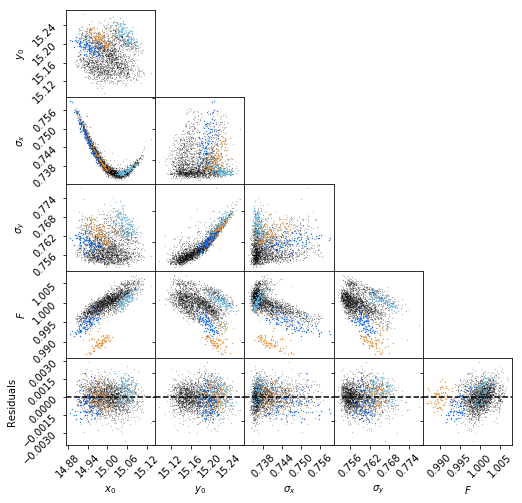

In [26]:
residual = flux/mcmc_detect - mcmc_pcurve

data1 = [xdata, ydata, psfxw, psfyw, flux, residual]
data2 = [xdata[ind_ecli1], ydata[ind_ecli1], psfxw[ind_ecli1], psfyw[ind_ecli1], flux[ind_ecli1], residual[ind_ecli1]]
data3 = [xdata[ind_trans], ydata[ind_trans], psfxw[ind_trans], psfyw[ind_trans], flux[ind_trans], residual[ind_trans]]
data4 = [xdata[ind_ecli2], ydata[ind_ecli2], psfxw[ind_ecli2], psfyw[ind_ecli2], flux[ind_ecli2], residual[ind_ecli2]]
label = ['$x_0$', '$y_0$', '$\sigma _x$', '$\sigma _y$', '$F$', 'Residuals']

#models_fit.
models_fit.triangle_colors(data1, data2, data3, data4, label)
pathplot7 = save_poly2_v2 + '07_PSF_Diagnostics.pdf'
fig.savefig(pathplot7, bbox_inches='tight')

In [27]:
ResultMCMC_Params = Table()

for i in range(len(p0_name)):
    ResultMCMC_Params[p0_name[i]] = MCMC_Results[i]
    
for i in range(len(p0_name2)):
    ResultMCMC_Params[p0_name2[i]] = MCMC_Results2[i]
    
for i in range(len(gfit_name)):
    ResultMCMC_Params[gfit_name[i]] = gfit_bin[i]

for i in range(len(gfit_name)):
    ResultMCMC_Params[gfit_name2[i]] = gfit_full[i]
    
pathresu = save_poly2_v2 + '/mcmc_results.npy'
np.save(pathresu, ResultMCMC_Params)

# Polynomial Order 3; Phase Variation order 1

In [30]:
save_poly3_v1  = save_path + 'poly3_v1/'            # location where outputs will be saved
if not os.path.exists(save_poly3_v2): os.makedirs(save_poly3_v2)

print('Do you want to start with mcmc output from previous fit?(y/n)')
guess = input()

if (guess=='n'):
    C    = 0.001
    D    = 0.0
    
else:
    guesspath = save_poly2_v1 + 'mcmc_results.npy'
    R = np.load(guesspath)
    t0   = R['t0'][0]
    per  = R['per'][0]
    rp   = R['rp'][0]
    a    = R['a'][0]
    inc  = R['inc'][0]             
    ecosw= R['ecosw'][0]
    esinw= R['esinw'][0]
    q1   = R['q1'][0]
    q2   = R['q2'][0]
    fp   = R['fp'][0]

    # Phase Variation Parameters (2 params)
    A    = R['A'][0]
    B    = R['B'][0]
    C    = 0.0
    D    = 0.0
    
    # Phase Variation Parameters (2 params)
    c1   = R['c1'][0]
    c2   = R['c2'][0]
    c3   = R['c3'][0]
    c4   = R['c4'][0]
    c5   = R['c5'][0]
    c6   = R['c6'][0]
    c7   = 0.0
    c8   = 0.0
    c9   = 0.0
    c10   = 0.0

    # pre-calculation
    mid_x = np.mean(xdata)
    mid_y = np.mean(ydata)

    # photometric scatter
    sigmaf = R['sigmaf'][0]

Do you want to start with mcmc output from previous fit?(y/n)
y


In [38]:
save_poly3_v1  = save_path + 'poly3_v1/'            # location where outputs will be saved

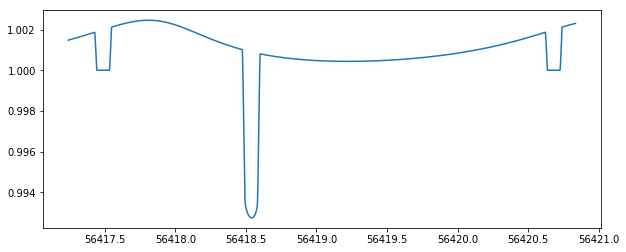

In [31]:
# calculate Initial guess for detector coefficients
astro = models_fit.phase_curve(time, t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B)
resid = flux/astro

plt.figure(figsize=(10,4))
plt.plot(time, astro)


p0 = np.array([c1, c2, c3, c4, c5, c6, c7, c8, c9, c10])

popt, pcov = scipy.optimize.curve_fit(models_fit.detec_poly, (xdata, ydata, mid_x, mid_y), resid, p0)

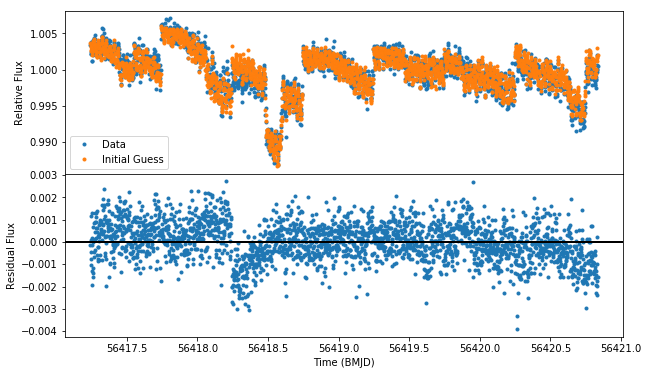

In [32]:
c1, c2, c3, c4, c5, c6, c7, c8, c9, c10 = popt
detect = models_fit.detec_poly((xdata, ydata, mid_x, mid_y), c1, c2, c3, c4, c5, c6, c7, c8, c9, c10)

fig, axes =plt.subplots(nrows=2, ncols=1, sharex=True, figsize=(10,6))
axes[0].plot(time,flux, '.', label = 'Data')
#axes[0].plot(time, resid, '.')
axes[0].plot(time, detect*astro, '.', label = 'Initial Guess')
axes[0].legend()
axes[0].set_ylabel('Relative Flux')

axes[1].plot(time, flux-detect*astro, '.')
axes[1].axhline(y=0, color='k', linewidth=2)
axes[1].set_xlabel('Time (BMJD)')
axes[1].set_ylabel('Residual Flux')

fig.subplots_adjust(hspace=0)

In [33]:
#Log likelihood function
def lnlike(p0, time, flux, xdata, ydata, mid_x, mid_y):
    # unpack p0
    t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, c1, c2, c3, c4, c5, c6, c7, c8, c9, c10, flux_err = p0
    # define model
    model = models_fit.signal_poly(time, per, t0, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, 
                   xdata, ydata, mid_x, mid_y, c1, c2, c3, c4, c5, c6, c7, c8, c9, c10)
    inv_sigma2 = 1.0/(flux_err**2)
    return -0.5*(np.sum((flux-model)**2*inv_sigma2) - len(flux)*np.log(inv_sigma2))

# Probability distribution to draw sample from
def lnprior(p0):
    t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, c1, c2, c3, c4, c5, c6, c7, c8, c9, c10, flux_err = p0
    # gaussian prior for per
    lgpri_per = -0.5*(((per - 3.1915325)/0.0000006)**2.0)
    # gaussian prior for a
    lgpri_a = -0.5*(((a - 7.07)/0.31)**2.0)
    # gaussian prior for i
    lgpri_i = -0.5*(((inc - 84.11)/0.16)**2.0)
    # gaussian prior for ecosw
    lgpri_ecosw = -0.5*(((ecosw - 0.27005)/0.00026)**2.0)
    # gaussian prior for esinw
    lgpri_esinw = -0.5*(((esinw +  0.0612)/0.0083)**2.0)
    # uniform prior for the rest
    if (56418.4 < t0 < 56418.6 and 0 < rp < 1  and 0 < fp < 1 and 
        0 < q1 < 1 and 0 < q2 < 1):
        return 0.0 + lgpri_a + lgpri_i + lgpri_ecosw + lgpri_esinw + lgpri_per
    return -np.inf

# Total probability function
def lnprob(p0, time, flux, xdata, ydata, mid_x, mid_y):
    lp = lnprior(p0)
    if not np.isfinite(lp):
        return -np.inf
    return lp + lnlike(p0, time, flux, xdata, ydata, mid_x, mid_y)

In [34]:
# Getting ready for MCMC

p0 = np.array([t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, c1, c2, c3, c4, c5, c6, c7, c8, c9, c10, sigmaf])

# total nb steps
totalsteps = 0
# instruction for sampling
ndim, nwalkers, nstep = len(p0), 500, 3000
# get scattered starting point in parameter space 
pos = [p0 + 10**(-5)*np.random.randn(ndim) for i in range(nwalkers)]

#sampler
sampler = emcee.EnsembleSampler(nwalkers, ndim, lnprob, 
                                args=(time, flux, xdata, ydata, mid_x, mid_y))

In [35]:
print('Do you want to run an mcmc or load mcmc results? (run/load)')
answer = input()

if (answer=='run'):
    print('Is this your first run? (y/n)')
    answer2 = input()
    if (answer2=='y'):
        # Running MCMC
        print("Running MCMC...")
        tic = t.clock()
        pos, lnprob, state = sampler.run_mcmc(pos, nstep)
        toc = t.clock()
        print("Done.") 
        print("time taken: ")
        print(toc - tic)
        totalsteps += nstep
    else: # continue the chain
        sampler.reset()
        print("Running MCMC...")
        tic = t.clock()
        pos, lnprob, state = sampler.run_mcmc(pos, nstep, rstate0=state)
        toc = t.clock()
        print("Done.") 
        print("time taken: ")
        print(toc - tic)
        totalsteps += nstep

Do you want to run an mcmc or load mcmc results? (run/load)
run
Is this your first run? (y/n)
y
Running MCMC...
Done.
time taken: 
10664.941172546241


In [36]:
np.median(sampler.acceptance_fraction)

0.26333333333333331

In [39]:
# Path names 
pathchain = save_poly3_v1 + 'samplerchainpoly3.npy'
pathposit = save_poly3_v1 + 'samplerposi_poly3.npy'
pathstate = save_poly3_v1 + 'samplerstatepoly3.npy'
pathlnpro = save_poly3_v1 + 'samplerlnpropoly3.npy'

# move path
movechain = save_poly3_v1 + 'old_chain/samplerchainpoly3.npy'
moveposit = save_poly3_v1 + 'old_chain/samplerposi_poly3.npy'
movestate = save_poly3_v1 + 'old_chain/samplerstatepoly3.npy'
movelnpro = save_poly3_v1 + 'old_chain/samplerlnpropoly3.npy'

# make old_chain directory
old_chain = save_poly3_v1 + 'old_chain'
if not os.path.exists(old_chain): os.makedirs(old_chain)

# save MCMC run data
if(answer=='run'):
    samplechain = sampler.chain[:,-2000:,:]
    if not os.path.exists(pathchain): 
        np.save(pathchain, sampler.chain[:,-2000:,:])
    else: 
        
        os.rename(pathchain, movechain)
        np.save(pathchain, sampler.chain[:,-2000:,:])
    if not os.path.exists(pathposit): 
        np.save(pathposit, pos)
    else: 
        os.rename(pathposit, moveposit)
        np.save(pathposit, pos)
    if not os.path.exists(pathstate): np.save(pathstate, state[0])
    else: 
        os.rename(pathstate, movestate)
        np.save(pathstate, state[0])
    if not os.path.exists(pathlnpro): np.save(pathlnpro, lnprob)
    else: 
        os.rename(pathlnpro, movelnpro)
        np.save(pathlnpro, lnprob)
            
elif(answer=='load'):
    samplechain = np.load(pathchain)
    pos         = np.load(pathposit)
    state       = np.load(pathstate)
    lnprob      = np.load(pathlnpro)
else:
    print('Error: Invalid answer')

In [40]:
# come back here after you see you corner plot and decide to remove outlier chain
print('Did you see you corner plot already? (y/n)')
answer3 = input()

if (answer3=='y'):
    # if you want to delete the outlier chains
    chain_med  = np.median(samplechain[:,:,0], axis=1)               # [all walkers, all steps, param0=t0]
    clip_index = np.where(np.fabs(chain_med-np.median(chain_med))>3*np.std(chain_med))
    
    # delete bad chains
    samplechain = np.delete(samplechain, clip_index, axis=0)
    pos    = np.delete(pos, clip_index, axis=0) 
    lnprob = np.delete(lnprob, clip_index)
    
    # save new chains
    np.save(pathchain, samplechain)
    np.save(pathposit, pos)
    np.save(pathlnpro, lnprob)

Did you see you corner plot already? (y/n)
n


In [41]:
# print the results
samples = samplechain.reshape((-1, ndim))

p0_name = np.array(['t0', 'per', 'rp', 'a', 'inc', 'ecosw', 'esinw', 'q1', 'q2', 'fp', 
                    'A', 'B', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 'c9', 'c10', 'sigmaf'])

(MCMC_Results) = list(map(lambda v: (v[1], v[2]-v[1], v[1]-v[0]), zip(*np.percentile(samples, [16, 50, 84],axis=0))))

t0_mcmc, per_mcmc, rp_mcmc, a_mcmc, inc_mcmc, ecosw_mcmc, \
esinw_mcmc, q1_mcmc, q2_mcmc, fp_mcmc, A_mcmc, B_mcmc, \
c1_mcmc, c2_mcmc, c3_mcmc, c4_mcmc, c5_mcmc, c6_mcmc, c7_mcmc, c8_mcmc, c9_mcmc, c10_mcmc, sigmaf_mcmc = MCMC_Results

for i in range(len(p0)):
    line_new = '{:>8} = {:>16}  +{:>16}  -{:>16}'.format(p0_name[i],MCMC_Results[i][0], MCMC_Results[i][1], MCMC_Results[i][2])
    print(line_new)

      t0 = 56418.53967868907  +0.0004304258109186776  -0.0004221352210151963
     per = 3.191532500059394  +6.03177984448422e-07  -5.949958952200518e-07
      rp = 0.08916455808018768  +0.0009475252420018537  -0.0008787614848417558
       a = 6.891652933636562  +0.08812522883966167  -0.08918011936152048
     inc = 84.0294012487948  +0.1484142099343444  -0.1507328576256981
   ecosw = 0.27062061521991787  +0.00024184833485907387  -0.00024546098286948315
   esinw = -0.0702862688238742  +0.008117515100178163  -0.008086633731758164
      q1 = 0.07272935290633765  +0.07506971538180164  -0.04486211800924571
      q2 = 0.4342851918576224  +0.3675078948250964  -0.30822275852583725
      fp = 0.0020706747900355164  +8.847470583719236e-05  -9.038003236269123e-05
       A = 0.2725040275259689  +0.016951549211734973  -0.016321961565480714
       B = 0.43626260369257835  +0.025842287911057082  -0.023227299633245824
      c1 = 0.9989188714066598  +9.015888200836208e-05  -8.82385142018105e-05
      c2

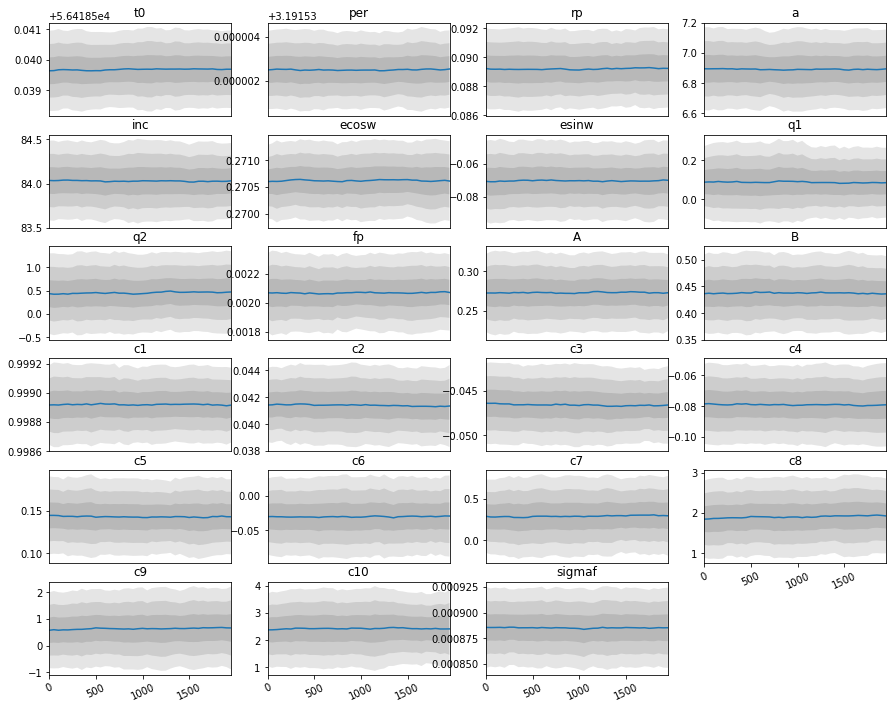

In [42]:
# see if the mcmc has converged
models_fit.walk_style(len(p0), nwalkers, samplechain, 50, 2000, p0_name)

pathplot2 = save_poly3_v1 + '02_Convergence_Criterion.pdf'
plt.savefig(pathplot2, bbox_inches='tight')

In [43]:
mcmc_detect = models_fit.detec_poly((xdata, ydata, mid_x, mid_y), c1_mcmc[0], c2_mcmc[0], 
                                     c3_mcmc[0], c4_mcmc[0], c5_mcmc[0], c6_mcmc[0], c7_mcmc[0], 
                                    c8_mcmc[0], c9_mcmc[0], c10_mcmc[0])

mcmc_pcurve = models_fit.phase_curve(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], 
                                     inc_mcmc[0], ecosw_mcmc[0], esinw_mcmc[0], q1_mcmc[0], 
                                     q2_mcmc[0], fp_mcmc[0], A_mcmc[0], B_mcmc[0])

orb_phase = (time-t0_mcmc[0])/per_mcmc[0]

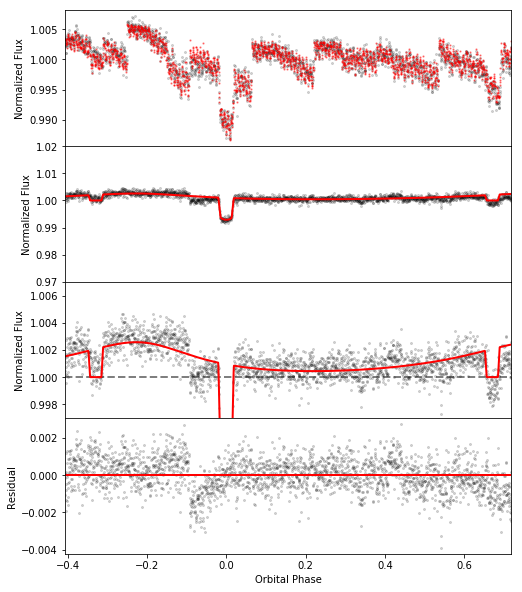

In [44]:
fig, axes = plt.subplots(ncols = 1, nrows = 4, sharex = True, figsize=(8, 10))

axes[0].set_xlim(np.min(orb_phase), np.max(orb_phase))
axes[0].plot(orb_phase, flux, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[0].plot(orb_phase, mcmc_pcurve*mcmc_detect, '.', color = 'r', markersize = 2.5, alpha = 0.4)
#axes[0].set_yticks(np.arange(0.97, 1.03, 0.01))
axes[0].set_ylabel('Normalized Flux')

axes[1].plot(orb_phase, flux/mcmc_detect, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[1].plot(orb_phase, mcmc_pcurve, color = 'r', linewidth=2)
axes[1].set_yticks(np.arange(0.97, 1.02, 0.01))
axes[1].set_ylabel('Normalized Flux')

axes[2].axhline(y=1, color='k', linewidth = 2, linestyle='dashed', alpha = 0.5)
axes[2].plot(orb_phase, flux/mcmc_detect, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[2].plot(orb_phase, mcmc_pcurve, color = 'r', linewidth=2)
axes[2].set_yticks(np.arange(0.998, 1.007, 0.002))
axes[2].set_ylabel('Normalized Flux')
axes[2].set_ylim(0.997, 1.007)

axes[3].plot(orb_phase, flux/mcmc_detect - mcmc_pcurve, 'k.', markersize = 4, alpha = 0.15)
axes[3].axhline(y=0, color='r', linewidth = 2)
axes[3].set_ylabel('Residual')
axes[3].set_xlabel('Orbital Phase')

fig.subplots_adjust(hspace=0)

pathplot3 = save_poly3_v1 + '03_Fit.pdf'
fig.savefig(pathplot3, bbox_inches='tight')

In [45]:
data     = (flux/mcmc_detect)
fit      = mcmc_pcurve
ferr_fit = np.ones(len(flux))*sigmaf_mcmc[0]

# chi-square
chi_bin  = models_fit.get_chi2(data, fit, ferr_fit)
print('chi^2:', chi_bin)
# loglikelihood
logL_bin = models_fit.get_lnlike(data, fit, ferr_fit)
print('Lnlike: ', logL_bin)
# get Bayesian Information Criterion
BIC_bin  = models_fit.get_BIC(logL_bin, ndim, len(data))
print('BIC: ', BIC_bin)

gfit_name = ['chi2-bin', 'lnlike-bin', 'BIC-bin']
gfit_bin = [chi_bin, logL_bin, BIC_bin]

chi^2: 2373.51220669
Lnlike:  15593.7061097
BIC:  -31008.5229891


In [46]:
# getting goodness of fit on full dataset

FULL_detect = models_fit.detec_poly((XDATA, YDATA, mid_x, mid_y), c1_mcmc[0], c2_mcmc[0], 
                                     c3_mcmc[0], c4_mcmc[0], c5_mcmc[0], c6_mcmc[0], c7_mcmc[0], c8_mcmc[0], c9_mcmc[0], c10_mcmc[0])

FULL_detect = np.ma.masked_array(FULL_detect, mask=(XDATA_clip.mask+YDATA_clip.mask))

FULL_pcurve = models_fit.phase_curve(TIME, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], 
                                     inc_mcmc[0], ecosw_mcmc[0], esinw_mcmc[0], q1_mcmc[0], 
                                     q2_mcmc[0], fp_mcmc[0], A_mcmc[0], B_mcmc[0])

FULL_data = (FLUX_clip/FULL_detect)
FULL_fit  = FULL_pcurve
FULL_ferr = np.ones(len(FLUX))*sigmaf_mcmc[0]*np.sqrt(63)

# chi-square
chi_FULL  = models_fit.get_chi2(FULL_data, FULL_fit, FULL_ferr)
print('chi^2:', chi_FULL)
# loglikelihood
logL_FULL = models_fit.get_lnlike(FULL_data, FULL_fit, FULL_ferr)
print('Lnlike: ', logL_FULL)
# get Bayesian Information Criterion
BIC_FULL  = models_fit.get_BIC(logL_FULL, ndim, len(FULL_data))
print('BIC: ', BIC_FULL)

gfit_name2 = ['chi2-full', 'lnlike-full', 'BIC-full']
gfit_full  = [chi_FULL, logL_FULL, BIC_FULL]

chi^2: 54735.1219795
Lnlike:  726944.54808
BIC:  -1453614.54299


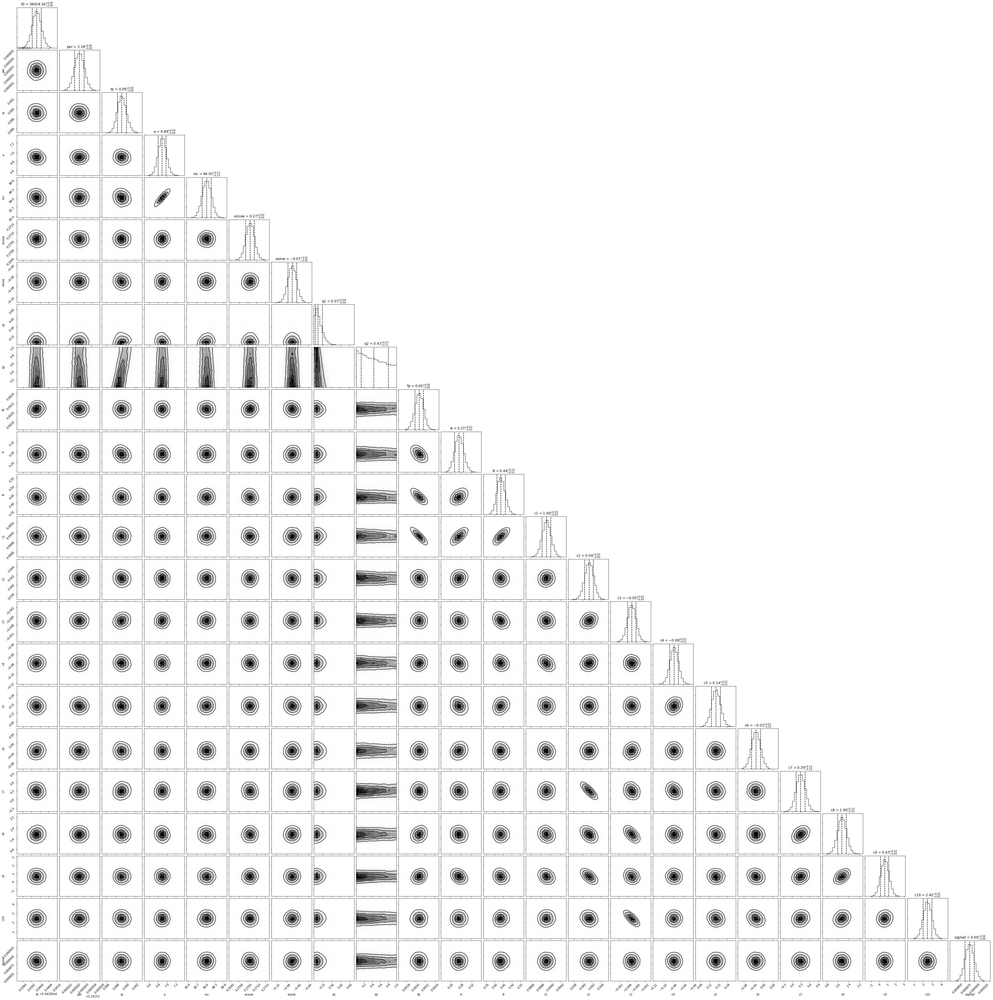

In [47]:
fig = corner.corner(samples, labels=p0_name, quantiles=[0.16, 0.5, 0.84], show_titles=True, 
                    title_kwargs={"fontsize": 12}, plot_datapoints=False)

pathplot4 = save_poly3_v1 + '04_Corner_plot.pdf'
fig.savefig(pathplot4, bbox_inches='tight')

In [48]:
# converting esinw and ecosw
e_chain = np.sqrt(samples[:,5]**2 + samples[:,6]**2)
w_chain = np.rad2deg(np.arctan(samples[:,6]/samples[:,5])) +360

# find a smart way to implement this
'''if (ecosw <= 0):
    w = np.arctan(esinw/ecosw) + np.pi                          # this is in radians!!
else:
    w = np.arctan(esinw/ecosw)'''

# getting u1 and u2 from Kipping (2013) parametrization q1 and q2 
u1_chain = 2*np.sqrt(samples[:,7]**2)*samples[:,8]
u2_chain = np.sqrt(samples[:,7]**2)*(1-2*samples[:,8])

# getting bin-delimitation
binse  = np.linspace(np.min(e_chain), np.max(e_chain), 20)
binsw  = np.linspace(np.min(w_chain), np.max(w_chain), 20)
binsu1 = np.linspace(np.min(u1_chain), np.max(u1_chain), 20)
binsu2 = np.linspace(np.min(u2_chain), np.max(u2_chain), 20)

# derived quantities
v = np.percentile(e_chain, [16, 50, 84])
e_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(w_chain, [16, 50, 84])
w_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(u1_chain, [16, 50, 84])
u1_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(u2_chain, [16, 50, 84])
u2_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

p0_name2      = ['ecc', 'w', 'u1', 'u2']
MCMC_Results2 = [e_mcmc, w_mcmc, u1_mcmc, u2_mcmc]

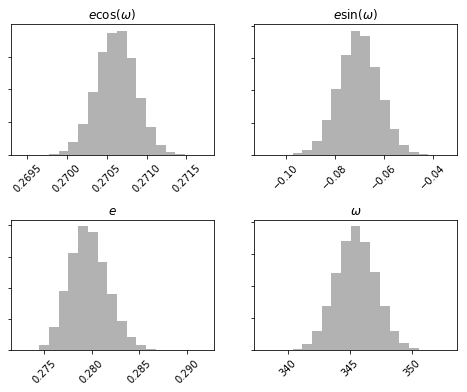

In [49]:
# Plotting Eccentricity and Longitude of Periastron 
fig, axes = plt.subplots(ncols = 2, nrows = 2, figsize = (8,6))
axes[0,0].hist(samples[:,5], bins=np.linspace(np.min(samples[:,5]), np.max(samples[:,5]), 20), color='k', alpha=0.3)
axes[0,1].hist(samples[:,6], bins=np.linspace(np.min(samples[:,6]), np.max(samples[:,6]), 20), color='k', alpha=0.3)
axes[1,0].hist(e_chain, binse, color='k', alpha=0.3)
axes[1,1].hist(w_chain, binsw, color='k', alpha=0.3)

plt.setp(axes[0,0].get_yticklabels(), visible=False)
plt.setp(axes[0,1].get_yticklabels(), visible=False)
plt.setp(axes[1,0].get_yticklabels(), visible=False)
plt.setp(axes[1,1].get_yticklabels(), visible=False)

plt.setp(axes[0,0].get_xticklabels(), rotation = 45)
plt.setp(axes[0,1].get_xticklabels(), rotation = 45)
plt.setp(axes[1,0].get_xticklabels(), rotation = 45)
plt.setp(axes[1,1].get_xticklabels(), rotation = 45)

axes[0,0].set_title('$e \cos (\omega)$', fontsize=12)
axes[0,1].set_title('$e \sin (\omega)$', fontsize=12)
axes[1,0].set_title('$e$', fontsize=12)
axes[1,1].set_title('$\omega$', fontsize=12)

fig.subplots_adjust(hspace=0.5)
fig.subplots_adjust(wspace=0.2)
pathplot5 = save_poly3_v1 + '05_Ecc_Omega.pdf'
fig.savefig(pathplot5, bbox_inches='tight')

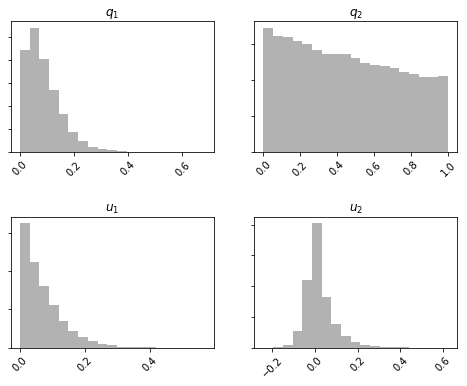

In [50]:
#Limb Darkening Coefficient

fig, axes = plt.subplots(ncols = 2, nrows = 2, figsize = (8,6))
axes[0,0].hist(samples[:,7], bins=np.linspace(np.min(samples[:,7]), np.max(samples[:,7]), 20), color='k', alpha=0.3)
axes[0,1].hist(samples[:,8], bins=np.linspace(np.min(samples[:,8]), np.max(samples[:,8]), 20), color='k', alpha=0.3)
axes[1,0].hist(u1_chain, binsu1, color='k', alpha=0.3)
axes[1,1].hist(u2_chain, binsu2, color='k', alpha=0.3)

plt.setp(axes[0,0].get_yticklabels(), visible=False)
plt.setp(axes[0,1].get_yticklabels(), visible=False)
plt.setp(axes[1,0].get_yticklabels(), visible=False)
plt.setp(axes[1,1].get_yticklabels(), visible=False)

plt.setp(axes[0,0].get_xticklabels(), rotation = 45)
plt.setp(axes[0,1].get_xticklabels(), rotation = 45)
plt.setp(axes[1,0].get_xticklabels(), rotation = 45)
plt.setp(axes[1,1].get_xticklabels(), rotation = 45)

axes[0,0].set_title('$q_1$', fontsize=12)
axes[0,1].set_title('$q_2$', fontsize=12)
axes[1,0].set_title('$u_1$', fontsize=12)
axes[1,1].set_title('$u_2$', fontsize=12)

fig.subplots_adjust(hspace=0.5)
fig.subplots_adjust(wspace=0.2)
fig.subplots_adjust(wspace=0.2)
pathplot6 = save_poly3_v1 + '06_Limb_Dark.pdf'
fig.savefig(pathplot6, bbox_inches='tight')

In [51]:
# determining in-eclipse and in-transit index

# generating transit model
trans, tsect, anomaly = models_fit.transit_model(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], 
                                                 a_mcmc[0], inc_mcmc[0], np.median(e_chain), 
                                                 np.median(np.deg2rad(w_chain)), 
                                                 np.median(u1_chain), np.median(u2_chain))
# generating secondary eclipses model
eclip = models_fit.eclipse(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], inc_mcmc[0], 
                           np.median(e_chain), np.median(np.deg2rad(w_chain)), np.median(u1_chain), np.median(u2_chain), 
                           fp_mcmc[0], tsect)

# get in-transit indices
ind_trans  = np.where(trans!=1)
# get in-eclipse indices
ind_eclip  = np.where((eclip!=(1+fp_mcmc[0])))
# seperating first and second eclipse
ind_ecli1 = ind_eclip[0][np.where(ind_eclip[0]<int(len(time)/2))]
ind_ecli2 = ind_eclip[0][np.where(ind_eclip[0]>int(len(time)/2))]

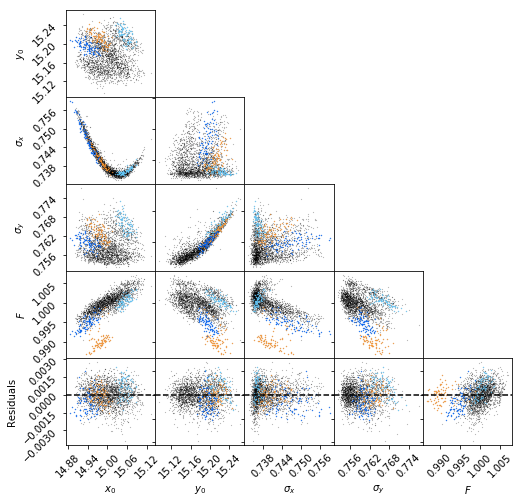

In [52]:
residual = flux/mcmc_detect - mcmc_pcurve

data1 = [xdata, ydata, psfxw, psfyw, flux, residual]
data2 = [xdata[ind_ecli1], ydata[ind_ecli1], psfxw[ind_ecli1], psfyw[ind_ecli1], flux[ind_ecli1], residual[ind_ecli1]]
data3 = [xdata[ind_trans], ydata[ind_trans], psfxw[ind_trans], psfyw[ind_trans], flux[ind_trans], residual[ind_trans]]
data4 = [xdata[ind_ecli2], ydata[ind_ecli2], psfxw[ind_ecli2], psfyw[ind_ecli2], flux[ind_ecli2], residual[ind_ecli2]]
label = ['$x_0$', '$y_0$', '$\sigma _x$', '$\sigma _y$', '$F$', 'Residuals']

models_fit.triangle_colors(data1, data2, data3, data4, label)
pathplot7 = save_poly3_v1 + '07_PSF_Diagnostics.pdf'
fig.savefig(pathplot7, bbox_inches='tight')

In [53]:
ResultMCMC_Params = Table()

for i in range(len(p0_name)):
    ResultMCMC_Params[p0_name[i]] = MCMC_Results[i]
    
for i in range(len(p0_name2)):
    ResultMCMC_Params[p0_name2[i]] = MCMC_Results2[i]
    
for i in range(len(gfit_name)):
    ResultMCMC_Params[gfit_name[i]] = gfit_bin[i]

for i in range(len(gfit_name)):
    ResultMCMC_Params[gfit_name2[i]] = gfit_full[i]
    
pathresu = save_poly3_v1 + '/mcmc_results.npy'
np.save(pathresu, ResultMCMC_Params)

In [54]:
plt.close('all')
sampler.reset()

# Polynomial Order 3; Phase Variation Order 1

In [55]:
save_poly3_v2  = save_path + 'poly3_v2/'            # location where outputs will be saved
if not os.path.exists(save_poly3_v2): os.makedirs(save_poly3_v2)

print('Do you want to start with mcmc output from previous fit?(y/n)')
guess = input()

if (guess=='n'):
    C    = 0.001
    D    = 0.0
    
else:
    guesspath = save_poly3_v1 + 'mcmc_results.npy'
    R = np.load(guesspath)
    t0   = R['t0'][0]
    per  = R['per'][0]
    rp   = R['rp'][0]
    a    = R['a'][0]
    inc  = R['inc'][0]             
    ecosw= R['ecosw'][0]
    esinw= R['esinw'][0]
    q1   = R['q1'][0]
    q2   = R['q2'][0]
    fp   = R['fp'][0]

    # Phase Variation Parameters (2 params)
    A    = R['A'][0]
    B    = R['B'][0]
    C    = 0.0
    D    = 0.0
    
    # Phase Variation Parameters (2 params)
    c1   = R['c1'][0]
    c2   = R['c2'][0]
    c3   = R['c3'][0]
    c4   = R['c4'][0]
    c5   = R['c5'][0]
    c6   = R['c6'][0]
    c7   = R['c7'][0]
    c8   = R['c8'][0]
    c9   = R['c9'][0]
    c10   = R['c10'][0]

    # pre-calculation
    mid_x = np.mean(xdata)
    mid_y = np.mean(ydata)

    # photometric scatter
    sigmaf = R['sigmaf'][0]

Do you want to start with mcmc output from previous fit?(y/n)



In [56]:
#Log likelihood function
def lnlike(p0, time, flux, xdata, ydata, mid_x, mid_y):
    # unpack p0
    t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, C, D, c1, c2, c3, c4, c5, c6, c7, c8, c9, c10, sigmaf = p0
    # define model
    model = models_fit.signal_poly(time, per, t0, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, 
                   xdata, ydata, mid_x, mid_y, c1, c2, c3, c4, c5, c6, c7, c8, c9, c10, C=C, D=D)
    inv_sigma2 = 1.0/(sigmaf**2)
    return -0.5*(np.sum((flux-model)**2*inv_sigma2) - len(flux)*np.log(inv_sigma2))

# Probability distribution to draw sample from
def lnprior(p0):
    t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, C, D, c1, c2, c3, c4, c5, c6, c7, c8, c9, c10, sigmaf = p0
    # gaussian prior for per
    lgpri_per = -0.5*(((per - 3.1915325)/0.0000006)**2.0)
    # gaussian prior for a
    lgpri_a = -0.5*(((a - 7.07)/0.31)**2.0)
    # gaussian prior for i
    lgpri_i = -0.5*(((inc - 84.11)/0.16)**2.0)
    # gaussian prior for ecosw
    lgpri_ecosw = -0.5*(((ecosw - 0.27005)/0.00026)**2.0)
    # gaussian prior for esinw
    lgpri_esinw = -0.5*(((esinw +  0.0612)/0.0083)**2.0)
    # uniform prior for the rest
    if (56418.4 < t0 < 56418.6 and 0 < rp < 1  and 0 < fp < 1 and 
        0 < q1 < 1 and 0 < q2 < 1):
        return 0.0 + lgpri_a + lgpri_i + lgpri_ecosw + lgpri_esinw + lgpri_per
    return -np.inf

# Total probability function
def lnprob(p0, time, flux, xdata, ydata, mid_x, mid_y):
    lp = lnprior(p0)
    if not np.isfinite(lp):
        return -np.inf
    return lp + lnlike(p0, time, flux, xdata, ydata, mid_x, mid_y)

In [57]:
# Getting ready for MCMC

p0 = np.array([t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, C, D, c1, c2, c3, c4, c5, c6, c7, c8, c9, c10, sigmaf])

# total nb steps
totalsteps = 0
# instruction for sampling
ndim, nwalkers, nstep = len(p0), 500, 3000
# get scattered starting point in parameter space 
pos = [p0 + 10**(-5)*np.random.randn(ndim) for i in range(nwalkers)]

#sampler
sampler = emcee.EnsembleSampler(nwalkers, ndim, lnprob, 
                                args=(time, flux, xdata, ydata, mid_x, mid_y))

In [74]:
print('Do you want to run an mcmc or load mcmc results? (run/load)')
answer = input()

if (answer=='run'):
    print('Is this your first run? (y/n)')
    answer2 = input()
    if (answer2=='y'):
        # Running MCMC
        print("Running MCMC...")
        tic = t.clock()
        pos, lnprob, state = sampler.run_mcmc(pos, nstep)
        toc = t.clock()
        print("Done.") 
        print("time taken: ")
        print(toc - tic)
        totalsteps += nstep
    else: # continue the chain
        sampler.reset()
        print("Running MCMC...")
        tic = t.clock()
        pos, lnprob, state = sampler.run_mcmc(pos, nstep, rstate0=state)
        toc = t.clock()
        print("Done.") 
        print("time taken: ")
        print(toc - tic)
        totalsteps += nstep

Do you want to run an mcmc or load mcmc results? (run/load)
run
Is this your first run? (y/n)
n
Running MCMC...
Done.
time taken: 
8080.148890442128


In [75]:
# Path names 
pathchain = save_poly3_v2 + 'samplerchainpoly3.npy'
pathposit = save_poly3_v2 + 'samplerposi_poly3.npy'
pathstate = save_poly3_v2 + 'samplerstatepoly3.npy'
pathlnpro = save_poly3_v2 + 'samplerlnpropoly3.npy'

# move path
movechain = save_poly3_v2 + 'old_chain/samplerchainpoly3.npy'
moveposit = save_poly3_v2 + 'old_chain/samplerposi_poly3.npy'
movestate = save_poly3_v2 + 'old_chain/samplerstatepoly3.npy'
movelnpro = save_poly3_v2 + 'old_chain/samplerlnpropoly3.npy'

# make old_chain directory
old_chain = save_poly3_v2 + 'old_chain'
if not os.path.exists(old_chain): os.makedirs(old_chain)

# save MCMC run data
if(answer=='run'):
    samplechain = sampler.chain[:,-2000:,:]
    if not os.path.exists(pathchain): 
        np.save(pathchain, sampler.chain[:,-2000:,:])
    else: 
        
        os.rename(pathchain, movechain)
        np.save(pathchain, sampler.chain[:,-2000:,:])
    if not os.path.exists(pathposit): 
        np.save(pathposit, pos)
    else: 
        os.rename(pathposit, moveposit)
        np.save(pathposit, pos)
    if not os.path.exists(pathstate): np.save(pathstate, state[0])
    else: 
        os.rename(pathstate, movestate)
        np.save(pathstate, state[0])
    if not os.path.exists(pathlnpro): np.save(pathlnpro, lnprob)
    else: 
        os.rename(pathlnpro, movelnpro)
        np.save(pathlnpro, lnprob)
            
elif(answer=='load'):
    samplechain = np.load(pathchain)
    pos         = np.load(pathposit)
    state       = np.load(pathstate)
    lnprob      = np.load(pathlnpro)
else:
    print('Error: Invalid answer')

In [76]:
# come back here after you see you corner plot and decide to remove outlier chain
print('Did you see you corner plot already? (y/n)')
answer3 = input()

if (answer3=='y'):
    # if you want to delete the outlier chains
    chain_med  = np.median(samplechain[:,:,0], axis=1)               # [all walkers, all steps, param0=t0]
    clip_index = np.where(np.fabs(chain_med-np.median(chain_med))>3*np.std(chain_med))
    
    # delete bad chains
    samplechain = np.delete(samplechain, clip_index, axis=0)
    pos    = np.delete(pos, clip_index, axis=0) 
    lnprob = np.delete(lnprob, clip_index)
    
    # save new chains
    np.save(pathchain, samplechain)
    np.save(pathposit, pos)
    np.save(pathlnpro, lnprob)

Did you see you corner plot already? (y/n)
n


In [77]:
# print the results
samples = samplechain.reshape((-1, ndim))

p0_name = np.array(['t0', 'per', 'rp', 'a', 'inc', 'ecosw', 'esinw', 'q1', 'q2', 'fp', 
                    'A', 'B', 'C', 'D', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 'c9', 'c10', 'sigmaf'])

(MCMC_Results) = list(map(lambda v: (v[1], v[2]-v[1], v[1]-v[0]), zip(*np.percentile(samples, [16, 50, 84],axis=0))))

t0_mcmc, per_mcmc, rp_mcmc, a_mcmc, inc_mcmc, ecosw_mcmc, \
esinw_mcmc, q1_mcmc, q2_mcmc, fp_mcmc, A_mcmc, B_mcmc, C_mcmc, D_mcmc, \
c1_mcmc, c2_mcmc, c3_mcmc, c4_mcmc, c5_mcmc, c6_mcmc, c7_mcmc, c8_mcmc, c9_mcmc, c10_mcmc, sigmaf_mcmc = MCMC_Results

for i in range(len(p0)):
    line_new = '{:>8} = {:>16}  +{:>16}  -{:>16}'.format(p0_name[i],MCMC_Results[i][0], MCMC_Results[i][1], MCMC_Results[i][2])
    print(line_new)

      t0 = 56418.53991984883  +0.00043015057599404827  -0.0004098007921129465
     per = 3.191532496477724  +5.855735856208355e-07  -6.108432013540721e-07
      rp = 0.08734607315792443  +0.0008806570863263696  -0.000837749313733413
       a = 6.891480250903265  +0.08738529380362525  -0.08668573891795628
     inc = 84.00189482358192  +0.1480616566542352  -0.15017116102013972
   ecosw = 0.270740733527921  +0.000243327744497146  -0.0002476358092566855
   esinw = -0.03903425014005287  +0.00903215801581262  -0.009158328289026324
      q1 = 0.07190016040103381  +0.06989261837626126  -0.04244194744468096
      q2 = 0.42923842374449117  +0.3677321209346277  -0.3013508269049794
      fp = 0.00197661446893426  +8.853479275341535e-05  -8.818761656463462e-05
       A = 0.33109235350136274  +0.020317246267444355  -0.01862215062448125
       B = 0.4326198112632873  +0.026574097993411594  -0.024938230159017416
       C = -0.23781974012886292  +0.02098446204405413  -0.02199761733997113
       D = 0.2

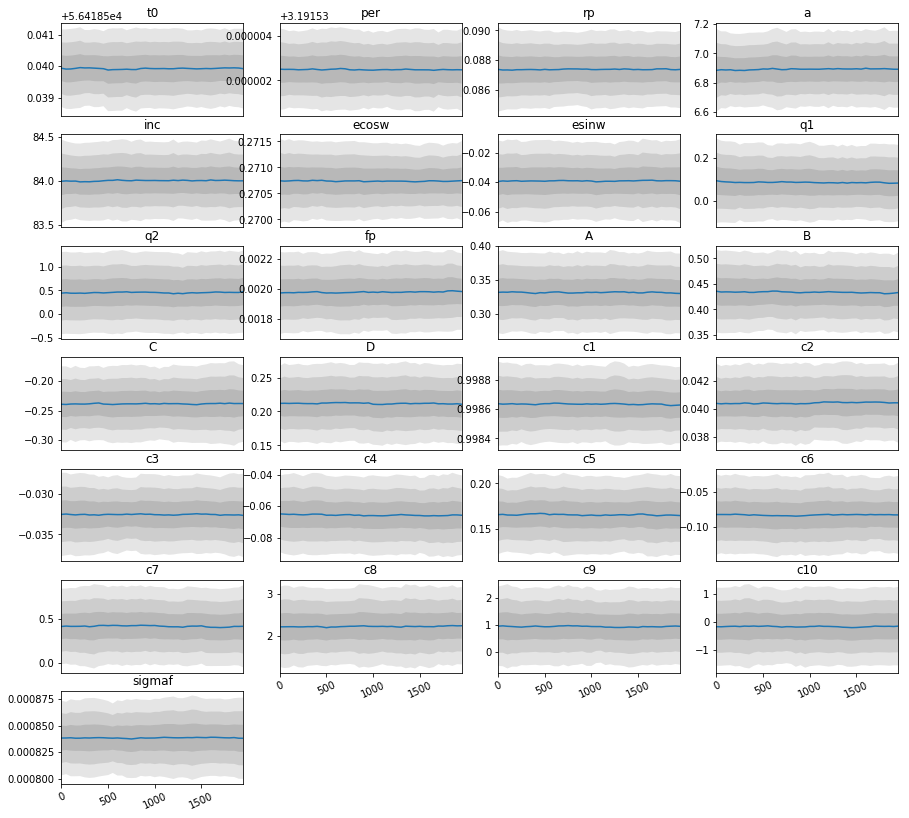

In [78]:
# see if the mcmc has converged
models_fit.walk_style(len(p0), nwalkers, samplechain, 50, 2000, p0_name)

pathplot2 = save_poly3_v2 + '02_Convergence_Criterion.pdf'
plt.savefig(pathplot2, bbox_inches='tight')

In [79]:
mcmc_detect = models_fit.detec_poly((xdata, ydata, mid_x, mid_y), c1_mcmc[0], c2_mcmc[0], 
                                     c3_mcmc[0], c4_mcmc[0], c5_mcmc[0], c6_mcmc[0], c7_mcmc[0], c8_mcmc[0], c9_mcmc[0], c10_mcmc[0])

mcmc_pcurve = models_fit.phase_curve(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], 
                                     inc_mcmc[0], ecosw_mcmc[0], esinw_mcmc[0], q1_mcmc[0], 
                                     q2_mcmc[0], fp_mcmc[0], A_mcmc[0], B_mcmc[0], C=C_mcmc[0], D=D_mcmc[0])

orb_phase = (time-t0_mcmc[0])/per_mcmc[0]

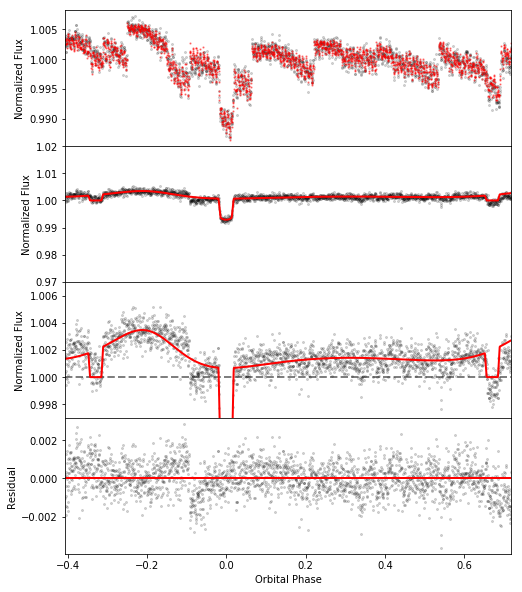

In [80]:
fig, axes = plt.subplots(ncols = 1, nrows = 4, sharex = True, figsize=(8, 10))

axes[0].set_xlim(np.min(orb_phase), np.max(orb_phase))
axes[0].plot(orb_phase, flux, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[0].plot(orb_phase, mcmc_pcurve*mcmc_detect, '.', color = 'r', markersize = 2.5, alpha = 0.4)
#axes[0].set_yticks(np.arange(0.97, 1.03, 0.01))
axes[0].set_ylabel('Normalized Flux')

axes[1].plot(orb_phase, flux/mcmc_detect, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[1].plot(orb_phase, mcmc_pcurve, color = 'r', linewidth=2)
axes[1].set_yticks(np.arange(0.97, 1.02, 0.01))
axes[1].set_ylabel('Normalized Flux')

axes[2].axhline(y=1, color='k', linewidth = 2, linestyle='dashed', alpha = 0.5)
axes[2].plot(orb_phase, flux/mcmc_detect, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[2].plot(orb_phase, mcmc_pcurve, color = 'r', linewidth=2)
axes[2].set_yticks(np.arange(0.998, 1.007, 0.002))
axes[2].set_ylabel('Normalized Flux')
axes[2].set_ylim(0.997, 1.007)

axes[3].plot(orb_phase, flux/mcmc_detect - mcmc_pcurve, 'k.', markersize = 4, alpha = 0.15)
axes[3].axhline(y=0, color='r', linewidth = 2)
axes[3].set_ylabel('Residual')
axes[3].set_xlabel('Orbital Phase')

fig.subplots_adjust(hspace=0)

pathplot3 = save_poly3_v2 + '03_Fit.pdf'
fig.savefig(pathplot3, bbox_inches='tight')

In [81]:
data     = (flux/mcmc_detect)
fit      = mcmc_pcurve
ferr_fit = np.ones(len(flux))*sigmaf_mcmc[0]

# chi-square
chi_bin  = models_fit.get_chi2(data, fit, ferr_fit)
print('chi^2:', chi_bin)
# loglikelihood
logL_bin = models_fit.get_lnlike(data, fit, ferr_fit)
print('Lnlike: ', logL_bin)
# get Bayesian Information Criterion
BIC_bin  = models_fit.get_BIC(logL_bin, ndim, len(data))
print('BIC: ', BIC_bin)

gfit_name = ['chi2-bin', 'lnlike-bin', 'BIC-bin']
gfit_bin = [chi_bin, logL_bin, BIC_bin]

chi^2: 2373.38408036
Lnlike:  15723.0506246
BIC:  -31251.6564335


In [82]:
# getting goodness of fit on full dataset

FULL_detect = models_fit.detec_poly((XDATA, YDATA, mid_x, mid_y), c1_mcmc[0], c2_mcmc[0], 
                                     c3_mcmc[0], c4_mcmc[0], c5_mcmc[0], c6_mcmc[0], c7_mcmc[0], c8_mcmc[0], c9_mcmc[0], c10_mcmc[0])

FULL_detect = np.ma.masked_array(FULL_detect, mask=(XDATA_clip.mask+YDATA_clip.mask))

FULL_pcurve = models_fit.phase_curve(TIME, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], 
                                     inc_mcmc[0], ecosw_mcmc[0], esinw_mcmc[0], q1_mcmc[0], 
                                     q2_mcmc[0], fp_mcmc[0], A_mcmc[0], B_mcmc[0], C=C_mcmc[0], D=D_mcmc[0])

FULL_data = (FLUX_clip/FULL_detect)
FULL_fit  = FULL_pcurve
FULL_ferr = np.ones(len(FLUX))*sigmaf_mcmc[0]*np.sqrt(63)

# chi-square
chi_FULL  = models_fit.get_chi2(FULL_data, FULL_fit, FULL_ferr)
print('chi^2:', chi_FULL)
# loglikelihood
logL_FULL = models_fit.get_lnlike(FULL_data, FULL_fit, FULL_ferr)
print('Lnlike: ', logL_FULL)
# get Bayesian Information Criterion
BIC_FULL  = models_fit.get_BIC(logL_FULL, ndim, len(FULL_data))
print('BIC: ', BIC_FULL)

gfit_name2 = ['chi2-full', 'lnlike-full', 'BIC-full']
gfit_full  = [chi_FULL, logL_FULL, BIC_FULL]

chi^2: 60783.1295158
Lnlike:  732172.99161
BIC:  -1464047.55586


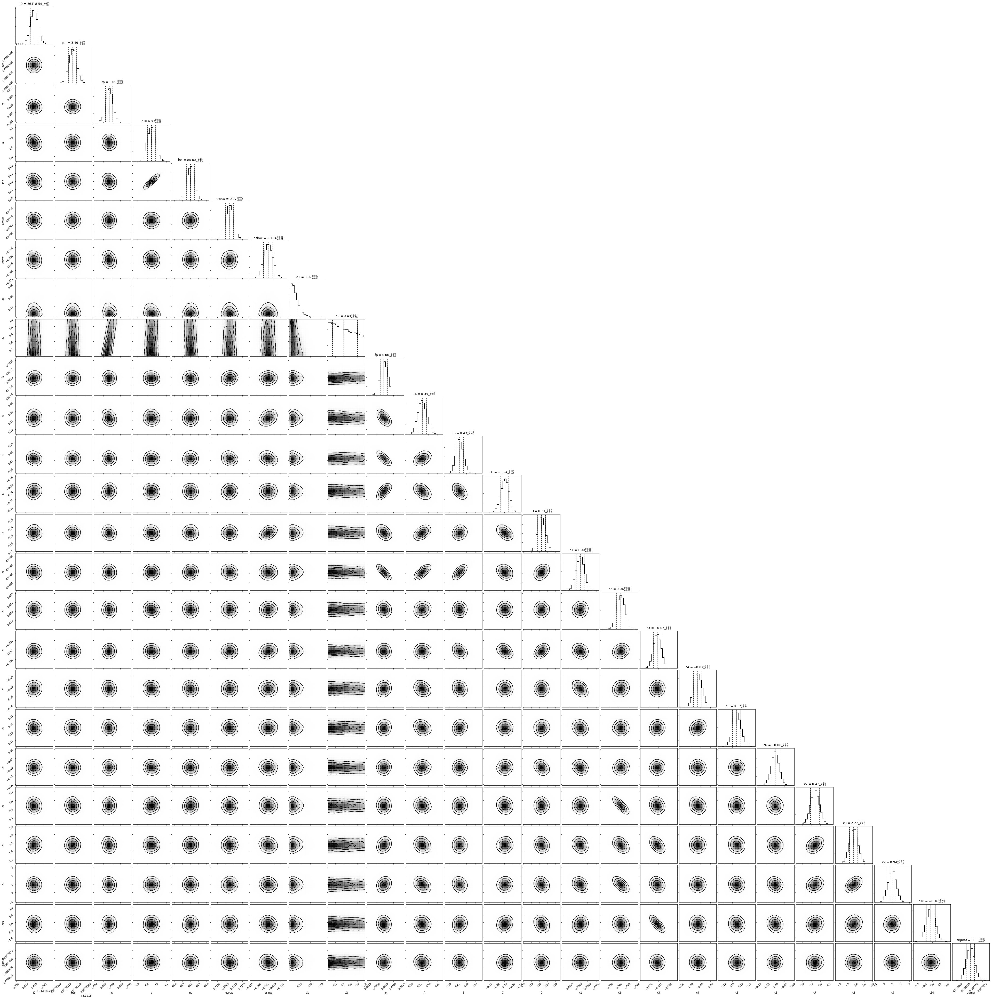

In [83]:
fig = corner.corner(samples, labels=p0_name, quantiles=[0.16, 0.5, 0.84], show_titles=True, 
                    title_kwargs={"fontsize": 12}, plot_datapoints=False)

pathplot4 = save_poly3_v2 + '04_Corner_plot.pdf'
fig.savefig(pathplot4, bbox_inches='tight')

In [84]:
# converting esinw and ecosw
e_chain = np.sqrt(samples[:,5]**2 + samples[:,6]**2)
w_chain = np.rad2deg(np.arctan(samples[:,6]/samples[:,5])) +360

# find a smart way to implement this
'''if (ecosw <= 0):
    w = np.arctan(esinw/ecosw) + np.pi                          # this is in radians!!
else:
    w = np.arctan(esinw/ecosw)'''

# getting u1 and u2 from Kipping (2013) parametrization q1 and q2 
u1_chain = 2*np.sqrt(samples[:,7]**2)*samples[:,8]
u2_chain = np.sqrt(samples[:,7]**2)*(1-2*samples[:,8])

# getting bin-delimitation
binse  = np.linspace(np.min(e_chain), np.max(e_chain), 20)
binsw  = np.linspace(np.min(w_chain), np.max(w_chain), 20)
binsu1 = np.linspace(np.min(u1_chain), np.max(u1_chain), 20)
binsu2 = np.linspace(np.min(u2_chain), np.max(u2_chain), 20)

# derived quantities
v = np.percentile(e_chain, [16, 50, 84])
e_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(w_chain, [16, 50, 84])
w_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(u1_chain, [16, 50, 84])
u1_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(u2_chain, [16, 50, 84])
u2_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

p0_name2      = ['ecc', 'w', 'u1', 'u2']
MCMC_Results2 = [e_mcmc, w_mcmc, u1_mcmc, u2_mcmc]

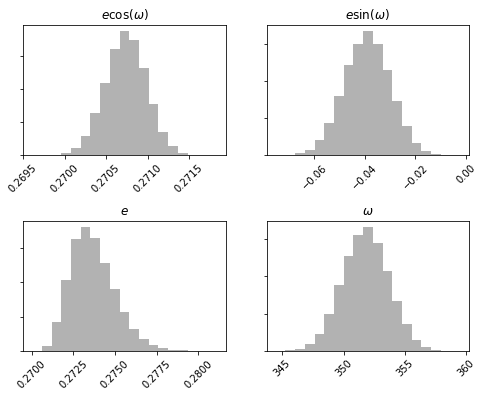

In [85]:
# Plotting Eccentricity and Longitude of Periastron 
fig, axes = plt.subplots(ncols = 2, nrows = 2, figsize = (8,6))
axes[0,0].hist(samples[:,5], bins=np.linspace(np.min(samples[:,5]), np.max(samples[:,5]), 20), color='k', alpha=0.3)
axes[0,1].hist(samples[:,6], bins=np.linspace(np.min(samples[:,6]), np.max(samples[:,6]), 20), color='k', alpha=0.3)
axes[1,0].hist(e_chain, binse, color='k', alpha=0.3)
axes[1,1].hist(w_chain, binsw, color='k', alpha=0.3)

plt.setp(axes[0,0].get_yticklabels(), visible=False)
plt.setp(axes[0,1].get_yticklabels(), visible=False)
plt.setp(axes[1,0].get_yticklabels(), visible=False)
plt.setp(axes[1,1].get_yticklabels(), visible=False)

plt.setp(axes[0,0].get_xticklabels(), rotation = 45)
plt.setp(axes[0,1].get_xticklabels(), rotation = 45)
plt.setp(axes[1,0].get_xticklabels(), rotation = 45)
plt.setp(axes[1,1].get_xticklabels(), rotation = 45)

axes[0,0].set_title('$e \cos (\omega)$', fontsize=12)
axes[0,1].set_title('$e \sin (\omega)$', fontsize=12)
axes[1,0].set_title('$e$', fontsize=12)
axes[1,1].set_title('$\omega$', fontsize=12)

fig.subplots_adjust(hspace=0.5)
fig.subplots_adjust(wspace=0.2)
pathplot5 = save_poly3_v2 + '05_Ecc_Omega.pdf'
fig.savefig(pathplot5, bbox_inches='tight')

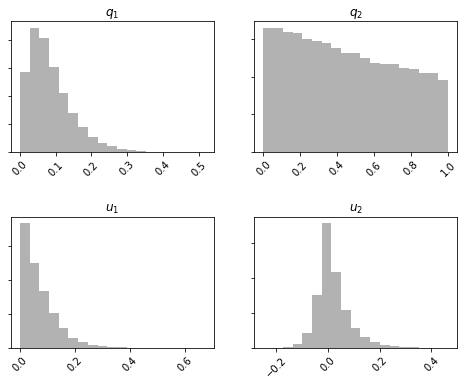

In [86]:
#Limb Darkening Coefficient

fig, axes = plt.subplots(ncols = 2, nrows = 2, figsize = (8,6))
axes[0,0].hist(samples[:,7], bins=np.linspace(np.min(samples[:,7]), np.max(samples[:,7]), 20), color='k', alpha=0.3)
axes[0,1].hist(samples[:,8], bins=np.linspace(np.min(samples[:,8]), np.max(samples[:,8]), 20), color='k', alpha=0.3)
axes[1,0].hist(u1_chain, binsu1, color='k', alpha=0.3)
axes[1,1].hist(u2_chain, binsu2, color='k', alpha=0.3)

plt.setp(axes[0,0].get_yticklabels(), visible=False)
plt.setp(axes[0,1].get_yticklabels(), visible=False)
plt.setp(axes[1,0].get_yticklabels(), visible=False)
plt.setp(axes[1,1].get_yticklabels(), visible=False)

plt.setp(axes[0,0].get_xticklabels(), rotation = 45)
plt.setp(axes[0,1].get_xticklabels(), rotation = 45)
plt.setp(axes[1,0].get_xticklabels(), rotation = 45)
plt.setp(axes[1,1].get_xticklabels(), rotation = 45)

axes[0,0].set_title('$q_1$', fontsize=12)
axes[0,1].set_title('$q_2$', fontsize=12)
axes[1,0].set_title('$u_1$', fontsize=12)
axes[1,1].set_title('$u_2$', fontsize=12)

fig.subplots_adjust(hspace=0.5)
fig.subplots_adjust(wspace=0.2)
fig.subplots_adjust(wspace=0.2)
pathplot6 = save_poly3_v2 + '06_Limb_Dark.pdf'
fig.savefig(pathplot6, bbox_inches='tight')

In [87]:
# determining in-eclipse and in-transit index

# generating transit model
trans, tsect, anomaly = models_fit.transit_model(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], 
                                                 a_mcmc[0], inc_mcmc[0], np.median(e_chain), 
                                                 np.median(np.deg2rad(w_chain)), 
                                                 np.median(u1_chain), np.median(u2_chain))
# generating secondary eclipses model
eclip = models_fit.eclipse(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], inc_mcmc[0], 
                           np.median(e_chain), np.median(np.deg2rad(w_chain)), np.median(u1_chain), np.median(u2_chain), 
                           fp_mcmc[0], tsect)

# get in-transit indices
ind_trans  = np.where(trans!=1)
# get in-eclipse indices
ind_eclip  = np.where((eclip!=(1+fp_mcmc[0])))
# seperating first and second eclipse
ind_ecli1 = ind_eclip[0][np.where(ind_eclip[0]<int(len(time)/2))]
ind_ecli2 = ind_eclip[0][np.where(ind_eclip[0]>int(len(time)/2))]

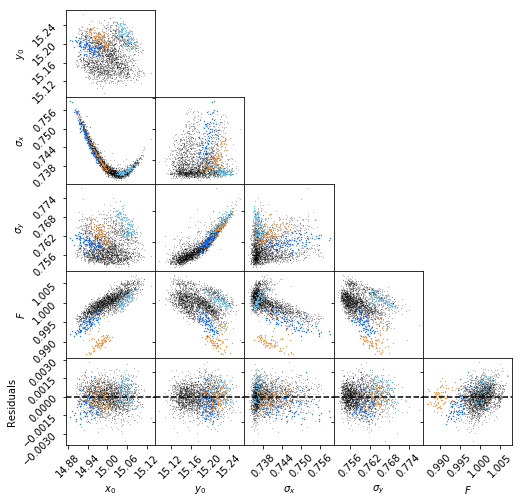

In [88]:
residual = flux/mcmc_detect - mcmc_pcurve

data1 = [xdata, ydata, psfxw, psfyw, flux, residual]
data2 = [xdata[ind_ecli1], ydata[ind_ecli1], psfxw[ind_ecli1], psfyw[ind_ecli1], flux[ind_ecli1], residual[ind_ecli1]]
data3 = [xdata[ind_trans], ydata[ind_trans], psfxw[ind_trans], psfyw[ind_trans], flux[ind_trans], residual[ind_trans]]
data4 = [xdata[ind_ecli2], ydata[ind_ecli2], psfxw[ind_ecli2], psfyw[ind_ecli2], flux[ind_ecli2], residual[ind_ecli2]]
label = ['$x_0$', '$y_0$', '$\sigma _x$', '$\sigma _y$', '$F$', 'Residuals']

#models_fit.
models_fit.triangle_colors(data1, data2, data3, data4, label)
pathplot7 = save_poly3_v2 + '07_PSF_Diagnostics.pdf'
fig.savefig(pathplot7, bbox_inches='tight')

In [89]:
ResultMCMC_Params = Table()

for i in range(len(p0_name)):
    ResultMCMC_Params[p0_name[i]] = MCMC_Results[i]
    
for i in range(len(p0_name2)):
    ResultMCMC_Params[p0_name2[i]] = MCMC_Results2[i]
    
for i in range(len(gfit_name)):
    ResultMCMC_Params[gfit_name[i]] = gfit_bin[i]

for i in range(len(gfit_name)):
    ResultMCMC_Params[gfit_name2[i]] = gfit_full[i]
    
pathresu = save_poly3_v2 + '/mcmc_results.npy'
np.save(pathresu, ResultMCMC_Params)

In [90]:
plt.close('all')
sampler.reset()

# Polynomial Order 4; Phase Variation Order 1

In [96]:
save_poly4_v1  = save_path + 'poly4_v1/'            # location where outputs will be saved
if not os.path.exists(save_poly4_v1): os.makedirs(save_poly4_v1)

print('Do you want to start with mcmc output from previous fit?(y/n)')
guess = input()

if (guess=='n'):
    C    = 0.001
    D    = 0.0
    
else:
    guesspath = save_poly3_v1 + 'mcmc_results.npy'
    R = np.load(guesspath)
    t0   = R['t0'][0]
    per  = R['per'][0]
    rp   = R['rp'][0]
    a    = R['a'][0]
    inc  = R['inc'][0]             
    ecosw= R['ecosw'][0]
    esinw= R['esinw'][0]
    q1   = R['q1'][0]
    q2   = R['q2'][0]
    fp   = R['fp'][0]

    # Phase Variation Parameters (2 params)
    A    = R['A'][0]
    B    = R['B'][0]
    C    = 0.0
    D    = 0.0
    
    # Phase Variation Parameters (2 params)
    c1   = R['c1'][0]
    c2   = R['c2'][0]
    c3   = R['c3'][0]
    c4   = R['c4'][0]
    c5   = R['c5'][0]
    c6   = R['c6'][0]
    c7   = R['c7'][0]
    c8   = R['c8'][0]
    c9   = R['c9'][0]
    c10  = R['c10'][0]
    c11  = 0.0
    c12  = 0.0
    c13  = 0.0
    c14  = 0.0
    c15  = 0.0

    # pre-calculation
    mid_x = np.mean(xdata)
    mid_y = np.mean(ydata)

    # photometric scatter
    sigmaf = R['sigmaf'][0]

Do you want to start with mcmc output from previous fit?(y/n)
y


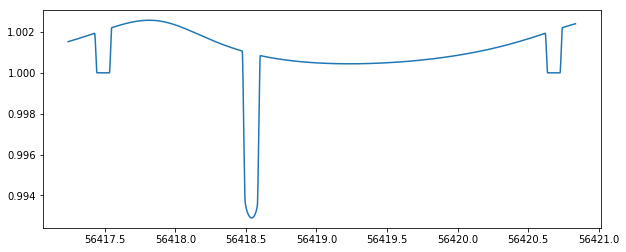

In [97]:
# calculate Initial guess for detector coefficients
astro = models_fit.phase_curve(time, t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B)
resid = flux/astro

plt.figure(figsize=(10,4))
plt.plot(time, astro)


p0 = np.array([c1, c2, c3, c4, c5, c6, c7, c8, c9, c10, c11, c12, c13, c14, c15])

popt, pcov = scipy.optimize.curve_fit(models_fit.detec_poly, (xdata, ydata, mid_x, mid_y), resid, p0)

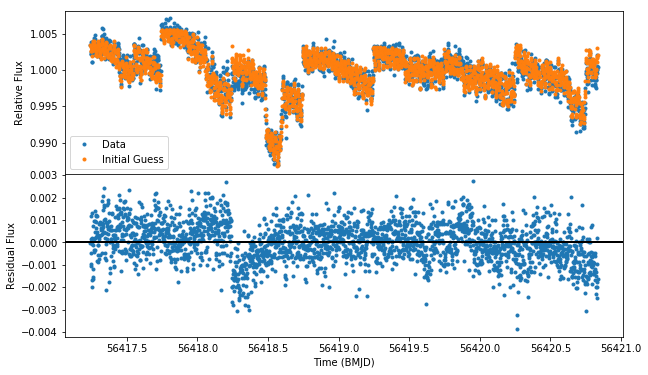

In [98]:
c1, c2, c3, c4, c5, c6, c7, c8, c9, c10, c11, c12, c13, c14, c15 = popt
detect = models_fit.detec_poly((xdata, ydata, mid_x, mid_y), c1, c2, c3, c4, c5, c6, c7, c8, c9, c10, c11, c12, c13, c14, c15)

fig, axes =plt.subplots(nrows=2, ncols=1, sharex=True, figsize=(10,6))
axes[0].plot(time,flux, '.', label = 'Data')
#axes[0].plot(time, resid, '.')
axes[0].plot(time, detect*astro, '.', label = 'Initial Guess')
axes[0].legend()
axes[0].set_ylabel('Relative Flux')

axes[1].plot(time, flux-detect*astro, '.')
axes[1].axhline(y=0, color='k', linewidth=2)
axes[1].set_xlabel('Time (BMJD)')
axes[1].set_ylabel('Residual Flux')

fig.subplots_adjust(hspace=0)

In [163]:
#Log likelihood function
def lnlike(p0, time, flux, xdata, ydata, mid_x, mid_y):
    # unpack p0
    t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, c1, c2, c3, c4, \
    c5, c6, c7, c8, c9, c10, c11, c12, c13, c14, c15, flux_err = p0
    # define model
    model = models_fit.signal_poly(time, per, t0, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, 
                   xdata, ydata, mid_x, mid_y, c1, c2, c3, c4, c5, c6, c7, c8, c9, c10, 
                                   c11, c12, c13, c14, c15)
    inv_sigma2 = 1.0/(flux_err**2)
    return -0.5*(np.sum((flux-model)**2*inv_sigma2) - len(flux)*np.log(inv_sigma2))

# Probability distribution to draw sample from
def lnprior(p0):
    t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, c1, c2, c3, c4, \
    c5, c6, c7, c8, c9, c10, c11, c12, c13, c14, c15, flux_err = p0
    # gaussian prior for per
    lgpri_per = -0.5*(((per - 3.1915325)/0.0000006)**2.0)
    # gaussian prior for a
    lgpri_a = -0.5*(((a - 7.07)/0.31)**2.0)
    # gaussian prior for i
    lgpri_i = -0.5*(((inc - 84.11)/0.16)**2.0)
    # gaussian prior for ecosw
    lgpri_ecosw = -0.5*(((ecosw - 0.27005)/0.00026)**2.0)
    # gaussian prior for esinw
    lgpri_esinw = -0.5*(((esinw +  0.0612)/0.0083)**2.0)
    # uniform prior for the rest
    if (56418.4 < t0 < 56418.6 and 0 < rp < 1  and 0 < fp < 1 and 
        0 < q1 < 1 and 0 < q2 < 1):
        return 0.0 + lgpri_a + lgpri_i + lgpri_ecosw + lgpri_esinw + lgpri_per
    return -np.inf

# Total probability function
def lnprob(p0, time, flux, xdata, ydata, mid_x, mid_y):
    lp = lnprior(p0)
    if not np.isfinite(lp):
        return -np.inf
    return lp + lnlike(p0, time, flux, xdata, ydata, mid_x, mid_y)

In [164]:
# Getting ready for MCMC

p0 = np.array([t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, c1, c2, c3,
               c4, c5, c6, c7, c8, c9, c10, c11, c12, c13, c14, c15, sigmaf])

# total nb steps
totalsteps = 0
# instruction for sampling
ndim, nwalkers, nstep = len(p0), 500, 3000
# get scattered starting point in parameter space 
pos = [p0 + 10**(-5)*np.random.randn(ndim) for i in range(nwalkers)]

#sampler
sampler = emcee.EnsembleSampler(nwalkers, ndim, lnprob, 
                                args=(time, flux, xdata, ydata, mid_x, mid_y))

In [185]:
print('Do you want to run an mcmc or load mcmc results? (run/load)')
answer = input()

if (answer=='run'):
    print('Is this your first run? (y/n)')
    answer2 = input()
    if (answer2=='y'):
        # Running MCMC
        print("Running MCMC...")
        tic = t.clock()
        pos, lnprob, state = sampler.run_mcmc(pos, nstep)
        toc = t.clock()
        print("Done.") 
        print("time taken: ")
        print(toc - tic)
        totalsteps += nstep
    else: # continue the chain
        sampler.reset()
        print("Running MCMC...")
        tic = t.clock()
        pos, lnprob, state = sampler.run_mcmc(pos, nstep, rstate0=state)
        toc = t.clock()
        print("Done.") 
        print("time taken: ")
        print(toc - tic)
        totalsteps += nstep

Do you want to run an mcmc or load mcmc results? (run/load)
load


In [186]:
np.median(sampler.acceptance_fraction)

C:\Users\Lisa\Anaconda3\lib\site-packages\emcee\sampler.py:79: RuntimeWarning: invalid value encountered in true_divide
  return self.naccepted / self.iterations
C:\Users\Lisa\Anaconda3\lib\site-packages\numpy\lib\function_base.py:4011: RuntimeWarning: Invalid value encountered in median
  r = func(a, **kwargs)


nan

In [187]:
# Path names 
pathchain = save_poly4_v1 + 'samplerchainpoly4.npy'
pathposit = save_poly4_v1 + 'samplerposi_poly4.npy'
pathstate = save_poly4_v1 + 'samplerstatepoly4.npy'
pathlnpro = save_poly4_v1 + 'samplerlnpropoly4.npy'

# move path
movechain = save_poly4_v1 + 'old_chain/samplerchainpoly4.npy'
moveposit = save_poly4_v1 + 'old_chain/samplerposi_poly4.npy'
movestate = save_poly4_v1 + 'old_chain/samplerstatepoly4.npy'
movelnpro = save_poly4_v1 + 'old_chain/samplerlnpropoly4.npy'

# make old_chain directory
old_chain = save_poly4_v1 + 'old_chain'
if not os.path.exists(old_chain): os.makedirs(old_chain)

# save MCMC run data
if(answer=='run'):
    samplechain = sampler.chain[:,-2000:,:]
    if not os.path.exists(pathchain): 
        np.save(pathchain, sampler.chain[:,-2000:,:])
    else: 
        
        os.rename(pathchain, movechain)
        np.save(pathchain, sampler.chain[:,-2000:,:])
    if not os.path.exists(pathposit): 
        np.save(pathposit, pos)
    else: 
        os.rename(pathposit, moveposit)
        np.save(pathposit, pos)
    if not os.path.exists(pathstate): np.save(pathstate, state[0])
    else: 
        os.rename(pathstate, movestate)
        np.save(pathstate, state[0])
    if not os.path.exists(pathlnpro): np.save(pathlnpro, lnprob)
    else: 
        os.rename(pathlnpro, movelnpro)
        np.save(pathlnpro, lnprob)
            
elif(answer=='load'):
    samplechain = np.load(pathchain)
    pos         = np.load(pathposit)
    state       = np.load(pathstate)
    lnprob      = np.load(pathlnpro)
else:
    print('Error: Invalid answer')

In [188]:
# come back here after you see you corner plot and decide to remove outlier chain
print('Did you see you corner plot already? (y/n)')
answer3 = input()

if (answer3=='y'):
    # if you want to delete the outlier chains
    chain_med  = np.median(samplechain[:,:,0], axis=1)               # [all walkers, all steps, param0=t0]
    clip_index = np.where(np.fabs(chain_med-np.median(chain_med))>3*np.std(chain_med))
    
    # delete bad chains
    samplechain = np.delete(samplechain, clip_index, axis=0)
    pos    = np.delete(pos, clip_index, axis=0) 
    lnprob = np.delete(lnprob, clip_index)
    
    # save new chains
    np.save(pathchain, samplechain)
    np.save(pathposit, pos)
    np.save(pathlnpro, lnprob)

Did you see you corner plot already? (y/n)



In [189]:
# print the results
samples = samplechain.reshape((-1, ndim))

p0_name = np.array(['t0', 'per', 'rp', 'a', 'inc', 'ecosw', 'esinw', 'q1', 'q2', 'fp', 
                    'A', 'B', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 'c9', 'c10', 'c11', 'c12', 'c13', 'c14', 'c15', 'sigmaf'])

(MCMC_Results) = list(map(lambda v: (v[1], v[2]-v[1], v[1]-v[0]), zip(*np.percentile(samples, [16, 50, 84],axis=0))))

t0_mcmc, per_mcmc, rp_mcmc, a_mcmc, inc_mcmc, ecosw_mcmc, \
esinw_mcmc, q1_mcmc, q2_mcmc, fp_mcmc, A_mcmc, B_mcmc, \
c1_mcmc, c2_mcmc, c3_mcmc, c4_mcmc, c5_mcmc, c6_mcmc, c7_mcmc, \
c8_mcmc, c9_mcmc, c10_mcmc, c11_mcmc, c12_mcmc, c13_mcmc, c14_mcmc, c15_mcmc, sigmaf_mcmc = MCMC_Results

for i in range(len(p0)):
    line_new = '{:>8} = {:>16}  +{:>16}  -{:>16}'.format(p0_name[i],MCMC_Results[i][0], MCMC_Results[i][1], MCMC_Results[i][2])
    print(line_new)

      t0 = 56418.539717543434  +0.0004303662935853936  -0.00043640479270834476
     per = 3.1915325016689082  +5.870754047343496e-07  -5.848760893378824e-07
      rp = 0.08931519992904946  +0.0009007618372454673  -0.0008552566446111548
       a = 6.902806831174976  +0.0863599175733345  -0.08655658381280062
     inc = 84.0508831018051  +0.15226296224749092  -0.14731745503578964
   ecosw = 0.27054712288650695  +0.00024883161414163135  -0.0002459886919703447
   esinw = -0.06897689864193139  +0.008300432956447182  -0.00820732207891614
      q1 = 0.06691907632997378  +0.07082457032094026  -0.04217348599827575
      q2 = 0.4218633389682438  +0.3697477769192936  -0.3025961882106517
      fp = 0.0020905899526894147  +9.177721188561531e-05  -9.224734588835848e-05
       A = 0.2859973475004292  +0.018003666756809866  -0.017236543451657427
       B = 0.43097007840498214  +0.026252236090555048  -0.02383016493249457
      c1 = 0.9988560220877731  +9.874292372735738e-05  -9.813435676364612e-05
     

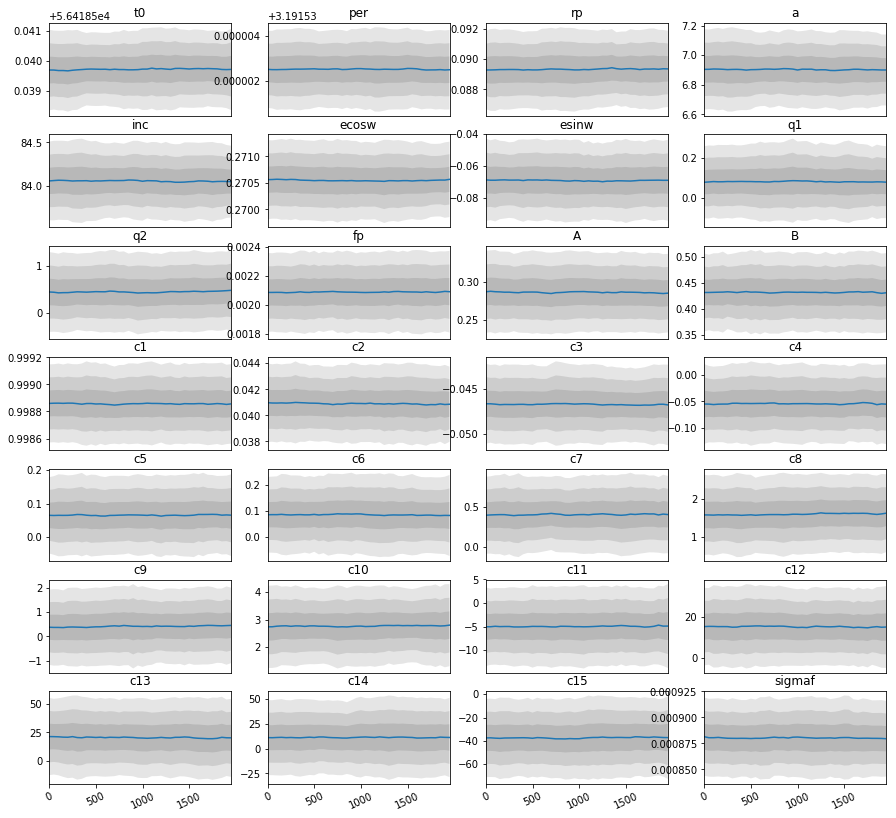

In [190]:
# see if the mcmc has converged
models_fit.walk_style(len(p0), nwalkers, samplechain, 50, 2000, p0_name)

pathplot2 = save_poly4_v1 + '02_Convergence_Criterion.pdf'
plt.savefig(pathplot2, bbox_inches='tight')

In [191]:
mcmc_detect = models_fit.detec_poly((xdata, ydata, mid_x, mid_y), c1_mcmc[0], c2_mcmc[0], 
                                    c3_mcmc[0], c4_mcmc[0], c5_mcmc[0], c6_mcmc[0], c7_mcmc[0], 
                                    c8_mcmc[0], c9_mcmc[0], c10_mcmc[0], c11_mcmc[0], c12_mcmc[0], 
                                    c13_mcmc[0], c14_mcmc[0], c15_mcmc[0])

mcmc_pcurve = models_fit.phase_curve(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], 
                                     inc_mcmc[0], ecosw_mcmc[0], esinw_mcmc[0], q1_mcmc[0], 
                                     q2_mcmc[0], fp_mcmc[0], A_mcmc[0], B_mcmc[0])

orb_phase = (time-t0_mcmc[0])/per_mcmc[0]

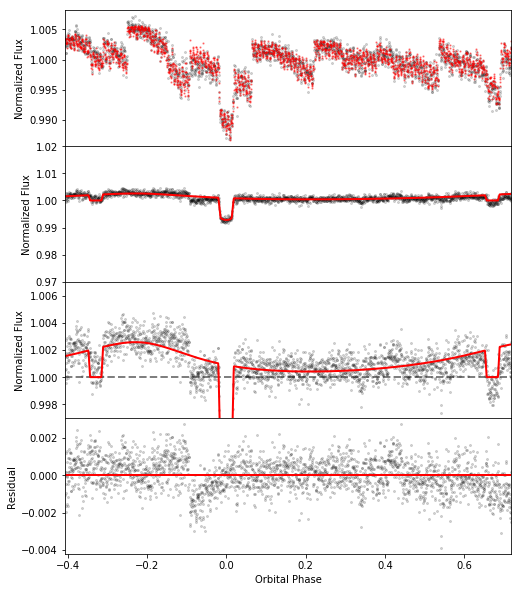

In [192]:
fig, axes = plt.subplots(ncols = 1, nrows = 4, sharex = True, figsize=(8, 10))

axes[0].set_xlim(np.min(orb_phase), np.max(orb_phase))
axes[0].plot(orb_phase, flux, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[0].plot(orb_phase, mcmc_pcurve*mcmc_detect, '.', color = 'r', markersize = 2.5, alpha = 0.4)
#axes[0].set_yticks(np.arange(0.97, 1.03, 0.01))
axes[0].set_ylabel('Normalized Flux')

axes[1].plot(orb_phase, flux/mcmc_detect, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[1].plot(orb_phase, mcmc_pcurve, color = 'r', linewidth=2)
axes[1].set_yticks(np.arange(0.97, 1.02, 0.01))
axes[1].set_ylabel('Normalized Flux')

axes[2].axhline(y=1, color='k', linewidth = 2, linestyle='dashed', alpha = 0.5)
axes[2].plot(orb_phase, flux/mcmc_detect, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[2].plot(orb_phase, mcmc_pcurve, color = 'r', linewidth=2)
axes[2].set_yticks(np.arange(0.998, 1.007, 0.002))
axes[2].set_ylabel('Normalized Flux')
axes[2].set_ylim(0.997, 1.007)

axes[3].plot(orb_phase, flux/mcmc_detect - mcmc_pcurve, 'k.', markersize = 4, alpha = 0.15)
axes[3].axhline(y=0, color='r', linewidth = 2)
axes[3].set_ylabel('Residual')
axes[3].set_xlabel('Orbital Phase')

fig.subplots_adjust(hspace=0)

pathplot3 = save_poly4_v1 + '03_Fit.pdf'
fig.savefig(pathplot3, bbox_inches='tight')

In [193]:
data     = (flux/mcmc_detect)
fit      = mcmc_pcurve
ferr_fit = np.ones(len(flux))*sigmaf_mcmc[0]

# chi-square
chi_bin  = models_fit.get_chi2(data, fit, ferr_fit)
print('chi^2:', chi_bin)
# loglikelihood
logL_bin = models_fit.get_lnlike(data, fit, ferr_fit)
print('Lnlike: ', logL_bin)
# get Bayesian Information Criterion
BIC_bin  = models_fit.get_BIC(logL_bin, ndim, len(data))
print('BIC: ', BIC_bin)

gfit_name = ['chi2-bin', 'lnlike-bin', 'BIC-bin']
gfit_bin = [chi_bin, logL_bin, BIC_bin]

chi^2: 2370.86460747
Lnlike:  15608.0372536
BIC:  -30998.2963136


In [194]:
# getting goodness of fit on full dataset

FULL_detect = models_fit.detec_poly((XDATA, YDATA, mid_x, mid_y), c1_mcmc[0], c2_mcmc[0], 
                                     c3_mcmc[0], c4_mcmc[0], c5_mcmc[0], c6_mcmc[0], c7_mcmc[0], c8_mcmc[0], 
                                    c9_mcmc[0], c10_mcmc[0], c11_mcmc[0], c12_mcmc[0], c13_mcmc[0], c14_mcmc[0], c15_mcmc[0])

FULL_detect = np.ma.masked_array(FULL_detect, mask=(XDATA_clip.mask+YDATA_clip.mask))

FULL_pcurve = models_fit.phase_curve(TIME, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], 
                                     inc_mcmc[0], ecosw_mcmc[0], esinw_mcmc[0], q1_mcmc[0], 
                                     q2_mcmc[0], fp_mcmc[0], A_mcmc[0], B_mcmc[0])

FULL_data = (FLUX_clip/FULL_detect)
FULL_fit  = FULL_pcurve
FULL_ferr = np.ones(len(FLUX))*sigmaf_mcmc[0]*np.sqrt(63)

# chi-square
chi_FULL  = models_fit.get_chi2(FULL_data, FULL_fit, FULL_ferr)
print('chi^2:', chi_FULL)
# loglikelihood
logL_FULL = models_fit.get_lnlike(FULL_data, FULL_fit, FULL_ferr)
print('Lnlike: ', logL_FULL)
# get Bayesian Information Criterion
BIC_FULL  = models_fit.get_BIC(logL_FULL, ndim, len(FULL_data))
print('BIC: ', BIC_FULL)

gfit_name2 = ['chi2-full', 'lnlike-full', 'BIC-full']
gfit_full  = [chi_FULL, logL_FULL, BIC_FULL]

chi^2: 55444.5991669
Lnlike:  727420.116167
BIC:  -1454505.99369


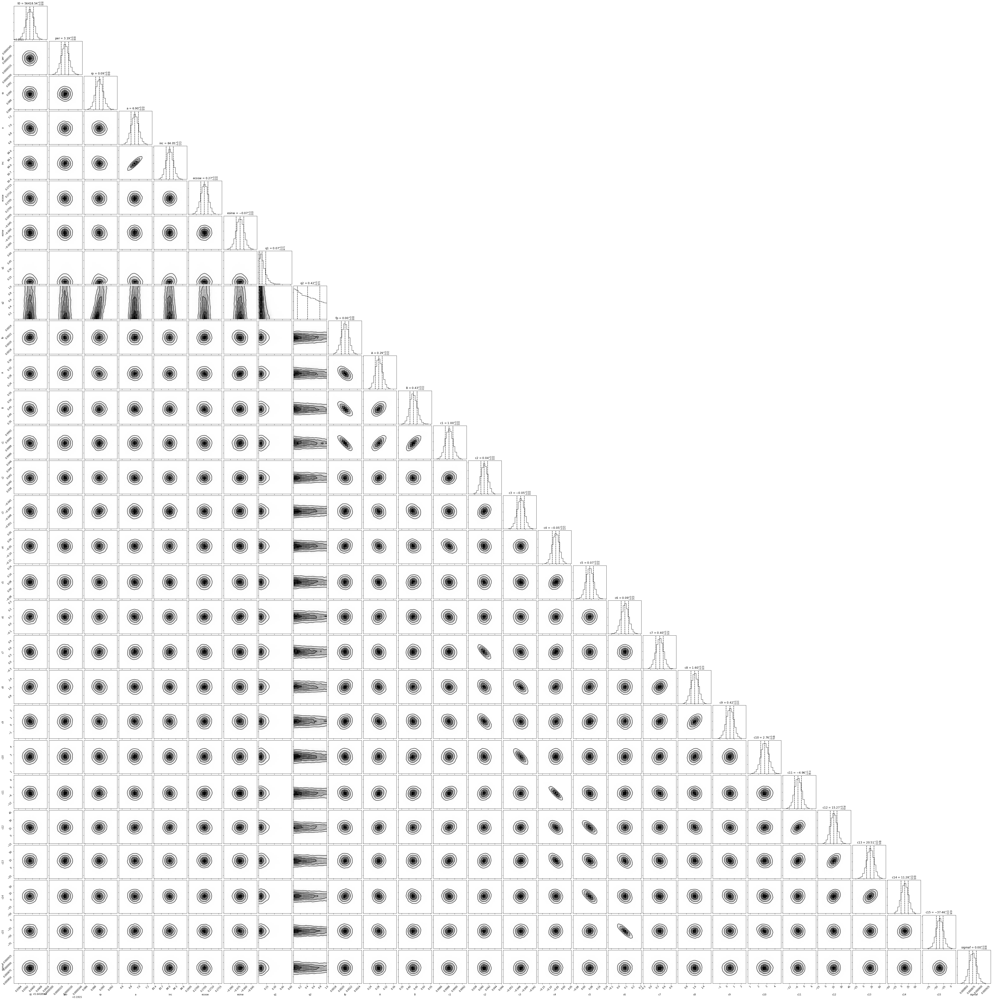

In [195]:
fig = corner.corner(samples, labels=p0_name, quantiles=[0.16, 0.5, 0.84], show_titles=True, 
                    title_kwargs={"fontsize": 12}, plot_datapoints=False)

pathplot4 = save_poly4_v1 + '04_Corner_plot.pdf'
fig.savefig(pathplot4, bbox_inches='tight')

In [196]:
# converting esinw and ecosw
e_chain = np.sqrt(samples[:,5]**2 + samples[:,6]**2)
w_chain = np.rad2deg(np.arctan(samples[:,6]/samples[:,5])) +360

# find a smart way to implement this
'''if (ecosw <= 0):
    w = np.arctan(esinw/ecosw) + np.pi                          # this is in radians!!
else:
    w = np.arctan(esinw/ecosw)'''

# getting u1 and u2 from Kipping (2013) parametrization q1 and q2 
u1_chain = 2*np.sqrt(samples[:,7]**2)*samples[:,8]
u2_chain = np.sqrt(samples[:,7]**2)*(1-2*samples[:,8])

# getting bin-delimitation
binse  = np.linspace(np.min(e_chain), np.max(e_chain), 20)
binsw  = np.linspace(np.min(w_chain), np.max(w_chain), 20)
binsu1 = np.linspace(np.min(u1_chain), np.max(u1_chain), 20)
binsu2 = np.linspace(np.min(u2_chain), np.max(u2_chain), 20)

# derived quantities
v = np.percentile(e_chain, [16, 50, 84])
e_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(w_chain, [16, 50, 84])
w_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(u1_chain, [16, 50, 84])
u1_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(u2_chain, [16, 50, 84])
u2_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

p0_name2      = ['ecc', 'w', 'u1', 'u2']
MCMC_Results2 = [e_mcmc, w_mcmc, u1_mcmc, u2_mcmc]

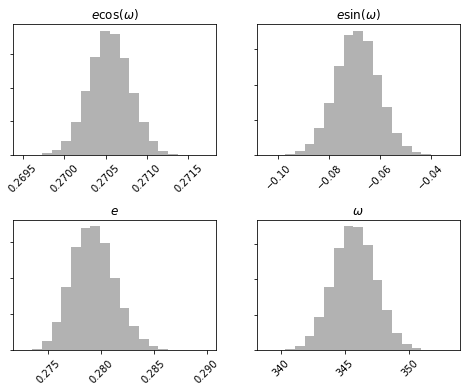

In [197]:
# Plotting Eccentricity and Longitude of Periastron 
fig, axes = plt.subplots(ncols = 2, nrows = 2, figsize = (8,6))
axes[0,0].hist(samples[:,5], bins=np.linspace(np.min(samples[:,5]), np.max(samples[:,5]), 20), color='k', alpha=0.3)
axes[0,1].hist(samples[:,6], bins=np.linspace(np.min(samples[:,6]), np.max(samples[:,6]), 20), color='k', alpha=0.3)
axes[1,0].hist(e_chain, binse, color='k', alpha=0.3)
axes[1,1].hist(w_chain, binsw, color='k', alpha=0.3)

plt.setp(axes[0,0].get_yticklabels(), visible=False)
plt.setp(axes[0,1].get_yticklabels(), visible=False)
plt.setp(axes[1,0].get_yticklabels(), visible=False)
plt.setp(axes[1,1].get_yticklabels(), visible=False)

plt.setp(axes[0,0].get_xticklabels(), rotation = 45)
plt.setp(axes[0,1].get_xticklabels(), rotation = 45)
plt.setp(axes[1,0].get_xticklabels(), rotation = 45)
plt.setp(axes[1,1].get_xticklabels(), rotation = 45)

axes[0,0].set_title('$e \cos (\omega)$', fontsize=12)
axes[0,1].set_title('$e \sin (\omega)$', fontsize=12)
axes[1,0].set_title('$e$', fontsize=12)
axes[1,1].set_title('$\omega$', fontsize=12)

fig.subplots_adjust(hspace=0.5)
fig.subplots_adjust(wspace=0.2)
pathplot5 = save_poly4_v1 + '05_Ecc_Omega.pdf'
fig.savefig(pathplot5, bbox_inches='tight')

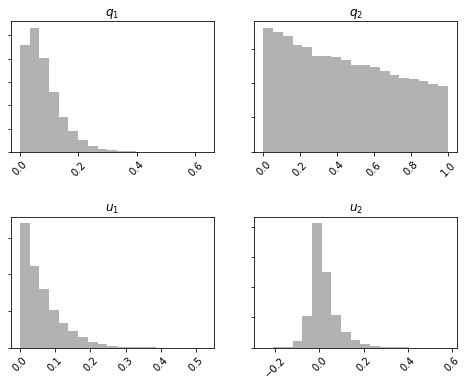

In [198]:
#Limb Darkening Coefficient

fig, axes = plt.subplots(ncols = 2, nrows = 2, figsize = (8,6))
axes[0,0].hist(samples[:,7], bins=np.linspace(np.min(samples[:,7]), np.max(samples[:,7]), 20), color='k', alpha=0.3)
axes[0,1].hist(samples[:,8], bins=np.linspace(np.min(samples[:,8]), np.max(samples[:,8]), 20), color='k', alpha=0.3)
axes[1,0].hist(u1_chain, binsu1, color='k', alpha=0.3)
axes[1,1].hist(u2_chain, binsu2, color='k', alpha=0.3)

plt.setp(axes[0,0].get_yticklabels(), visible=False)
plt.setp(axes[0,1].get_yticklabels(), visible=False)
plt.setp(axes[1,0].get_yticklabels(), visible=False)
plt.setp(axes[1,1].get_yticklabels(), visible=False)

plt.setp(axes[0,0].get_xticklabels(), rotation = 45)
plt.setp(axes[0,1].get_xticklabels(), rotation = 45)
plt.setp(axes[1,0].get_xticklabels(), rotation = 45)
plt.setp(axes[1,1].get_xticklabels(), rotation = 45)

axes[0,0].set_title('$q_1$', fontsize=12)
axes[0,1].set_title('$q_2$', fontsize=12)
axes[1,0].set_title('$u_1$', fontsize=12)
axes[1,1].set_title('$u_2$', fontsize=12)

fig.subplots_adjust(hspace=0.5)
fig.subplots_adjust(wspace=0.2)
fig.subplots_adjust(wspace=0.2)
pathplot6 = save_poly4_v1 + '06_Limb_Dark.pdf'
fig.savefig(pathplot6, bbox_inches='tight')

In [199]:
# determining in-eclipse and in-transit index

# generating transit model
trans, tsect, anomaly = models_fit.transit_model(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], 
                                                 a_mcmc[0], inc_mcmc[0], np.median(e_chain), 
                                                 np.median(np.deg2rad(w_chain)), 
                                                 np.median(u1_chain), np.median(u2_chain))
# generating secondary eclipses model
eclip = models_fit.eclipse(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], inc_mcmc[0], 
                           np.median(e_chain), np.median(np.deg2rad(w_chain)), np.median(u1_chain), np.median(u2_chain), 
                           fp_mcmc[0], tsect)

# get in-transit indices
ind_trans  = np.where(trans!=1)
# get in-eclipse indices
ind_eclip  = np.where((eclip!=(1+fp_mcmc[0])))
# seperating first and second eclipse
ind_ecli1 = ind_eclip[0][np.where(ind_eclip[0]<int(len(time)/2))]
ind_ecli2 = ind_eclip[0][np.where(ind_eclip[0]>int(len(time)/2))]

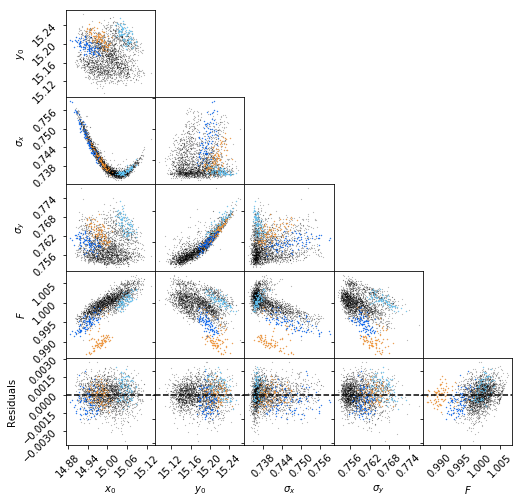

In [200]:
residual = flux/mcmc_detect - mcmc_pcurve

data1 = [xdata, ydata, psfxw, psfyw, flux, residual]
data2 = [xdata[ind_ecli1], ydata[ind_ecli1], psfxw[ind_ecli1], psfyw[ind_ecli1], flux[ind_ecli1], residual[ind_ecli1]]
data3 = [xdata[ind_trans], ydata[ind_trans], psfxw[ind_trans], psfyw[ind_trans], flux[ind_trans], residual[ind_trans]]
data4 = [xdata[ind_ecli2], ydata[ind_ecli2], psfxw[ind_ecli2], psfyw[ind_ecli2], flux[ind_ecli2], residual[ind_ecli2]]
label = ['$x_0$', '$y_0$', '$\sigma _x$', '$\sigma _y$', '$F$', 'Residuals']

models_fit.triangle_colors(data1, data2, data3, data4, label)
pathplot7 = save_poly4_v1 + '07_PSF_Diagnostics.pdf'
fig.savefig(pathplot7, bbox_inches='tight')

In [201]:
ResultMCMC_Params = Table()

for i in range(len(p0_name)):
    ResultMCMC_Params[p0_name[i]] = MCMC_Results[i]
    
for i in range(len(p0_name2)):
    ResultMCMC_Params[p0_name2[i]] = MCMC_Results2[i]
    
for i in range(len(gfit_name)):
    ResultMCMC_Params[gfit_name[i]] = gfit_bin[i]

for i in range(len(gfit_name)):
    ResultMCMC_Params[gfit_name2[i]] = gfit_full[i]
    
pathresu = save_poly4_v1 + '/mcmc_results.npy'
np.save(pathresu, ResultMCMC_Params)

# Polynomial Order 4; Phase Variation Order 2

In [202]:
save_poly4_v2  = save_path + 'poly4_v2/'            # location where outputs will be saved
if not os.path.exists(save_poly4_v2): os.makedirs(save_poly4_v2)

print('Do you want to start with mcmc output from previous fit?(y/n)')
guess = input()

if (guess=='n'):
    C    = 0.001
    D    = 0.0
    
else:
    guesspath = save_poly4_v1 + 'mcmc_results.npy'
    R = np.load(guesspath)
    t0   = R['t0'][0]
    per  = R['per'][0]
    rp   = R['rp'][0]
    a    = R['a'][0]
    inc  = R['inc'][0]             
    ecosw= R['ecosw'][0]
    esinw= R['esinw'][0]
    q1   = R['q1'][0]
    q2   = R['q2'][0]
    fp   = R['fp'][0]

    # Phase Variation Parameters (2 params)
    A    = R['A'][0]
    B    = R['B'][0]
    C    = 0.0
    D    = 0.0
    
    # Phase Variation Parameters (2 params)
    c1   = R['c1'][0]
    c2   = R['c2'][0]
    c3   = R['c3'][0]
    c4   = R['c4'][0]
    c5   = R['c5'][0]
    c6   = R['c6'][0]
    c7   = R['c7'][0]
    c8   = R['c8'][0]
    c9   = R['c9'][0]
    c10  = R['c10'][0]
    c11  = R['c11'][0]
    c12  = R['c12'][0]
    c13  = R['c13'][0]
    c14  = R['c14'][0]
    c15  = R['c15'][0]

    # pre-calculation
    mid_x = np.mean(xdata)
    mid_y = np.mean(ydata)

    # photometric scatter
    sigmaf = R['sigmaf'][0]

Do you want to start with mcmc output from previous fit?(y/n)
y


In [203]:
#Log likelihood function
def lnlike(p0, time, flux, xdata, ydata, mid_x, mid_y):
    # unpack p0
    t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, C, D, c1, c2, c3, c4, c5, c6, c7, c8, c9, c10, c11, c12, c13, c14, c15, sigmaf = p0
    # define model
    model = models_fit.signal_poly(time, per, t0, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, 
                   xdata, ydata, mid_x, mid_y, c1, c2, c3, c4, c5, c6, c7, c8, c9, c10, c11, c12, c13, c14, c15, C=C, D=D)
    inv_sigma2 = 1.0/(sigmaf**2)
    return -0.5*(np.sum((flux-model)**2*inv_sigma2) - len(flux)*np.log(inv_sigma2))

# Probability distribution to draw sample from
def lnprior(p0):
    t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, C, D, c1, c2, c3, c4, c5, c6, c7, c8, c9, c10, c11, c12, c13, c14, c15, sigmaf = p0
    # gaussian prior for per
    lgpri_per = -0.5*(((per - 3.1915325)/0.0000006)**2.0)
    # gaussian prior for a
    lgpri_a = -0.5*(((a - 7.07)/0.31)**2.0)
    # gaussian prior for i
    lgpri_i = -0.5*(((inc - 84.11)/0.16)**2.0)
    # gaussian prior for ecosw
    lgpri_ecosw = -0.5*(((ecosw - 0.27005)/0.00026)**2.0)
    # gaussian prior for esinw
    lgpri_esinw = -0.5*(((esinw +  0.0612)/0.0083)**2.0)
    # uniform prior for the rest
    if (56418.4 < t0 < 56418.6 and 0 < rp < 1  and 0 < fp < 1 and 
        0 < q1 < 1 and 0 < q2 < 1):
        return 0.0 + lgpri_a + lgpri_i + lgpri_ecosw + lgpri_esinw + lgpri_per
    return -np.inf

# Total probability function
def lnprob(p0, time, flux, xdata, ydata, mid_x, mid_y):
    lp = lnprior(p0)
    if not np.isfinite(lp):
        return -np.inf
    return lp + lnlike(p0, time, flux, xdata, ydata, mid_x, mid_y)

In [204]:
# Getting ready for MCMC

p0 = np.array([t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, C, D, c1, c2, c3, c4, c5, c6, c7, c8, c9, c10, c11, c12, c13, c14, c15, sigmaf])

# total nb steps
totalsteps = 0
# instruction for sampling
ndim, nwalkers, nstep = len(p0), 500, 3000
# get scattered starting point in parameter space 
pos = [p0 + 10**(-5)*np.random.randn(ndim) for i in range(nwalkers)]

#sampler
sampler = emcee.EnsembleSampler(nwalkers, ndim, lnprob, 
                                args=(time, flux, xdata, ydata, mid_x, mid_y))

In [205]:
print('Do you want to run an mcmc or load mcmc results? (run/load)')
answer = input()

if (answer=='run'):
    print('Is this your first run? (y/n)')
    answer2 = input()
    if (answer2=='y'):
        # Running MCMC
        print("Running MCMC...")
        tic = t.clock()
        pos, lnprob, state = sampler.run_mcmc(pos, nstep)
        toc = t.clock()
        print("Done.") 
        print("time taken: ")
        print(toc - tic)
        totalsteps += nstep
    else: # continue the chain
        sampler.reset()
        print("Running MCMC...")
        tic = t.clock()
        pos, lnprob, state = sampler.run_mcmc(pos, nstep, rstate0=state)
        toc = t.clock()
        print("Done.") 
        print("time taken: ")
        print(toc - tic)
        totalsteps += nstep

Do you want to run an mcmc or load mcmc results? (run/load)
run
Is this your first run? (y/n)
y
Running MCMC...
Done.
time taken: 
13724.898822445073


In [208]:
# Path names 
pathchain = save_poly4_v2 + 'samplerchainpoly4.npy'
pathposit = save_poly4_v2 + 'samplerposi_poly4.npy'
pathstate = save_poly4_v2 + 'samplerstatepoly4.npy'
pathlnpro = save_poly4_v2 + 'samplerlnpropoly4.npy'

# move path
movechain = save_poly4_v2 + 'old_chain/samplerchainpoly4.npy'
moveposit = save_poly4_v2 + 'old_chain/samplerposi_poly4.npy'
movestate = save_poly4_v2 + 'old_chain/samplerstatepoly4.npy'
movelnpro = save_poly4_v2 + 'old_chain/samplerlnpropoly4.npy'

# make old_chain directory
old_chain = save_poly4_v2 + 'old_chain'
if not os.path.exists(old_chain): os.makedirs(old_chain)

# save MCMC run data
if(answer=='run'):
    samplechain = sampler.chain[:,-2000:,:]
    if not os.path.exists(pathchain): 
        np.save(pathchain, sampler.chain[:,-2000:,:])
    else: 
        
        os.rename(pathchain, movechain)
        np.save(pathchain, sampler.chain[:,-2000:,:])
    if not os.path.exists(pathposit): 
        np.save(pathposit, pos)
    else: 
        os.rename(pathposit, moveposit)
        np.save(pathposit, pos)
    if not os.path.exists(pathstate): np.save(pathstate, state[0])
    else: 
        os.rename(pathstate, movestate)
        np.save(pathstate, state[0])
    if not os.path.exists(pathlnpro): np.save(pathlnpro, lnprob)
    else: 
        os.rename(pathlnpro, movelnpro)
        np.save(pathlnpro, lnprob)
            
elif(answer=='load'):
    samplechain = np.load(pathchain)
    pos         = np.load(pathposit)
    state       = np.load(pathstate)
    lnprob      = np.load(pathlnpro)
else:
    print('Error: Invalid answer')

In [209]:
# come back here after you see you corner plot and decide to remove outlier chain
print('Did you see you corner plot already? (y/n)')
answer3 = input()

if (answer3=='y'):
    # if you want to delete the outlier chains
    chain_med  = np.median(samplechain[:,:,0], axis=1)               # [all walkers, all steps, param0=t0]
    clip_index = np.where(np.fabs(chain_med-np.median(chain_med))>3*np.std(chain_med))
    
    # delete bad chains
    samplechain = np.delete(samplechain, clip_index, axis=0)
    pos    = np.delete(pos, clip_index, axis=0) 
    lnprob = np.delete(lnprob, clip_index)
    
    # save new chains
    np.save(pathchain, samplechain)
    np.save(pathposit, pos)
    np.save(pathlnpro, lnprob)

Did you see you corner plot already? (y/n)
n


In [210]:
# print the results
samples = samplechain.reshape((-1, ndim))

p0_name = np.array(['t0', 'per', 'rp', 'a', 'inc', 'ecosw', 'esinw', 'q1', 'q2', 'fp', 
                    'A', 'B', 'C', 'D', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 'c9', 'c10', 'c11', 'c12', 'c13', 'c14', 'c15', 'sigmaf'])

(MCMC_Results) = list(map(lambda v: (v[1], v[2]-v[1], v[1]-v[0]), zip(*np.percentile(samples, [16, 50, 84],axis=0))))

t0_mcmc, per_mcmc, rp_mcmc, a_mcmc, inc_mcmc, ecosw_mcmc, \
esinw_mcmc, q1_mcmc, q2_mcmc, fp_mcmc, A_mcmc, B_mcmc, C_mcmc, D_mcmc, \
c1_mcmc, c2_mcmc, c3_mcmc, c4_mcmc, c5_mcmc, c6_mcmc, c7_mcmc, c8_mcmc, \
c9_mcmc, c10_mcmc, c11_mcmc, c12_mcmc, c13_mcmc, c14_mcmc, c15_mcmc, sigmaf_mcmc = MCMC_Results

for i in range(len(p0)):
    line_new = '{:>8} = {:>16}  +{:>16}  -{:>16}'.format(p0_name[i],MCMC_Results[i][0], MCMC_Results[i][1], MCMC_Results[i][2])
    print(line_new)

      t0 = 56418.53988049512  +0.0004319647341617383  -0.0004191207481198944
     per = 3.191532514393387  +5.950095847140346e-07  -6.379968979786099e-07
      rp = 0.08761263054392254  +0.0009041321232578919  -0.0008729124124169513
       a = 6.908591915383318  +0.0890353876594947  -0.08781571147533729
     inc = 84.03761168991565  +0.15513022465025017  -0.150990146897243
   ecosw = 0.27063292831813385  +0.0002520372675808291  -0.0002522513096531176
   esinw = -0.041899058092718384  +0.00886121908933369  -0.009127539104986947
      q1 = 0.07129717528381263  +0.07215902595953  -0.0435683301038471
      q2 = 0.4383404974835092  +0.3630734873497375  -0.3096297729138712
      fp = 0.0019692330319499764  +9.559593817722858e-05  -9.072818102725828e-05
       A = 0.34448166388232654  +0.021240888540155045  -0.020817753255687965
       B = 0.4388884177418045  +0.028772090763727165  -0.02651376591517518
       C = -0.23404147864502087  +0.022273783139829834  -0.023924390942977963
       D = 0.

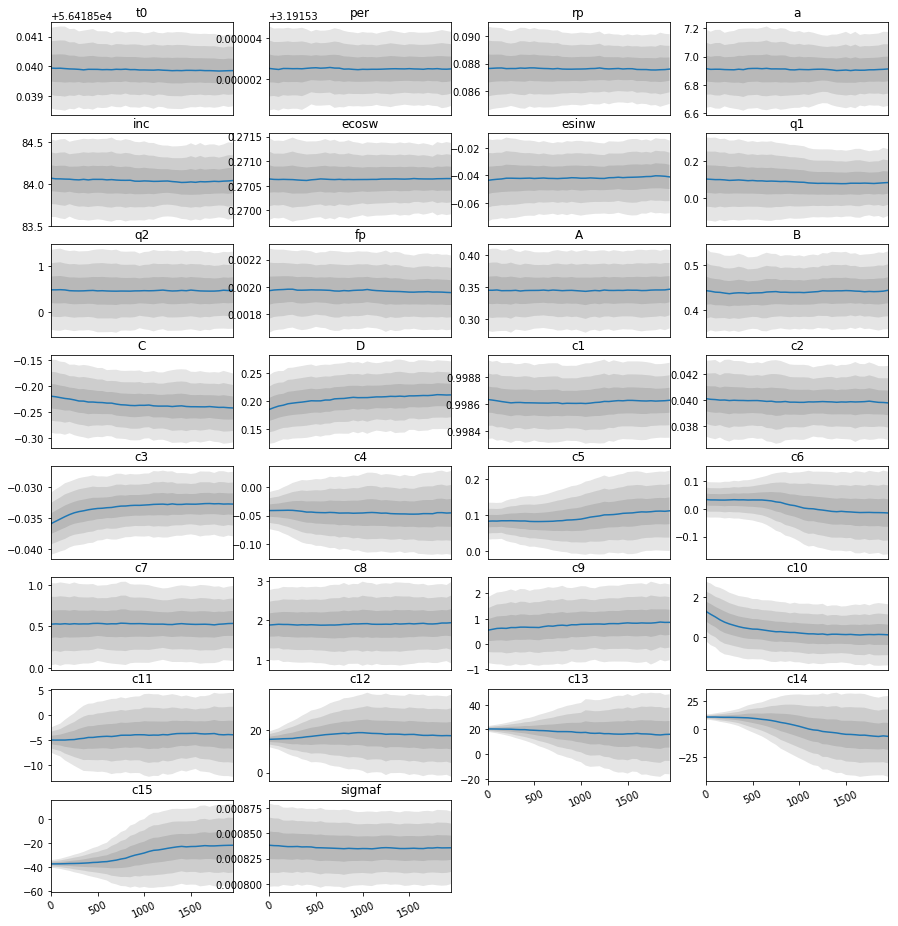

In [211]:
# see if the mcmc has converged
models_fit.walk_style(len(p0), nwalkers, samplechain, 50, 2000, p0_name)

pathplot2 = save_poly4_v2 + '02_Convergence_Criterion.pdf'
plt.savefig(pathplot2, bbox_inches='tight')

In [212]:
mcmc_detect = models_fit.detec_poly((xdata, ydata, mid_x, mid_y), c1_mcmc[0], c2_mcmc[0], 
                                    c3_mcmc[0], c4_mcmc[0], c5_mcmc[0], c6_mcmc[0], c7_mcmc[0], c8_mcmc[0], 
                                    c9_mcmc[0], c10_mcmc[0], c11_mcmc[0], c12_mcmc[0], c13_mcmc[0], c14_mcmc[0], c15_mcmc[0])

mcmc_pcurve = models_fit.phase_curve(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], 
                                     inc_mcmc[0], ecosw_mcmc[0], esinw_mcmc[0], q1_mcmc[0], 
                                     q2_mcmc[0], fp_mcmc[0], A_mcmc[0], B_mcmc[0], C=C_mcmc[0], D=D_mcmc[0])

orb_phase = (time-t0_mcmc[0])/per_mcmc[0]

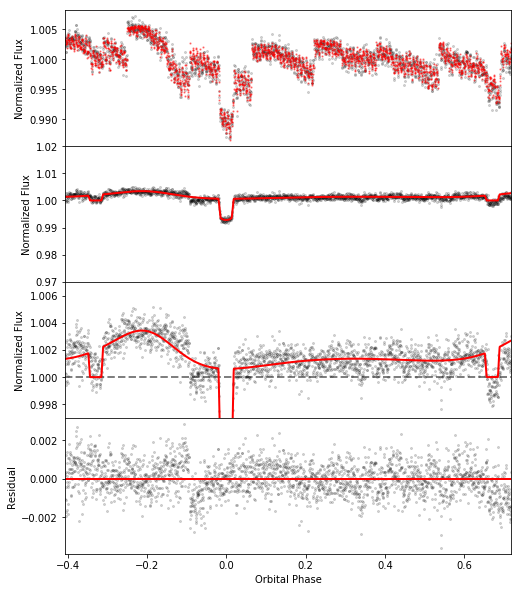

In [214]:
fig, axes = plt.subplots(ncols = 1, nrows = 4, sharex = True, figsize=(8, 10))

axes[0].set_xlim(np.min(orb_phase), np.max(orb_phase))
axes[0].plot(orb_phase, flux, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[0].plot(orb_phase, mcmc_pcurve*mcmc_detect, '.', color = 'r', markersize = 2.5, alpha = 0.4)
#axes[0].set_yticks(np.arange(0.97, 1.03, 0.01))
axes[0].set_ylabel('Normalized Flux')

axes[1].plot(orb_phase, flux/mcmc_detect, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[1].plot(orb_phase, mcmc_pcurve, color = 'r', linewidth=2)
axes[1].set_yticks(np.arange(0.97, 1.02, 0.01))
axes[1].set_ylabel('Normalized Flux')

axes[2].axhline(y=1, color='k', linewidth = 2, linestyle='dashed', alpha = 0.5)
axes[2].plot(orb_phase, flux/mcmc_detect, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[2].plot(orb_phase, mcmc_pcurve, color = 'r', linewidth=2)
axes[2].set_yticks(np.arange(0.998, 1.007, 0.002))
axes[2].set_ylabel('Normalized Flux')
axes[2].set_ylim(0.997, 1.007)

axes[3].plot(orb_phase, flux/mcmc_detect - mcmc_pcurve, 'k.', markersize = 4, alpha = 0.15)
axes[3].axhline(y=0, color='r', linewidth = 2)
axes[3].set_ylabel('Residual')
axes[3].set_xlabel('Orbital Phase')

fig.subplots_adjust(hspace=0)

pathplot3 = save_poly4_v2 + '03_Fit.pdf'
fig.savefig(pathplot3, bbox_inches='tight')

In [215]:
data     = (flux/mcmc_detect)
fit      = mcmc_pcurve
ferr_fit = np.ones(len(flux))*sigmaf_mcmc[0]

# chi-square
chi_bin  = models_fit.get_chi2(data, fit, ferr_fit)
print('chi^2:', chi_bin)
# loglikelihood
logL_bin = models_fit.get_lnlike(data, fit, ferr_fit)
print('Lnlike: ', logL_bin)
# get Bayesian Information Criterion
BIC_bin  = models_fit.get_BIC(logL_bin, ndim, len(data))
print('BIC: ', BIC_bin)

gfit_name = ['chi2-bin', 'lnlike-bin', 'BIC-bin']
gfit_bin = [chi_bin, logL_bin, BIC_bin]

chi^2: 2369.41586494
Lnlike:  15732.9389674
BIC:  -31232.544156


In [216]:
# getting goodness of fit on full dataset

FULL_detect = models_fit.detec_poly((XDATA, YDATA, mid_x, mid_y), c1_mcmc[0], c2_mcmc[0], 
                                     c3_mcmc[0], c4_mcmc[0], c5_mcmc[0], c6_mcmc[0], c7_mcmc[0], c8_mcmc[0], c9_mcmc[0], c10_mcmc[0], c11_mcmc[0], c12_mcmc[0], c13_mcmc[0], c14_mcmc[0], c15_mcmc[0])

FULL_detect = np.ma.masked_array(FULL_detect, mask=(XDATA_clip.mask+YDATA_clip.mask))

FULL_pcurve = models_fit.phase_curve(TIME, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], 
                                     inc_mcmc[0], ecosw_mcmc[0], esinw_mcmc[0], q1_mcmc[0], 
                                     q2_mcmc[0], fp_mcmc[0], A_mcmc[0], B_mcmc[0], C=C_mcmc[0], D=D_mcmc[0])

FULL_data = (FLUX_clip/FULL_detect)
FULL_fit  = FULL_pcurve
FULL_ferr = np.ones(len(FLUX))*sigmaf_mcmc[0]*np.sqrt(63)

# chi-square
chi_FULL  = models_fit.get_chi2(FULL_data, FULL_fit, FULL_ferr)
print('chi^2:', chi_FULL)
# loglikelihood
logL_FULL = models_fit.get_lnlike(FULL_data, FULL_fit, FULL_ferr)
print('Lnlike: ', logL_FULL)
# get Bayesian Information Criterion
BIC_FULL  = models_fit.get_BIC(logL_FULL, ndim, len(FULL_data))
print('BIC: ', BIC_FULL)

gfit_name2 = ['chi2-full', 'lnlike-full', 'BIC-full']
gfit_full  = [chi_FULL, logL_FULL, BIC_FULL]

chi^2: 61311.2374365
Lnlike:  732413.494085
BIC:  -1464468.87533


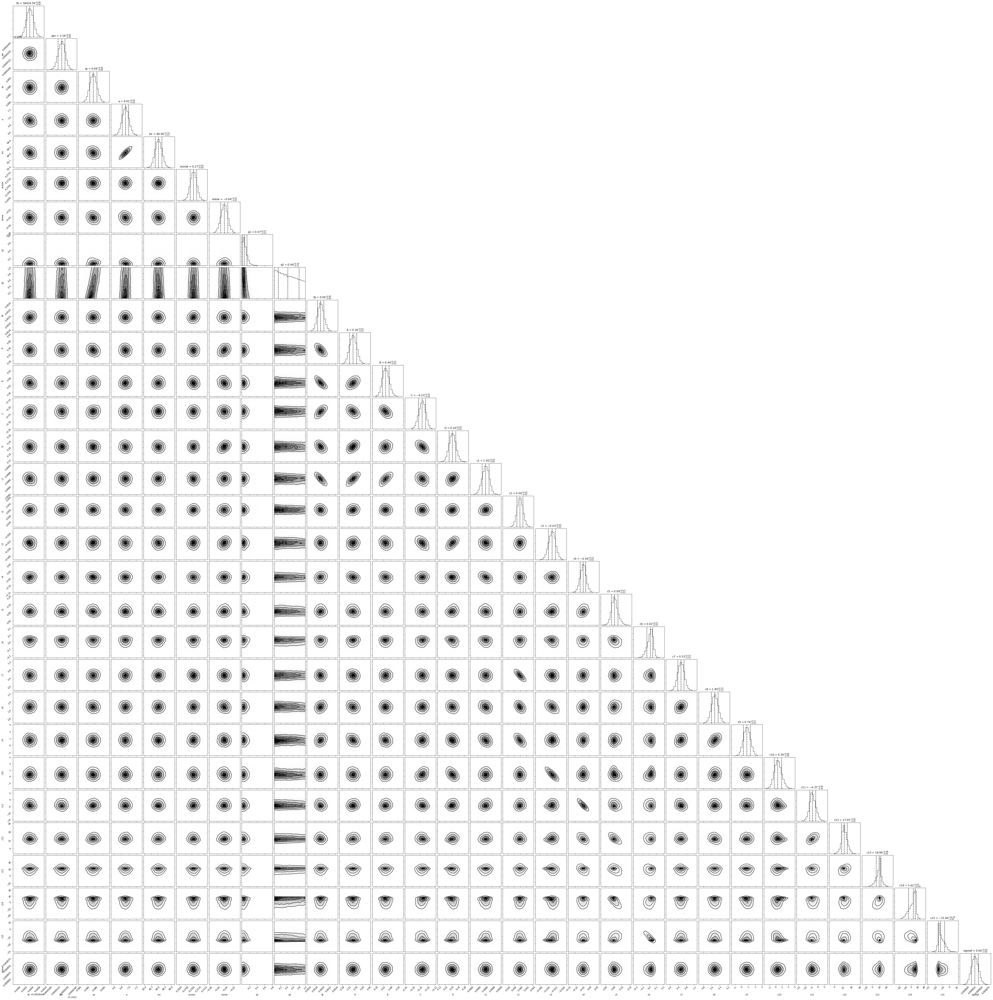

In [217]:
fig = corner.corner(samples, labels=p0_name, quantiles=[0.16, 0.5, 0.84], show_titles=True, 
                    title_kwargs={"fontsize": 12}, plot_datapoints=False)

pathplot4 = save_poly4_v2 + '04_Corner_plot.pdf'
fig.savefig(pathplot4, bbox_inches='tight')

In [218]:
# converting esinw and ecosw
e_chain = np.sqrt(samples[:,5]**2 + samples[:,6]**2)
w_chain = np.rad2deg(np.arctan(samples[:,6]/samples[:,5])) +360

# find a smart way to implement this
'''if (ecosw <= 0):
    w = np.arctan(esinw/ecosw) + np.pi                          # this is in radians!!
else:
    w = np.arctan(esinw/ecosw)'''

# getting u1 and u2 from Kipping (2013) parametrization q1 and q2 
u1_chain = 2*np.sqrt(samples[:,7]**2)*samples[:,8]
u2_chain = np.sqrt(samples[:,7]**2)*(1-2*samples[:,8])

# getting bin-delimitation
binse  = np.linspace(np.min(e_chain), np.max(e_chain), 20)
binsw  = np.linspace(np.min(w_chain), np.max(w_chain), 20)
binsu1 = np.linspace(np.min(u1_chain), np.max(u1_chain), 20)
binsu2 = np.linspace(np.min(u2_chain), np.max(u2_chain), 20)

# derived quantities
v = np.percentile(e_chain, [16, 50, 84])
e_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(w_chain, [16, 50, 84])
w_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(u1_chain, [16, 50, 84])
u1_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(u2_chain, [16, 50, 84])
u2_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

p0_name2      = ['ecc', 'w', 'u1', 'u2']
MCMC_Results2 = [e_mcmc, w_mcmc, u1_mcmc, u2_mcmc]

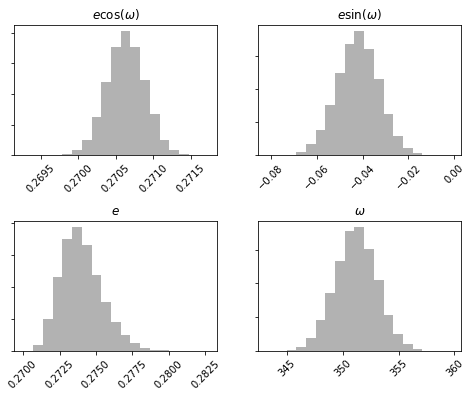

In [219]:
# Plotting Eccentricity and Longitude of Periastron 
fig, axes = plt.subplots(ncols = 2, nrows = 2, figsize = (8,6))
axes[0,0].hist(samples[:,5], bins=np.linspace(np.min(samples[:,5]), np.max(samples[:,5]), 20), color='k', alpha=0.3)
axes[0,1].hist(samples[:,6], bins=np.linspace(np.min(samples[:,6]), np.max(samples[:,6]), 20), color='k', alpha=0.3)
axes[1,0].hist(e_chain, binse, color='k', alpha=0.3)
axes[1,1].hist(w_chain, binsw, color='k', alpha=0.3)

plt.setp(axes[0,0].get_yticklabels(), visible=False)
plt.setp(axes[0,1].get_yticklabels(), visible=False)
plt.setp(axes[1,0].get_yticklabels(), visible=False)
plt.setp(axes[1,1].get_yticklabels(), visible=False)

plt.setp(axes[0,0].get_xticklabels(), rotation = 45)
plt.setp(axes[0,1].get_xticklabels(), rotation = 45)
plt.setp(axes[1,0].get_xticklabels(), rotation = 45)
plt.setp(axes[1,1].get_xticklabels(), rotation = 45)

axes[0,0].set_title('$e \cos (\omega)$', fontsize=12)
axes[0,1].set_title('$e \sin (\omega)$', fontsize=12)
axes[1,0].set_title('$e$', fontsize=12)
axes[1,1].set_title('$\omega$', fontsize=12)

fig.subplots_adjust(hspace=0.5)
fig.subplots_adjust(wspace=0.2)
pathplot5 = save_poly4_v2 + '05_Ecc_Omega.pdf'
fig.savefig(pathplot5, bbox_inches='tight')

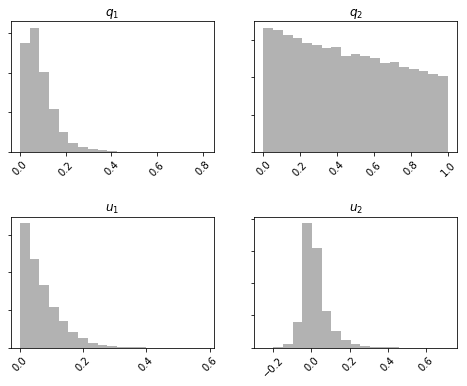

In [220]:
#Limb Darkening Coefficient

fig, axes = plt.subplots(ncols = 2, nrows = 2, figsize = (8,6))
axes[0,0].hist(samples[:,7], bins=np.linspace(np.min(samples[:,7]), np.max(samples[:,7]), 20), color='k', alpha=0.3)
axes[0,1].hist(samples[:,8], bins=np.linspace(np.min(samples[:,8]), np.max(samples[:,8]), 20), color='k', alpha=0.3)
axes[1,0].hist(u1_chain, binsu1, color='k', alpha=0.3)
axes[1,1].hist(u2_chain, binsu2, color='k', alpha=0.3)

plt.setp(axes[0,0].get_yticklabels(), visible=False)
plt.setp(axes[0,1].get_yticklabels(), visible=False)
plt.setp(axes[1,0].get_yticklabels(), visible=False)
plt.setp(axes[1,1].get_yticklabels(), visible=False)

plt.setp(axes[0,0].get_xticklabels(), rotation = 45)
plt.setp(axes[0,1].get_xticklabels(), rotation = 45)
plt.setp(axes[1,0].get_xticklabels(), rotation = 45)
plt.setp(axes[1,1].get_xticklabels(), rotation = 45)

axes[0,0].set_title('$q_1$', fontsize=12)
axes[0,1].set_title('$q_2$', fontsize=12)
axes[1,0].set_title('$u_1$', fontsize=12)
axes[1,1].set_title('$u_2$', fontsize=12)

fig.subplots_adjust(hspace=0.5)
fig.subplots_adjust(wspace=0.2)
fig.subplots_adjust(wspace=0.2)
pathplot6 = save_poly4_v2 + '06_Limb_Dark.pdf'
fig.savefig(pathplot6, bbox_inches='tight')

In [221]:
# determining in-eclipse and in-transit index

# generating transit model
trans, tsect, anomaly = models_fit.transit_model(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], 
                                                 a_mcmc[0], inc_mcmc[0], np.median(e_chain), 
                                                 np.median(np.deg2rad(w_chain)), 
                                                 np.median(u1_chain), np.median(u2_chain))
# generating secondary eclipses model
eclip = models_fit.eclipse(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], inc_mcmc[0], 
                           np.median(e_chain), np.median(np.deg2rad(w_chain)), np.median(u1_chain), np.median(u2_chain), 
                           fp_mcmc[0], tsect)

# get in-transit indices
ind_trans  = np.where(trans!=1)
# get in-eclipse indices
ind_eclip  = np.where((eclip!=(1+fp_mcmc[0])))
# seperating first and second eclipse
ind_ecli1 = ind_eclip[0][np.where(ind_eclip[0]<int(len(time)/2))]
ind_ecli2 = ind_eclip[0][np.where(ind_eclip[0]>int(len(time)/2))]

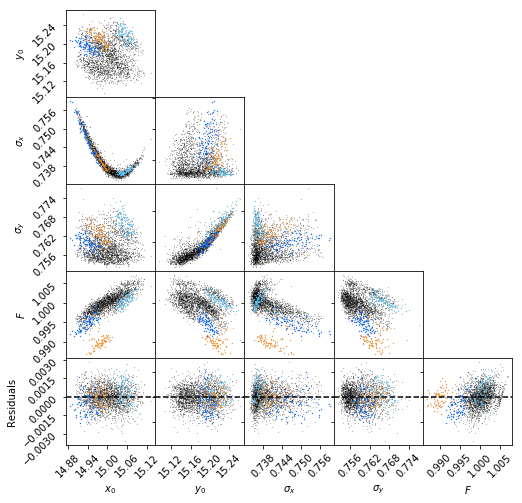

In [222]:
residual = flux/mcmc_detect - mcmc_pcurve

data1 = [xdata, ydata, psfxw, psfyw, flux, residual]
data2 = [xdata[ind_ecli1], ydata[ind_ecli1], psfxw[ind_ecli1], psfyw[ind_ecli1], flux[ind_ecli1], residual[ind_ecli1]]
data3 = [xdata[ind_trans], ydata[ind_trans], psfxw[ind_trans], psfyw[ind_trans], flux[ind_trans], residual[ind_trans]]
data4 = [xdata[ind_ecli2], ydata[ind_ecli2], psfxw[ind_ecli2], psfyw[ind_ecli2], flux[ind_ecli2], residual[ind_ecli2]]
label = ['$x_0$', '$y_0$', '$\sigma _x$', '$\sigma _y$', '$F$', 'Residuals']

#models_fit.
models_fit.triangle_colors(data1, data2, data3, data4, label)
pathplot7 = save_poly4_v2 + '07_PSF_Diagnostics.pdf'
fig.savefig(pathplot7, bbox_inches='tight')

In [223]:
ResultMCMC_Params = Table()

for i in range(len(p0_name)):
    ResultMCMC_Params[p0_name[i]] = MCMC_Results[i]
    
for i in range(len(p0_name2)):
    ResultMCMC_Params[p0_name2[i]] = MCMC_Results2[i]
    
for i in range(len(gfit_name)):
    ResultMCMC_Params[gfit_name[i]] = gfit_bin[i]

for i in range(len(gfit_name)):
    ResultMCMC_Params[gfit_name2[i]] = gfit_full[i]
    
pathresu = save_poly4_v2 + '/mcmc_results.npy'
np.save(pathresu, ResultMCMC_Params)

In [184]:
plt.close('all')
sampler.reset()

# Polynomial order 5; Phase Variation order 1

In [224]:
save_poly5_v1  = save_path + 'poly5_v1/'            # location where outputs will be saved
if not os.path.exists(save_poly5_v1): os.makedirs(save_poly5_v1)

print('Do you want to start with mcmc output from previous fit?(y/n)')
guess = input()

if (guess=='n'):
    C    = 0.001
    D    = 0.0
    
else:
    guesspath = save_poly4_v1 + 'mcmc_results.npy'
    R = np.load(guesspath)
    t0   = R['t0'][0]
    per  = R['per'][0]
    rp   = R['rp'][0]
    a    = R['a'][0]
    inc  = R['inc'][0]             
    ecosw= R['ecosw'][0]
    esinw= R['esinw'][0]
    q1   = R['q1'][0]
    q2   = R['q2'][0]
    fp   = R['fp'][0]

    # Phase Variation Parameters (2 params)
    A    = R['A'][0]
    B    = R['B'][0]
    C    = 0.0
    D    = 0.0
    
    # Phase Variation Parameters (2 params)
    c1   = R['c1'][0]
    c2   = R['c2'][0]
    c3   = R['c3'][0]
    c4   = R['c4'][0]
    c5   = R['c5'][0]
    c6   = R['c6'][0]
    c7   = R['c7'][0]
    c8   = R['c8'][0]
    c9   = R['c9'][0]
    c10  = R['c10'][0]
    c11  = R['c11'][0]
    c12  = R['c12'][0]
    c13  = R['c13'][0]
    c14  = R['c14'][0]
    c15  = R['c15'][0]
    c16  = 0.0
    c17  = 0.0
    c18  = 0.0
    c19  = 0.0
    c20  = 0.0
    c21  = 0.0

    # pre-calculation
    mid_x = np.mean(xdata)
    mid_y = np.mean(ydata)

    # photometric scatter
    sigmaf = R['sigmaf'][0]

Do you want to start with mcmc output from previous fit?(y/n)
y


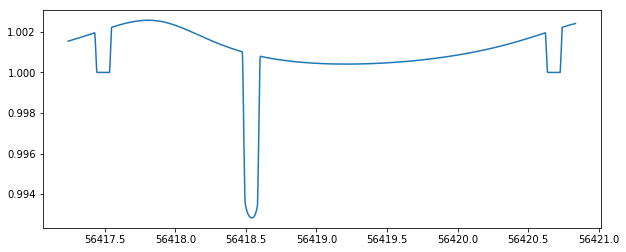

In [225]:
# calculate Initial guess for detector coefficients
astro = models_fit.phase_curve(time, t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B)
resid = flux/astro

plt.figure(figsize=(10,4))
plt.plot(time, astro)


p0 = np.array([c1, c2, c3, c4, c5, c6, c7, c8, c9, c10, c11, c12, c13, c14, c15, c16, c17, c18, c19, c20, c21])

popt, pcov = scipy.optimize.curve_fit(models_fit.detec_poly, (xdata, ydata, mid_x, mid_y), resid, p0)c1, c2, c3, c4, c5, c6, c7, c8, c9, c10, c11, c12, c13, c14, c15, c16, c17, c18, c19, c20, c21 = popt
detect = models_fit.detec_poly((xdata, ydata, mid_x, mid_y), c1, c2, c3, c4, c5, c6, 
                               c7, c8, c9, c10, c11, c12, c13, c14, c15, c16, c17, c18, c19, c20, c21)

fig, axes =plt.subplots(nrows=2, ncols=1, sharex=True, figsize=(10,6))
axes[0].plot(time,flux, '.', label = 'Data')
#axes[0].plot(time, resid, '.')
axes[0].plot(time, detect*astro, '.', label = 'Initial Guess')
axes[0].legend()
axes[0].set_ylabel('Relative Flux')

axes[1].plot(time, flux-detect*astro, '.')
axes[1].axhline(y=0, color='k', linewidth=2)
axes[1].set_xlabel('Time (BMJD)')
axes[1].set_ylabel('Residual Flux')

fig.subplots_adjust(hspace=0)

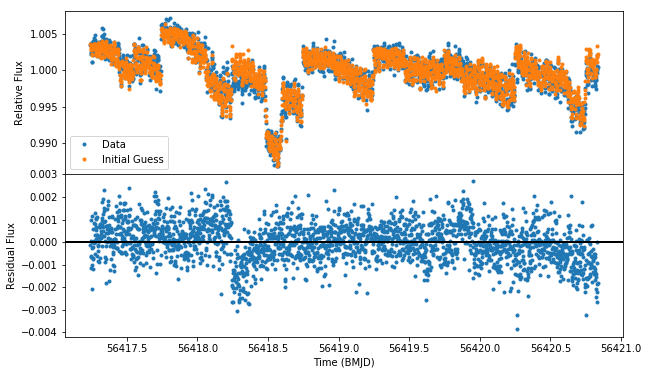

In [226]:
c1, c2, c3, c4, c5, c6, c7, c8, c9, c10, c11, c12, c13, c14, c15, c16, c17, c18, c19, c20, c21 = popt
detect = models_fit.detec_poly((xdata, ydata, mid_x, mid_y), c1, c2, c3, c4, c5, c6, 
                               c7, c8, c9, c10, c11, c12, c13, c14, c15, c16, c17, c18, c19, c20, c21)

fig, axes =plt.subplots(nrows=2, ncols=1, sharex=True, figsize=(10,6))
axes[0].plot(time,flux, '.', label = 'Data')
#axes[0].plot(time, resid, '.')
axes[0].plot(time, detect*astro, '.', label = 'Initial Guess')
axes[0].legend()
axes[0].set_ylabel('Relative Flux')

axes[1].plot(time, flux-detect*astro, '.')
axes[1].axhline(y=0, color='k', linewidth=2)
axes[1].set_xlabel('Time (BMJD)')
axes[1].set_ylabel('Residual Flux')

fig.subplots_adjust(hspace=0)

In [227]:
#Log likelihood function
def lnlike(p0, time, flux, xdata, ydata, mid_x, mid_y):
    # unpack p0
    t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, c1, c2, c3, c4, \
    c5, c6, c7, c8, c9, c10, c11, c12, c13, c14, c15, c16, c17, c18, c19, c20, c21, flux_err = p0
    # define model
    model = models_fit.signal_poly(time, per, t0, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, 
                   xdata, ydata, mid_x, mid_y, c1, c2, c3, c4, c5, c6, c7, c8, c9, c10, 
                                   c11, c12, c13, c14, c15, c16, c17, c18, c19, c20, c21)
    inv_sigma2 = 1.0/(flux_err**2)
    return -0.5*(np.sum((flux-model)**2*inv_sigma2) - len(flux)*np.log(inv_sigma2))

# Probability distribution to draw sample from
def lnprior(p0):
    t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, c1, c2, c3, c4, \
    c5, c6, c7, c8, c9, c10, c11, c12, c13, c14, c15, c16, c17, c18, c19, c20, c21, flux_err = p0
    # gaussian prior for per
    lgpri_per = -0.5*(((per - 3.1915325)/0.0000006)**2.0)
    # gaussian prior for a
    lgpri_a = -0.5*(((a - 7.07)/0.31)**2.0)
    # gaussian prior for i
    lgpri_i = -0.5*(((inc - 84.11)/0.16)**2.0)
    # gaussian prior for ecosw
    lgpri_ecosw = -0.5*(((ecosw - 0.27005)/0.00026)**2.0)
    # gaussian prior for esinw
    lgpri_esinw = -0.5*(((esinw +  0.0612)/0.0083)**2.0)
    # uniform prior for the rest
    if (56418.4 < t0 < 56418.6 and 0 < rp < 1  and 0 < fp < 1 and 
        0 < q1 < 1 and 0 < q2 < 1):
        return 0.0 + lgpri_a + lgpri_i + lgpri_ecosw + lgpri_esinw + lgpri_per
    return -np.inf

# Total probability function
def lnprob(p0, time, flux, xdata, ydata, mid_x, mid_y):
    lp = lnprior(p0)
    if not np.isfinite(lp):
        return -np.inf
    return lp + lnlike(p0, time, flux, xdata, ydata, mid_x, mid_y)

In [228]:
# Getting ready for MCMC

p0 = np.array([t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, c1, c2, c3,
               c4, c5, c6, c7, c8, c9, c10, c11, c12, c13, c14, c15, c16, c17, c18, c19, c20, c21, sigmaf])

# total nb steps
totalsteps = 0
# instruction for sampling
ndim, nwalkers, nstep = len(p0), 500, 3000
# get scattered starting point in parameter space 
pos = [p0 + 10**(-5)*np.random.randn(ndim) for i in range(nwalkers)]

#sampler
sampler = emcee.EnsembleSampler(nwalkers, ndim, lnprob, 
                                args=(time, flux, xdata, ydata, mid_x, mid_y))

In [246]:
print('Do you want to run an mcmc or load mcmc results? (run/load)')
answer = input()

if (answer=='run'):
    print('Is this your first run? (y/n)')
    answer2 = input()
    if (answer2=='y'):
        # Running MCMC
        print("Running MCMC...")
        tic = t.clock()
        pos, lnprob, state = sampler.run_mcmc(pos, nstep)
        toc = t.clock()
        print("Done.") 
        print("time taken: ")
        print(toc - tic)
        totalsteps += nstep
    else: # continue the chain
        sampler.reset()
        print("Running MCMC...")
        tic = t.clock()
        pos, lnprob, state = sampler.run_mcmc(pos, nstep, rstate0=state)
        toc = t.clock()
        print("Done.") 
        print("time taken: ")
        print(toc - tic)
        totalsteps += nstep

Do you want to run an mcmc or load mcmc results? (run/load)
run
Is this your first run? (y/n)
n
Running MCMC...
Done.
time taken: 
12501.65921829571


In [247]:
np.median(sampler.acceptance_fraction)

0.21066666666666667

In [248]:
# Path names 
pathchain = save_poly5_v1 + 'samplerchainpoly5.npy'
pathposit = save_poly5_v1 + 'samplerposi_poly5.npy'
pathstate = save_poly5_v1 + 'samplerstatepoly5.npy'
pathlnpro = save_poly5_v1 + 'samplerlnpropoly5.npy'

# move path
movechain = save_poly5_v1 + 'old_chain/samplerchainpoly5.npy'
moveposit = save_poly5_v1 + 'old_chain/samplerposi_poly5.npy'
movestate = save_poly5_v1 + 'old_chain/samplerstatepoly5.npy'
movelnpro = save_poly5_v1 + 'old_chain/samplerlnpropoly5.npy'

# make old_chain directory
old_chain = save_poly5_v1 + 'old_chain'
if not os.path.exists(old_chain): os.makedirs(old_chain)

# save MCMC run data
if(answer=='run'):
    samplechain = sampler.chain[:,-2000:,:]
    if not os.path.exists(pathchain): 
        np.save(pathchain, sampler.chain[:,-2000:,:])
    else: 
        
        os.rename(pathchain, movechain)
        np.save(pathchain, sampler.chain[:,-2000:,:])
    if not os.path.exists(pathposit): 
        np.save(pathposit, pos)
    else: 
        os.rename(pathposit, moveposit)
        np.save(pathposit, pos)
    if not os.path.exists(pathstate): np.save(pathstate, state[0])
    else: 
        os.rename(pathstate, movestate)
        np.save(pathstate, state[0])
    if not os.path.exists(pathlnpro): np.save(pathlnpro, lnprob)
    else: 
        os.rename(pathlnpro, movelnpro)
        np.save(pathlnpro, lnprob)
            
elif(answer=='load'):
    samplechain = np.load(pathchain)
    pos         = np.load(pathposit)
    state       = np.load(pathstate)
    lnprob      = np.load(pathlnpro)
else:
    print('Error: Invalid answer')

In [ ]:
# come back here after you see you corner plot and decide to remove outlier chain
print('Did you see you corner plot already? (y/n)')
answer3 = input()

if (answer3=='y'):
    # if you want to delete the outlier chains
    chain_med  = np.median(samplechain[:,:,0], axis=1)               # [all walkers, all steps, param0=t0]
    clip_index = np.where(np.fabs(chain_med-np.median(chain_med))>3*np.std(chain_med))
    
    # delete bad chains
    samplechain = np.delete(samplechain, clip_index, axis=0)
    pos    = np.delete(pos, clip_index, axis=0) 
    lnprob = np.delete(lnprob, clip_index)
    
    # save new chains
    np.save(pathchain, samplechain)
    np.save(pathposit, pos)
    np.save(pathlnpro, lnprob)

In [249]:
# print the results
samples = samplechain.reshape((-1, ndim))

p0_name = np.array(['t0', 'per', 'rp', 'a', 'inc', 'ecosw', 'esinw', 'q1', 'q2', 'fp', 
                    'A', 'B', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 'c9', 'c10', 
                    'c11', 'c12', 'c13', 'c14', 'c15', 'c16', 'c17', 'c18', 'c19', 'c20', 'c21', 'sigmaf'])

(MCMC_Results) = list(map(lambda v: (v[1], v[2]-v[1], v[1]-v[0]), zip(*np.percentile(samples, [16, 50, 84],axis=0))))

t0_mcmc, per_mcmc, rp_mcmc, a_mcmc, inc_mcmc, ecosw_mcmc, \
esinw_mcmc, q1_mcmc, q2_mcmc, fp_mcmc, A_mcmc, B_mcmc, \
c1_mcmc, c2_mcmc, c3_mcmc, c4_mcmc, c5_mcmc, c6_mcmc, c7_mcmc, \
c8_mcmc, c9_mcmc, c10_mcmc, c11_mcmc, c12_mcmc, c13_mcmc, c14_mcmc, \
c15_mcmc, c16_mcmc, c17_mcmc, c18_mcmc, c19_mcmc, c20_mcmc, c21_mcmc, sigmaf_mcmc = MCMC_Results

for i in range(len(p0)):
    line_new = '{:>8} = {:>16}  +{:>16}  -{:>16}'.format(p0_name[i],MCMC_Results[i][0], MCMC_Results[i][1], MCMC_Results[i][2])
    print(line_new)

      t0 = 56418.53990254756  +0.00042312563891755417  -0.00043374698725529015
     per = 3.1915324949865727  +5.972316410307599e-07  -6.018608469382514e-07
      rp = 0.0890462042147661  +0.0009405944246365094  -0.0008617907117158957
       a = 6.895881794436477  +0.0878527135868854  -0.08953430054053424
     inc = 84.06639621539667  +0.15119080982948674  -0.1525008227453526
   ecosw = 0.2704984587411823  +0.00023838324331154626  -0.0002418772624305232
   esinw = -0.06719820604278029  +0.008372586158924028  -0.00802855567451076
      q1 = 0.07168851641107749  +0.06931452926355763  -0.043792521976753374
      q2 = 0.4511730737280531  +0.35697668953691647  -0.3143768103344223
      fp = 0.0021119988300860237  +8.9263391856346e-05  -9.44726183866409e-05
       A = 0.2728009398349005  +0.017696353644478635  -0.017052448382714802
       B = 0.4253104942045284  +0.025592128832490346  -0.023819649240866658
      c1 = 0.998848681133886  +9.881413303736153e-05  -9.849432863262564e-05
      c2 

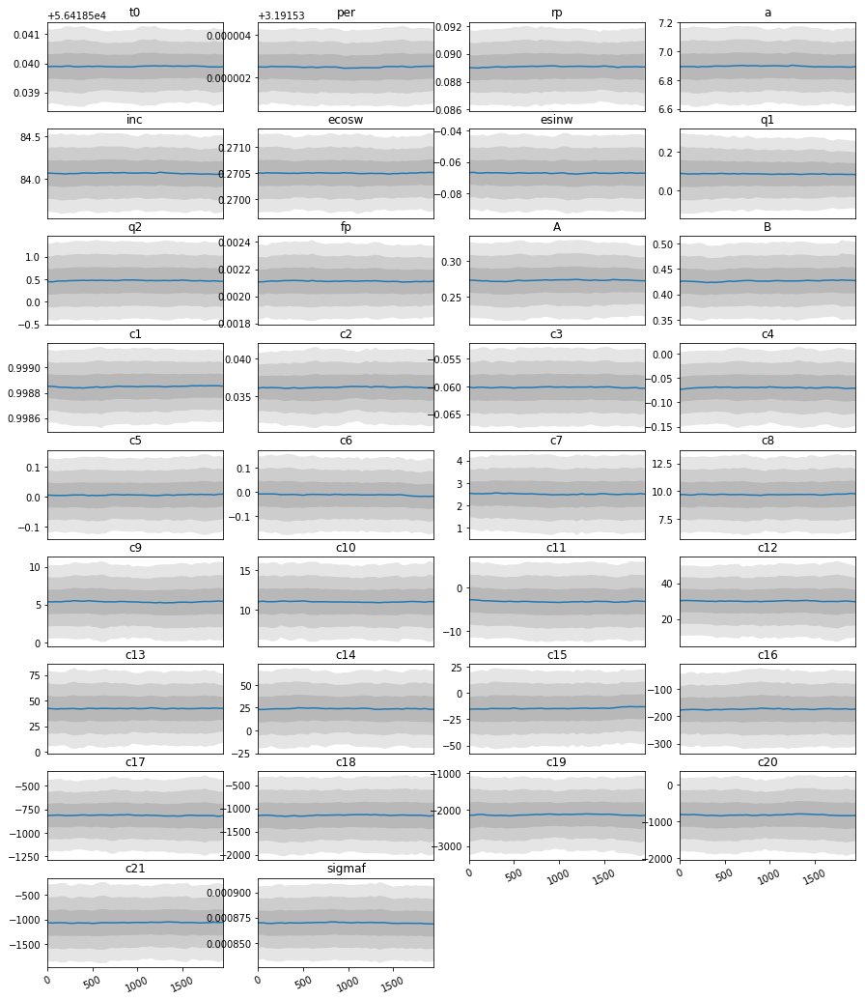

In [250]:
# see if the mcmc has converged
models_fit.walk_style(len(p0), nwalkers, samplechain, 50, 2000, p0_name)

pathplot2 = save_poly5_v1 + '02_Convergence_Criterion.pdf'
plt.savefig(pathplot2, bbox_inches='tight')

In [251]:
mcmc_detect = models_fit.detec_poly((xdata, ydata, mid_x, mid_y), c1_mcmc[0], c2_mcmc[0], 
                                     c3_mcmc[0], c4_mcmc[0], c5_mcmc[0], c6_mcmc[0], c7_mcmc[0], 
                                    c8_mcmc[0], c9_mcmc[0], c10_mcmc[0], c11_mcmc[0], c12_mcmc[0], 
                                    c13_mcmc[0], c14_mcmc[0], c15_mcmc[0], c16_mcmc[0], c17_mcmc[0], c18_mcmc[0], 
                                    c19_mcmc[0], c20_mcmc[0], c21_mcmc[0])

mcmc_pcurve = models_fit.phase_curve(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], 
                                     inc_mcmc[0], ecosw_mcmc[0], esinw_mcmc[0], q1_mcmc[0], 
                                     q2_mcmc[0], fp_mcmc[0], A_mcmc[0], B_mcmc[0])

orb_phase = (time-t0_mcmc[0])/per_mcmc[0]

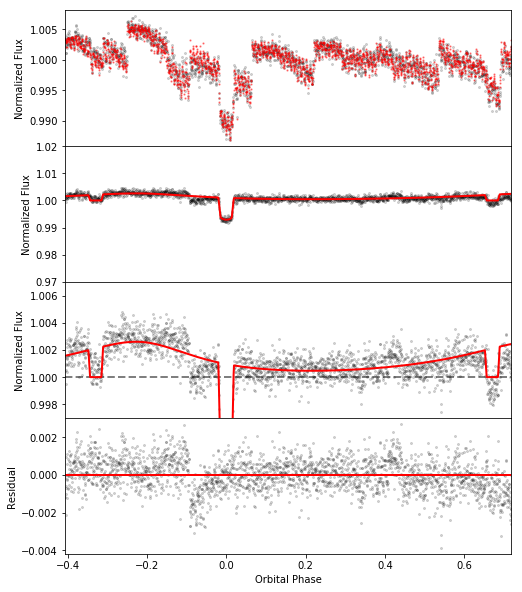

In [252]:
fig, axes = plt.subplots(ncols = 1, nrows = 4, sharex = True, figsize=(8, 10))

axes[0].set_xlim(np.min(orb_phase), np.max(orb_phase))
axes[0].plot(orb_phase, flux, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[0].plot(orb_phase, mcmc_pcurve*mcmc_detect, '.', color = 'r', markersize = 2.5, alpha = 0.4)
#axes[0].set_yticks(np.arange(0.97, 1.03, 0.01))
axes[0].set_ylabel('Normalized Flux')

axes[1].plot(orb_phase, flux/mcmc_detect, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[1].plot(orb_phase, mcmc_pcurve, color = 'r', linewidth=2)
axes[1].set_yticks(np.arange(0.97, 1.02, 0.01))
axes[1].set_ylabel('Normalized Flux')

axes[2].axhline(y=1, color='k', linewidth = 2, linestyle='dashed', alpha = 0.5)
axes[2].plot(orb_phase, flux/mcmc_detect, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[2].plot(orb_phase, mcmc_pcurve, color = 'r', linewidth=2)
axes[2].set_yticks(np.arange(0.998, 1.007, 0.002))
axes[2].set_ylabel('Normalized Flux')
axes[2].set_ylim(0.997, 1.007)

axes[3].plot(orb_phase, flux/mcmc_detect - mcmc_pcurve, 'k.', markersize = 4, alpha = 0.15)
axes[3].axhline(y=0, color='r', linewidth = 2)
axes[3].set_ylabel('Residual')
axes[3].set_xlabel('Orbital Phase')

fig.subplots_adjust(hspace=0)

pathplot3 = save_poly5_v1 + '03_Fit.pdf'
fig.savefig(pathplot3, bbox_inches='tight')

In [253]:
data     = (flux/mcmc_detect)
fit      = mcmc_pcurve
ferr_fit = np.ones(len(flux))*sigmaf_mcmc[0]

# chi-square
chi_bin  = models_fit.get_chi2(data, fit, ferr_fit)
print('chi^2:', chi_bin)
# loglikelihood
logL_bin = models_fit.get_lnlike(data, fit, ferr_fit)
print('Lnlike: ', logL_bin)
# get Bayesian Information Criterion
BIC_bin  = models_fit.get_BIC(logL_bin, ndim, len(data))
print('BIC: ', BIC_bin)

gfit_name = ['chi2-bin', 'lnlike-bin', 'BIC-bin']
gfit_bin = [chi_bin, logL_bin, BIC_bin]

chi^2: 2363.28893421
Lnlike:  15640.4319841
BIC:  -31016.4190188


In [254]:
# getting goodness of fit on full dataset

FULL_detect = models_fit.detec_poly((XDATA, YDATA, mid_x, mid_y), c1_mcmc[0], c2_mcmc[0], 
                                     c3_mcmc[0], c4_mcmc[0], c5_mcmc[0], c6_mcmc[0], c7_mcmc[0], 
                                    c8_mcmc[0], c9_mcmc[0], c10_mcmc[0], c11_mcmc[0], c12_mcmc[0], 
                                    c13_mcmc[0], c14_mcmc[0], c15_mcmc[0], c16_mcmc[0], c17_mcmc[0], 
                                    c18_mcmc[0], c19_mcmc[0], c20_mcmc[0], c21_mcmc[0])

FULL_detect = np.ma.masked_array(FULL_detect, mask=(XDATA_clip.mask+YDATA_clip.mask))

FULL_pcurve = models_fit.phase_curve(TIME, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], 
                                     inc_mcmc[0], ecosw_mcmc[0], esinw_mcmc[0], q1_mcmc[0], 
                                     q2_mcmc[0], fp_mcmc[0], A_mcmc[0], B_mcmc[0])

FULL_data = (FLUX_clip/FULL_detect)
FULL_fit  = FULL_pcurve
FULL_ferr = np.ones(len(FLUX))*sigmaf_mcmc[0]*np.sqrt(63)

# chi-square
chi_FULL  = models_fit.get_chi2(FULL_data, FULL_fit, FULL_ferr)
print('chi^2:', chi_FULL)
# loglikelihood
logL_FULL = models_fit.get_lnlike(FULL_data, FULL_fit, FULL_ferr)
print('Lnlike: ', logL_FULL)
# get Bayesian Information Criterion
BIC_FULL  = models_fit.get_BIC(logL_FULL, ndim, len(FULL_data))
print('BIC: ', BIC_FULL)

gfit_name2 = ['chi2-full', 'lnlike-full', 'BIC-full']
gfit_full  = [chi_FULL, logL_FULL, BIC_FULL]

chi^2: 57424.8265478
Lnlike:  728256.085854
BIC:  -1456106.31049


In [255]:
# getting goodness of fit on full dataset

FULL_detect = models_fit.detec_poly((XDATA, YDATA, mid_x, mid_y), c1_mcmc[0], c2_mcmc[0], 
                                     c3_mcmc[0], c4_mcmc[0], c5_mcmc[0], c6_mcmc[0], c7_mcmc[0], 
                                    c8_mcmc[0], c9_mcmc[0], c10_mcmc[0], c11_mcmc[0], c12_mcmc[0], 
                                    c13_mcmc[0], c14_mcmc[0], c15_mcmc[0], c16_mcmc[0], c17_mcmc[0], 
                                    c18_mcmc[0], c19_mcmc[0], c20_mcmc[0], c21_mcmc[0])

FULL_detect = np.ma.masked_array(FULL_detect, mask=(XDATA_clip.mask+YDATA_clip.mask))

FULL_pcurve = models_fit.phase_curve(TIME, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], 
                                     inc_mcmc[0], ecosw_mcmc[0], esinw_mcmc[0], q1_mcmc[0], 
                                     q2_mcmc[0], fp_mcmc[0], A_mcmc[0], B_mcmc[0])

FULL_data = (FLUX_clip/FULL_detect)
FULL_fit  = FULL_pcurve
FULL_ferr = np.ones(len(FLUX))*sigmaf_mcmc[0]*np.sqrt(63)

# chi-square
chi_FULL  = models_fit.get_chi2(FULL_data, FULL_fit, FULL_ferr)
print('chi^2:', chi_FULL)
# loglikelihood
logL_FULL = models_fit.get_lnlike(FULL_data, FULL_fit, FULL_ferr)
print('Lnlike: ', logL_FULL)
# get Bayesian Information Criterion
BIC_FULL  = models_fit.get_BIC(logL_FULL, ndim, len(FULL_data))
print('BIC: ', BIC_FULL)

gfit_name2 = ['chi2-full', 'lnlike-full', 'BIC-full']
gfit_full  = [chi_FULL, logL_FULL, BIC_FULL]

chi^2: 57424.8265478
Lnlike:  728256.085854
BIC:  -1456106.31049


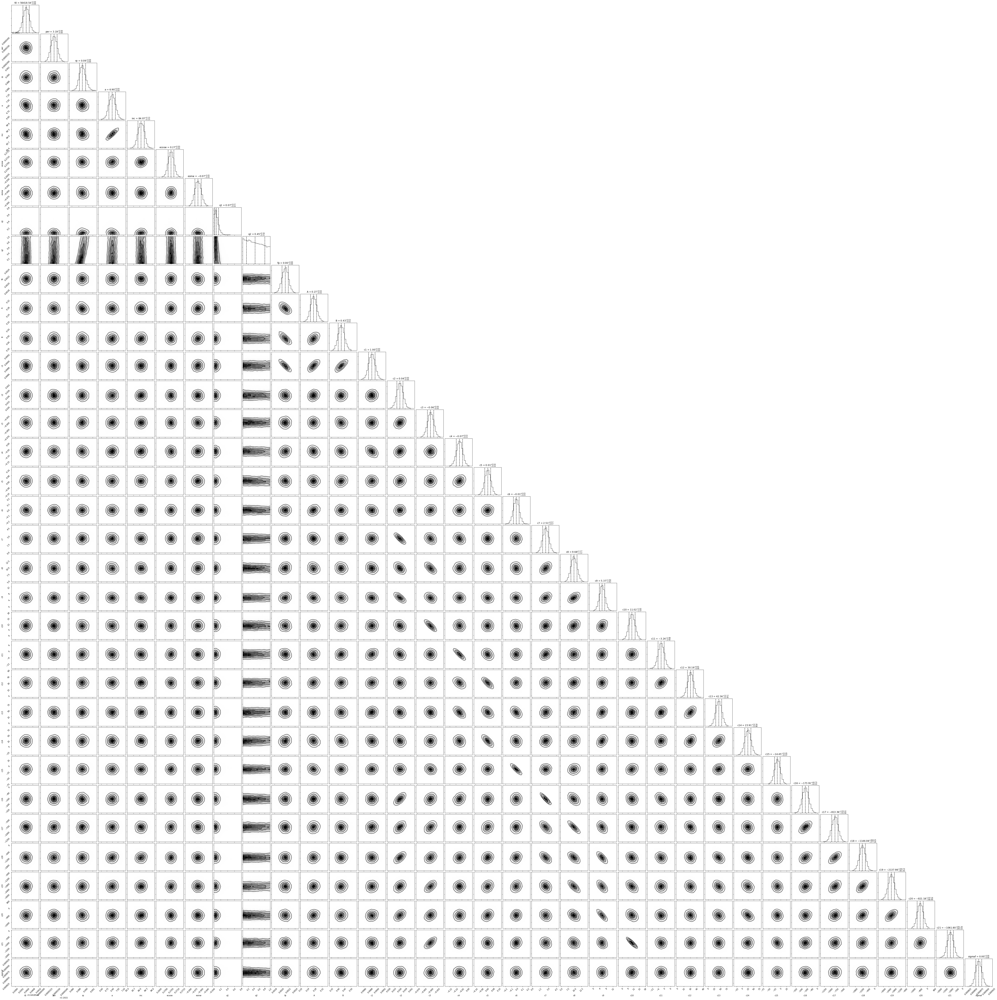

In [256]:
fig = corner.corner(samples, labels=p0_name, quantiles=[0.16, 0.5, 0.84], show_titles=True, 
                    title_kwargs={"fontsize": 12}, plot_datapoints=False)

pathplot4 = save_poly5_v1 + '04_Corner_plot.pdf'
fig.savefig(pathplot4, bbox_inches='tight')

In [257]:
# converting esinw and ecosw
e_chain = np.sqrt(samples[:,5]**2 + samples[:,6]**2)
w_chain = np.rad2deg(np.arctan(samples[:,6]/samples[:,5])) +360

# find a smart way to implement this
'''if (ecosw <= 0):
    w = np.arctan(esinw/ecosw) + np.pi                          # this is in radians!!
else:
    w = np.arctan(esinw/ecosw)'''

# getting u1 and u2 from Kipping (2013) parametrization q1 and q2 
u1_chain = 2*np.sqrt(samples[:,7]**2)*samples[:,8]
u2_chain = np.sqrt(samples[:,7]**2)*(1-2*samples[:,8])

# getting bin-delimitation
binse  = np.linspace(np.min(e_chain), np.max(e_chain), 20)
binsw  = np.linspace(np.min(w_chain), np.max(w_chain), 20)
binsu1 = np.linspace(np.min(u1_chain), np.max(u1_chain), 20)
binsu2 = np.linspace(np.min(u2_chain), np.max(u2_chain), 20)

# derived quantities
v = np.percentile(e_chain, [16, 50, 84])
e_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(w_chain, [16, 50, 84])
w_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(u1_chain, [16, 50, 84])
u1_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(u2_chain, [16, 50, 84])
u2_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

p0_name2      = ['ecc', 'w', 'u1', 'u2']
MCMC_Results2 = [e_mcmc, w_mcmc, u1_mcmc, u2_mcmc]

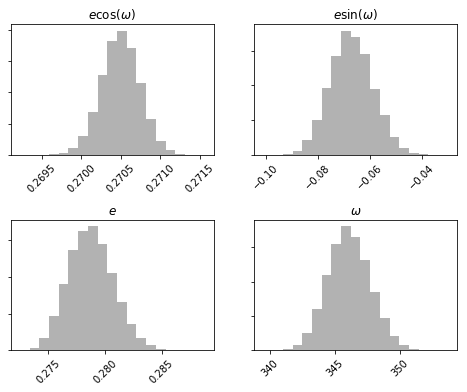

In [258]:
# Plotting Eccentricity and Longitude of Periastron 
fig, axes = plt.subplots(ncols = 2, nrows = 2, figsize = (8,6))
axes[0,0].hist(samples[:,5], bins=np.linspace(np.min(samples[:,5]), np.max(samples[:,5]), 20), color='k', alpha=0.3)
axes[0,1].hist(samples[:,6], bins=np.linspace(np.min(samples[:,6]), np.max(samples[:,6]), 20), color='k', alpha=0.3)
axes[1,0].hist(e_chain, binse, color='k', alpha=0.3)
axes[1,1].hist(w_chain, binsw, color='k', alpha=0.3)

plt.setp(axes[0,0].get_yticklabels(), visible=False)
plt.setp(axes[0,1].get_yticklabels(), visible=False)
plt.setp(axes[1,0].get_yticklabels(), visible=False)
plt.setp(axes[1,1].get_yticklabels(), visible=False)

plt.setp(axes[0,0].get_xticklabels(), rotation = 45)
plt.setp(axes[0,1].get_xticklabels(), rotation = 45)
plt.setp(axes[1,0].get_xticklabels(), rotation = 45)
plt.setp(axes[1,1].get_xticklabels(), rotation = 45)

axes[0,0].set_title('$e \cos (\omega)$', fontsize=12)
axes[0,1].set_title('$e \sin (\omega)$', fontsize=12)
axes[1,0].set_title('$e$', fontsize=12)
axes[1,1].set_title('$\omega$', fontsize=12)

fig.subplots_adjust(hspace=0.5)
fig.subplots_adjust(wspace=0.2)
pathplot5 = save_poly5_v1 + '05_Ecc_Omega.pdf'
fig.savefig(pathplot5, bbox_inches='tight')

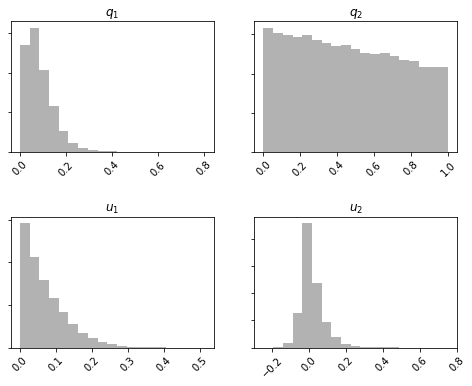

In [259]:
#Limb Darkening Coefficient

fig, axes = plt.subplots(ncols = 2, nrows = 2, figsize = (8,6))
axes[0,0].hist(samples[:,7], bins=np.linspace(np.min(samples[:,7]), np.max(samples[:,7]), 20), color='k', alpha=0.3)
axes[0,1].hist(samples[:,8], bins=np.linspace(np.min(samples[:,8]), np.max(samples[:,8]), 20), color='k', alpha=0.3)
axes[1,0].hist(u1_chain, binsu1, color='k', alpha=0.3)
axes[1,1].hist(u2_chain, binsu2, color='k', alpha=0.3)

plt.setp(axes[0,0].get_yticklabels(), visible=False)
plt.setp(axes[0,1].get_yticklabels(), visible=False)
plt.setp(axes[1,0].get_yticklabels(), visible=False)
plt.setp(axes[1,1].get_yticklabels(), visible=False)

plt.setp(axes[0,0].get_xticklabels(), rotation = 45)
plt.setp(axes[0,1].get_xticklabels(), rotation = 45)
plt.setp(axes[1,0].get_xticklabels(), rotation = 45)
plt.setp(axes[1,1].get_xticklabels(), rotation = 45)

axes[0,0].set_title('$q_1$', fontsize=12)
axes[0,1].set_title('$q_2$', fontsize=12)
axes[1,0].set_title('$u_1$', fontsize=12)
axes[1,1].set_title('$u_2$', fontsize=12)

fig.subplots_adjust(hspace=0.5)
fig.subplots_adjust(wspace=0.2)
fig.subplots_adjust(wspace=0.2)
pathplot6 = save_poly5_v1 + '06_Limb_Dark.pdf'
fig.savefig(pathplot6, bbox_inches='tight')

In [260]:
# determining in-eclipse and in-transit index

# generating transit model
trans, tsect, anomaly = models_fit.transit_model(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], 
                                                 a_mcmc[0], inc_mcmc[0], np.median(e_chain), 
                                                 np.median(np.deg2rad(w_chain)), 
                                                 np.median(u1_chain), np.median(u2_chain))
# generating secondary eclipses model
eclip = models_fit.eclipse(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], inc_mcmc[0], 
                           np.median(e_chain), np.median(np.deg2rad(w_chain)), np.median(u1_chain), np.median(u2_chain), 
                           fp_mcmc[0], tsect)

# get in-transit indices
ind_trans  = np.where(trans!=1)
# get in-eclipse indices
ind_eclip  = np.where((eclip!=(1+fp_mcmc[0])))
# seperating first and second eclipse
ind_ecli1 = ind_eclip[0][np.where(ind_eclip[0]<int(len(time)/2))]
ind_ecli2 = ind_eclip[0][np.where(ind_eclip[0]>int(len(time)/2))]

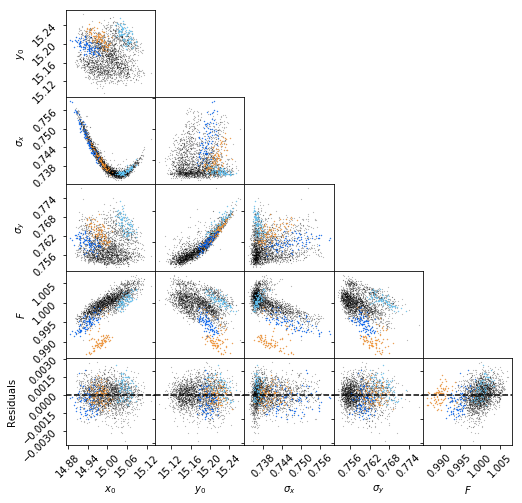

In [261]:
residual = flux/mcmc_detect - mcmc_pcurve

data1 = [xdata, ydata, psfxw, psfyw, flux, residual]
data2 = [xdata[ind_ecli1], ydata[ind_ecli1], psfxw[ind_ecli1], psfyw[ind_ecli1], flux[ind_ecli1], residual[ind_ecli1]]
data3 = [xdata[ind_trans], ydata[ind_trans], psfxw[ind_trans], psfyw[ind_trans], flux[ind_trans], residual[ind_trans]]
data4 = [xdata[ind_ecli2], ydata[ind_ecli2], psfxw[ind_ecli2], psfyw[ind_ecli2], flux[ind_ecli2], residual[ind_ecli2]]
label = ['$x_0$', '$y_0$', '$\sigma _x$', '$\sigma _y$', '$F$', 'Residuals']

models_fit.triangle_colors(data1, data2, data3, data4, label)
pathplot7 = save_poly5_v1 + '07_PSF_Diagnostics.pdf'
fig.savefig(pathplot7, bbox_inches='tight')

In [262]:
ResultMCMC_Params = Table()

for i in range(len(p0_name)):
    ResultMCMC_Params[p0_name[i]] = MCMC_Results[i]
    
for i in range(len(p0_name2)):
    ResultMCMC_Params[p0_name2[i]] = MCMC_Results2[i]
    
for i in range(len(gfit_name)):
    ResultMCMC_Params[gfit_name[i]] = gfit_bin[i]
    
for i in range(len(gfit_name)):
    ResultMCMC_Params[gfit_name2[i]] = gfit_full[i]
    
pathresu = save_poly5_v1 + '/mcmc_results.npy'
np.save(pathresu, ResultMCMC_Params)

In [263]:
plt.close('all')
sampler.reset()

# Polynomial order 5; Phase Variation order 2

In [264]:
save_poly5_v2  = save_path + 'poly5_v2/'            # location where outputs will be saved
if not os.path.exists(save_poly5_v2): os.makedirs(save_poly5_v2)

print('Do you want to start with mcmc output from previous fit?(y/n)')
guess = input()

if (guess=='n'):
    C    = 0.001
    D    = 0.0
    
else:
    guesspath = save_poly5_v1 + 'mcmc_results.npy'
    R = np.load(guesspath)
    t0   = R['t0'][0]
    per  = R['per'][0]
    rp   = R['rp'][0]
    a    = R['a'][0]
    inc  = R['inc'][0]             
    ecosw= R['ecosw'][0]
    esinw= R['esinw'][0]
    q1   = R['q1'][0]
    q2   = R['q2'][0]
    fp   = R['fp'][0]

    # Phase Variation Parameters (2 params)
    A    = R['A'][0]
    B    = R['B'][0]
    C    = 0.0
    D    = 0.0
    
    # Phase Variation Parameters (2 params)
    c1   = R['c1'][0]
    c2   = R['c2'][0]
    c3   = R['c3'][0]
    c4   = R['c4'][0]
    c5   = R['c5'][0]
    c6   = R['c6'][0]
    c7   = R['c7'][0]
    c8   = R['c8'][0]
    c9   = R['c9'][0]
    c10  = R['c10'][0]
    c11  = R['c11'][0]
    c12  = R['c12'][0]
    c13  = R['c13'][0]
    c14  = R['c14'][0]
    c15  = R['c15'][0]
    c16  = R['c16'][0]
    c17  = R['c17'][0]
    c18  = R['c18'][0]
    c19  = R['c19'][0]
    c20  = R['c20'][0]
    c21  = R['c21'][0]

    # pre-calculation
    mid_x = np.mean(xdata)
    mid_y = np.mean(ydata)

    # photometric scatter
    sigmaf = R['sigmaf'][0]

Do you want to start with mcmc output from previous fit?(y/n)
y


In [265]:
#Log likelihood function
def lnlike(p0, time, flux, xdata, ydata, mid_x, mid_y):
    # unpack p0
    t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, C, D, c1, c2, c3, c4, c5, c6, c7, c8, c9, c10, c11, c12, c13, c14, c15, c16, c17, c18, c19, c20, c21, sigmaf = p0
    # define model
    model = models_fit.signal_poly(time, per, t0, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, 
                   xdata, ydata, mid_x, mid_y, c1, c2, c3, c4, c5, c6, c7, c8, c9, c10, c11, c12, c13, c14, c15, c16, c17, c18, c19, c20, c21, C=C, D=D)
    inv_sigma2 = 1.0/(sigmaf**2)
    return -0.5*(np.sum((flux-model)**2*inv_sigma2) - len(flux)*np.log(inv_sigma2))

# Probability distribution to draw sample from
def lnprior(p0):
    t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, C, D, c1, c2, c3, c4, c5, c6, c7, c8, c9, c10, c11, c12, c13, c14, c15, c16, c17, c18, c19, c20, c21, sigmaf = p0
    # gaussian prior for per
    lgpri_per = -0.5*(((per - 3.1915325)/0.0000006)**2.0)
    # gaussian prior for a
    lgpri_a = -0.5*(((a - 7.07)/0.31)**2.0)
    # gaussian prior for i
    lgpri_i = -0.5*(((inc - 84.11)/0.16)**2.0)
    # gaussian prior for ecosw
    lgpri_ecosw = -0.5*(((ecosw - 0.27005)/0.00026)**2.0)
    # gaussian prior for esinw
    lgpri_esinw = -0.5*(((esinw +  0.0612)/0.0083)**2.0)
    # uniform prior for the rest
    if (56418.4 < t0 < 56418.6 and 0 < rp < 1  and 0 < fp < 1 and 
        0 < q1 < 1 and 0 < q2 < 1):
        return 0.0 + lgpri_a + lgpri_i + lgpri_ecosw + lgpri_esinw + lgpri_per
    return -np.inf

# Total probability function
def lnprob(p0, time, flux, xdata, ydata, mid_x, mid_y):
    lp = lnprior(p0)
    if not np.isfinite(lp):
        return -np.inf
    return lp + lnlike(p0, time, flux, xdata, ydata, mid_x, mid_y)

In [266]:
# Getting ready for MCMC

p0 = np.array([t0, per, rp, a, inc, ecosw, esinw, q1, q2, fp, A, B, C, D, c1, c2, c3, c4, c5, c6, c7, c8, c9, c10, c11, c12, c13, c14, c15, c16, c17, c18, c19, c20, c21, sigmaf])

# total nb steps
totalsteps = 0
# instruction for sampling
ndim, nwalkers, nstep = len(p0), 500, 3000
# get scattered starting point in parameter space 
pos = [p0 + 10**(-5)*np.random.randn(ndim) for i in range(nwalkers)]

#sampler
sampler = emcee.EnsembleSampler(nwalkers, ndim, lnprob, 
                                args=(time, flux, xdata, ydata, mid_x, mid_y))

In [267]:
print('Do you want to run an mcmc or load mcmc results? (run/load)')
answer = input()

if (answer=='run'):
    print('Is this your first run? (y/n)')
    answer2 = input()
    if (answer2=='y'):
        # Running MCMC
        print("Running MCMC...")
        tic = t.clock()
        pos, lnprob, state = sampler.run_mcmc(pos, nstep)
        toc = t.clock()
        print("Done.") 
        print("time taken: ")
        print(toc - tic)
        totalsteps += nstep
    else: # continue the chain
        sampler.reset()
        print("Running MCMC...")
        tic = t.clock()
        pos, lnprob, state = sampler.run_mcmc(pos, nstep, rstate0=state)
        toc = t.clock()
        print("Done.") 
        print("time taken: ")
        print(toc - tic)
        totalsteps += nstep

Do you want to run an mcmc or load mcmc results? (run/load)
run
Is this your first run? (y/n)
y
Running MCMC...
Done.
time taken: 
8247.937717783032


In [268]:
# Path names 
pathchain = save_poly5_v2 + 'samplerchainpoly5.npy'
pathposit = save_poly5_v2 + 'samplerposi_poly5.npy'
pathstate = save_poly5_v2 + 'samplerstatepoly5.npy'
pathlnpro = save_poly5_v2 + 'samplerlnpropoly5.npy'

# move path
movechain = save_poly5_v2 + 'old_chain/samplerchainpoly5.npy'
moveposit = save_poly5_v2 + 'old_chain/samplerposi_poly5.npy'
movestate = save_poly5_v2 + 'old_chain/samplerstatepoly5.npy'
movelnpro = save_poly5_v2 + 'old_chain/samplerlnpropoly5.npy'

# make old_chain directory
old_chain = save_poly5_v2 + 'old_chain'
if not os.path.exists(old_chain): os.makedirs(old_chain)

# save MCMC run data
if(answer=='run'):
    samplechain = sampler.chain[:,-2000:,:]
    if not os.path.exists(pathchain): 
        np.save(pathchain, sampler.chain[:,-2000:,:])
    else: 
        
        os.rename(pathchain, movechain)
        np.save(pathchain, sampler.chain[:,-2000:,:])
    if not os.path.exists(pathposit): 
        np.save(pathposit, pos)
    else: 
        os.rename(pathposit, moveposit)
        np.save(pathposit, pos)
    if not os.path.exists(pathstate): np.save(pathstate, state[0])
    else: 
        os.rename(pathstate, movestate)
        np.save(pathstate, state[0])
    if not os.path.exists(pathlnpro): np.save(pathlnpro, lnprob)
    else: 
        os.rename(pathlnpro, movelnpro)
        np.save(pathlnpro, lnprob)
            
elif(answer=='load'):
    samplechain = np.load(pathchain)
    pos         = np.load(pathposit)
    state       = np.load(pathstate)
    lnprob      = np.load(pathlnpro)
else:
    print('Error: Invalid answer')

In [ ]:
# come back here after you see you corner plot and decide to remove outlier chain
print('Did you see you corner plot already? (y/n)')
answer3 = input()

if (answer3=='y'):
    # if you want to delete the outlier chains
    chain_med  = np.median(samplechain[:,:,0], axis=1)               # [all walkers, all steps, param0=t0]
    clip_index = np.where(np.fabs(chain_med-np.median(chain_med))>3*np.std(chain_med))
    
    # delete bad chains
    samplechain = np.delete(samplechain, clip_index, axis=0)
    pos    = np.delete(pos, clip_index, axis=0) 
    lnprob = np.delete(lnprob, clip_index)
    
    # save new chains
    np.save(pathchain, samplechain)
    np.save(pathposit, pos)
    np.save(pathlnpro, lnprob)

In [269]:
# print the results
samples = samplechain.reshape((-1, ndim))

p0_name = np.array(['t0', 'per', 'rp', 'a', 'inc', 'ecosw', 'esinw', 'q1', 'q2', 'fp', 
                    'A', 'B', 'C', 'D', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 'c9', 'c10', 'c11', 'c12', 'c13', 'c14', 'c15', 'c16', 'c17', 'c18', 'c19', 'c20', 'c21', 'sigmaf'])

(MCMC_Results) = list(map(lambda v: (v[1], v[2]-v[1], v[1]-v[0]), zip(*np.percentile(samples, [16, 50, 84],axis=0))))

t0_mcmc, per_mcmc, rp_mcmc, a_mcmc, inc_mcmc, ecosw_mcmc, \
esinw_mcmc, q1_mcmc, q2_mcmc, fp_mcmc, A_mcmc, B_mcmc, C_mcmc, D_mcmc, \
c1_mcmc, c2_mcmc, c3_mcmc, c4_mcmc, c5_mcmc, c6_mcmc, c7_mcmc, c8_mcmc, c9_mcmc, c10_mcmc, c11_mcmc, c12_mcmc, c13_mcmc, c14_mcmc, c15_mcmc, c16_mcmc, c17_mcmc, c18_mcmc, c19_mcmc, c20_mcmc, c21_mcmc, sigmaf_mcmc = MCMC_Results

for i in range(len(p0)):
    line_new = '{:>8} = {:>16}  +{:>16}  -{:>16}'.format(p0_name[i],MCMC_Results[i][0], MCMC_Results[i][1], MCMC_Results[i][2])
    print(line_new)

      t0 = 56418.54005978961  +0.00046448468492599204  -0.0004660468694055453
     per = 3.1915324484951864  +6.806878558585083e-07  -6.826556497863123e-07
      rp = 0.08742367992737154  +0.0009724806321524254  -0.000954353919389167
       a = 6.908536301449631  +0.09361655910434319  -0.09450513258898141
     inc = 84.07167903130633  +0.1657101586980474  -0.16526984280247348
   ecosw = 0.27056394044459653  +0.0002816266889040797  -0.0002768655727191094
   esinw = -0.046266052347872615  +0.009760607800752788  -0.00976590941139336
      q1 = 0.07921493954050216  +0.07905682864877417  -0.047922469625577176
      q2 = 0.4517044594707669  +0.36862536263773726  -0.32666811320592637
      fp = 0.0019749204600534986  +0.00010370550009008907  -0.00010347755219104683
       A = 0.32747157406980965  +0.022586500941470022  -0.021247088022092075
       B = 0.44014686697536226  +0.03229703728441402  -0.02964764325215824
       C = -0.23056467538628786  +0.02427335860546309  -0.025519646152074443
  

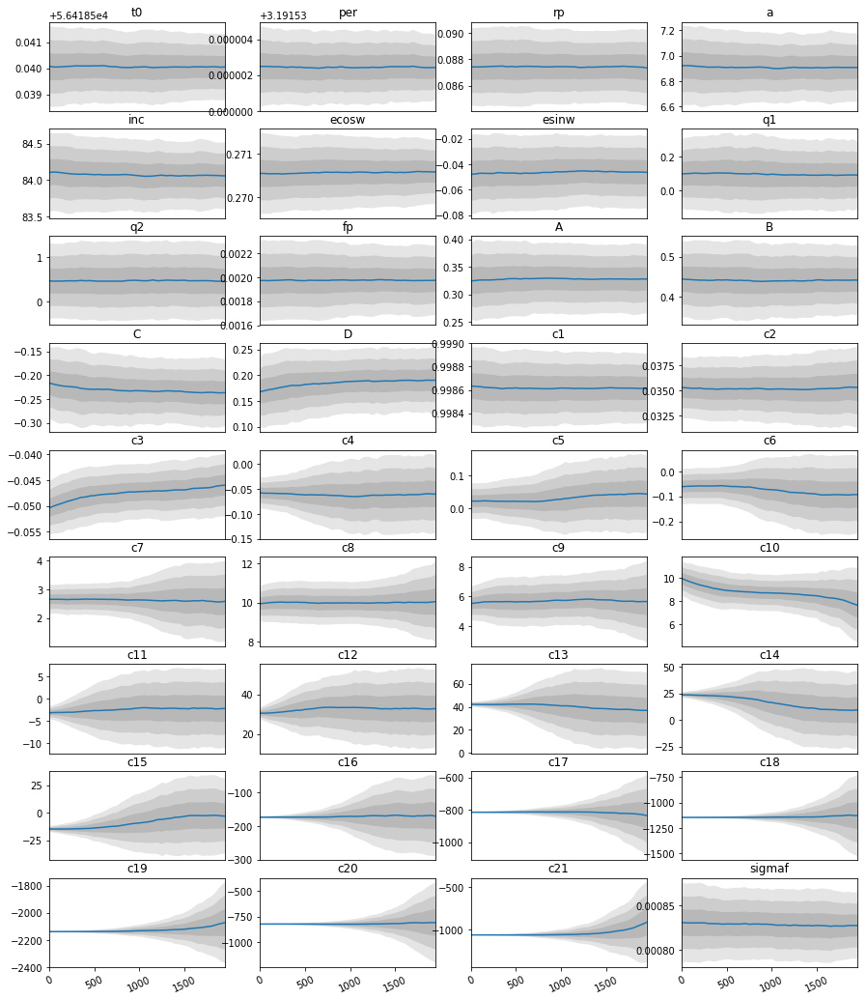

In [270]:
# see if the mcmc has converged
models_fit.walk_style(len(p0), nwalkers, samplechain, 50, 2000, p0_name)

pathplot2 = save_poly5_v2 + '02_Convergence_Criterion.pdf'
plt.savefig(pathplot2, bbox_inches='tight')

In [271]:
mcmc_detect = models_fit.detec_poly((xdata, ydata, mid_x, mid_y), c1_mcmc[0], c2_mcmc[0], 
                                     c3_mcmc[0], c4_mcmc[0], c5_mcmc[0], c6_mcmc[0], c7_mcmc[0], c8_mcmc[0], c9_mcmc[0], 
                                    c10_mcmc[0], c11_mcmc[0], c12_mcmc[0], c13_mcmc[0], c14_mcmc[0], c15_mcmc[0], c16_mcmc[0], c17_mcmc[0], c18_mcmc[0], c19_mcmc[0], c20_mcmc[0], c21_mcmc[0])

mcmc_pcurve = models_fit.phase_curve(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], 
                                     inc_mcmc[0], ecosw_mcmc[0], esinw_mcmc[0], q1_mcmc[0], 
                                     q2_mcmc[0], fp_mcmc[0], A_mcmc[0], B_mcmc[0], C=C_mcmc[0], D=D_mcmc[0])

orb_phase = (time-t0_mcmc[0])/per_mcmc[0]

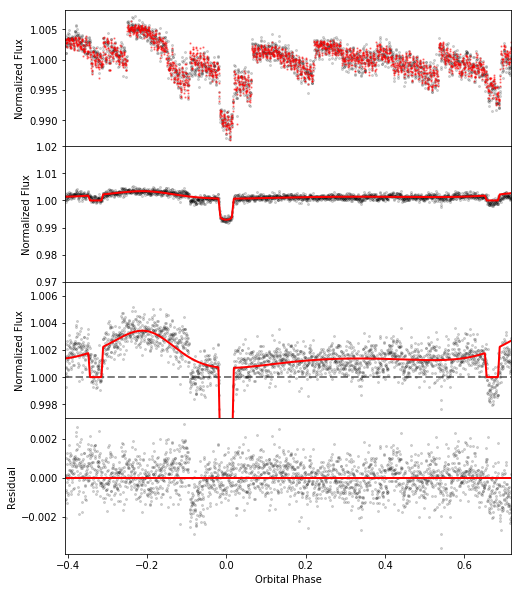

In [272]:
fig, axes = plt.subplots(ncols = 1, nrows = 4, sharex = True, figsize=(8, 10))

axes[0].set_xlim(np.min(orb_phase), np.max(orb_phase))
axes[0].plot(orb_phase, flux, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[0].plot(orb_phase, mcmc_pcurve*mcmc_detect, '.', color = 'r', markersize = 2.5, alpha = 0.4)
#axes[0].set_yticks(np.arange(0.97, 1.03, 0.01))
axes[0].set_ylabel('Normalized Flux')

axes[1].plot(orb_phase, flux/mcmc_detect, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[1].plot(orb_phase, mcmc_pcurve, color = 'r', linewidth=2)
axes[1].set_yticks(np.arange(0.97, 1.02, 0.01))
axes[1].set_ylabel('Normalized Flux')

axes[2].axhline(y=1, color='k', linewidth = 2, linestyle='dashed', alpha = 0.5)
axes[2].plot(orb_phase, flux/mcmc_detect, '.', color = 'k', markersize = 4, alpha = 0.15)
axes[2].plot(orb_phase, mcmc_pcurve, color = 'r', linewidth=2)
axes[2].set_yticks(np.arange(0.998, 1.007, 0.002))
axes[2].set_ylabel('Normalized Flux')
axes[2].set_ylim(0.997, 1.007)

axes[3].plot(orb_phase, flux/mcmc_detect - mcmc_pcurve, 'k.', markersize = 4, alpha = 0.15)
axes[3].axhline(y=0, color='r', linewidth = 2)
axes[3].set_ylabel('Residual')
axes[3].set_xlabel('Orbital Phase')

fig.subplots_adjust(hspace=0)

pathplot3 = save_poly5_v2 + '03_Fit.pdf'
fig.savefig(pathplot3, bbox_inches='tight')

In [273]:
data     = (flux/mcmc_detect)
fit      = mcmc_pcurve
ferr_fit = np.ones(len(flux))*sigmaf_mcmc[0]

# chi-square
chi_bin  = models_fit.get_chi2(data, fit, ferr_fit)
print('chi^2:', chi_bin)
# loglikelihood
logL_bin = models_fit.get_lnlike(data, fit, ferr_fit)
print('Lnlike: ', logL_bin)
# get Bayesian Information Criterion
BIC_bin  = models_fit.get_BIC(logL_bin, ndim, len(data))
print('BIC: ', BIC_bin)

gfit_name = ['chi2-bin', 'lnlike-bin', 'BIC-bin']
gfit_bin = [chi_bin, logL_bin, BIC_bin]

chi^2: 2363.04416861
Lnlike:  15756.8241724
BIC:  -31233.6478103


In [274]:
# getting goodness of fit on full dataset

FULL_detect = models_fit.detec_poly((XDATA, YDATA, mid_x, mid_y), c1_mcmc[0], c2_mcmc[0], 
                                     c3_mcmc[0], c4_mcmc[0], c5_mcmc[0], c6_mcmc[0], c7_mcmc[0], c8_mcmc[0], c9_mcmc[0], c10_mcmc[0], c11_mcmc[0], c12_mcmc[0], c13_mcmc[0], c14_mcmc[0], c15_mcmc[0], c16_mcmc[0], c17_mcmc[0], c18_mcmc[0], c19_mcmc[0], c20_mcmc[0], c21_mcmc[0])

FULL_detect = np.ma.masked_array(FULL_detect, mask=(XDATA_clip.mask+YDATA_clip.mask))

FULL_pcurve = models_fit.phase_curve(TIME, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], 
                                     inc_mcmc[0], ecosw_mcmc[0], esinw_mcmc[0], q1_mcmc[0], 
                                     q2_mcmc[0], fp_mcmc[0], A_mcmc[0], B_mcmc[0], C=C_mcmc[0], D=D_mcmc[0])

FULL_data = (FLUX_clip/FULL_detect)
FULL_fit  = FULL_pcurve
FULL_ferr = np.ones(len(FLUX))*sigmaf_mcmc[0]*np.sqrt(63)

# chi-square
chi_FULL  = models_fit.get_chi2(FULL_data, FULL_fit, FULL_ferr)
print('chi^2:', chi_FULL)
# loglikelihood
logL_FULL = models_fit.get_lnlike(FULL_data, FULL_fit, FULL_ferr)
print('Lnlike: ', logL_FULL)
# get Bayesian Information Criterion
BIC_FULL  = models_fit.get_BIC(logL_FULL, ndim, len(FULL_data))
print('BIC: ', BIC_FULL)

gfit_name2 = ['chi2-full', 'lnlike-full', 'BIC-full']
gfit_full  = [chi_FULL, logL_FULL, BIC_FULL]

chi^2: 63383.2242776
Lnlike:  732698.816835
BIC:  -1464967.89827


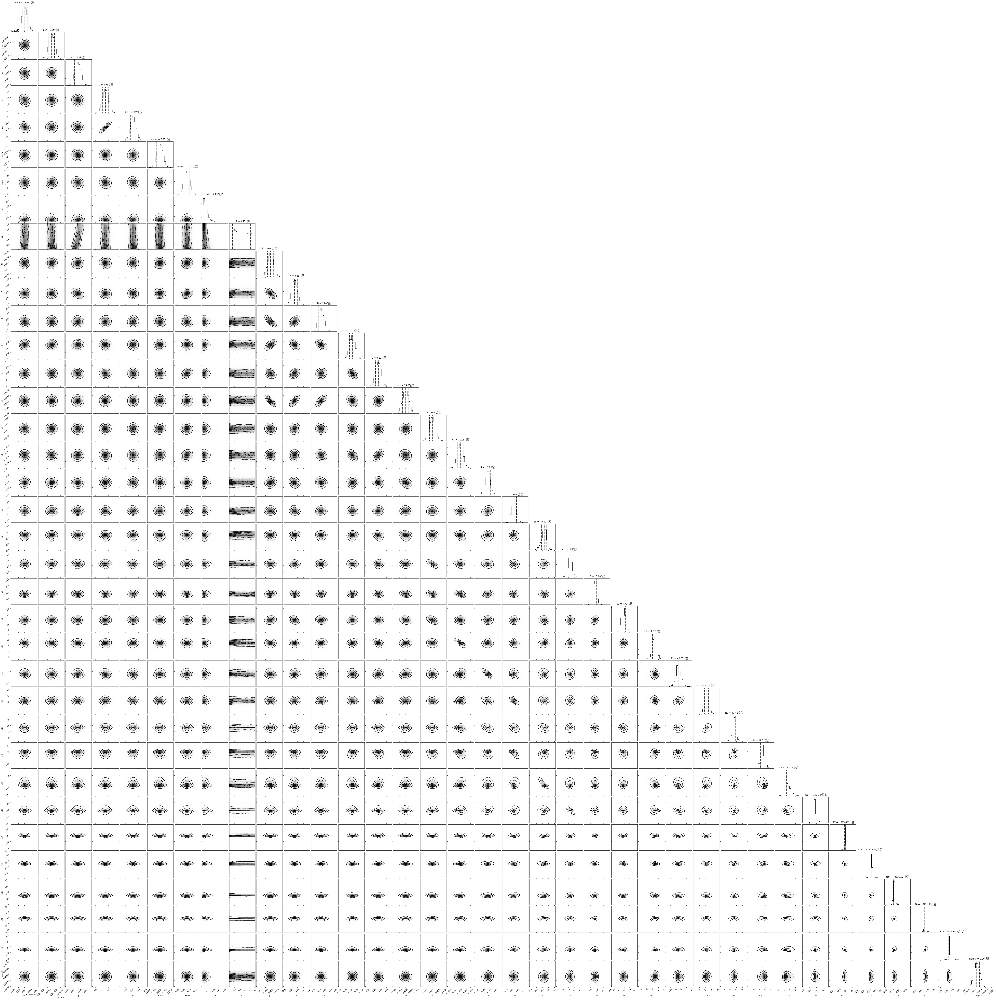

In [275]:
fig = corner.corner(samples, labels=p0_name, quantiles=[0.16, 0.5, 0.84], show_titles=True, 
                    title_kwargs={"fontsize": 12}, plot_datapoints=False)

pathplot4 = save_poly5_v2 + '04_Corner_plot.pdf'
fig.savefig(pathplot4, bbox_inches='tight')

In [276]:
# converting esinw and ecosw
e_chain = np.sqrt(samples[:,5]**2 + samples[:,6]**2)
w_chain = np.rad2deg(np.arctan(samples[:,6]/samples[:,5])) +360

# find a smart way to implement this
'''if (ecosw <= 0):
    w = np.arctan(esinw/ecosw) + np.pi                          # this is in radians!!
else:
    w = np.arctan(esinw/ecosw)'''

# getting u1 and u2 from Kipping (2013) parametrization q1 and q2 
u1_chain = 2*np.sqrt(samples[:,7]**2)*samples[:,8]
u2_chain = np.sqrt(samples[:,7]**2)*(1-2*samples[:,8])

# getting bin-delimitation
binse  = np.linspace(np.min(e_chain), np.max(e_chain), 20)
binsw  = np.linspace(np.min(w_chain), np.max(w_chain), 20)
binsu1 = np.linspace(np.min(u1_chain), np.max(u1_chain), 20)
binsu2 = np.linspace(np.min(u2_chain), np.max(u2_chain), 20)

# derived quantities
v = np.percentile(e_chain, [16, 50, 84])
e_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(w_chain, [16, 50, 84])
w_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(u1_chain, [16, 50, 84])
u1_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

v = np.percentile(u2_chain, [16, 50, 84])
u2_mcmc = [v[1], v[2]-v[1], v[1]-v[0]]

p0_name2      = ['ecc', 'w', 'u1', 'u2']
MCMC_Results2 = [e_mcmc, w_mcmc, u1_mcmc, u2_mcmc]

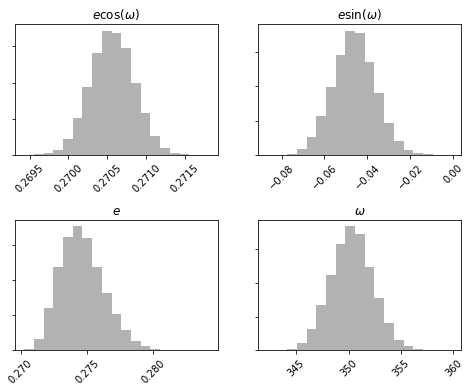

In [277]:
# Plotting Eccentricity and Longitude of Periastron 
fig, axes = plt.subplots(ncols = 2, nrows = 2, figsize = (8,6))
axes[0,0].hist(samples[:,5], bins=np.linspace(np.min(samples[:,5]), np.max(samples[:,5]), 20), color='k', alpha=0.3)
axes[0,1].hist(samples[:,6], bins=np.linspace(np.min(samples[:,6]), np.max(samples[:,6]), 20), color='k', alpha=0.3)
axes[1,0].hist(e_chain, binse, color='k', alpha=0.3)
axes[1,1].hist(w_chain, binsw, color='k', alpha=0.3)

plt.setp(axes[0,0].get_yticklabels(), visible=False)
plt.setp(axes[0,1].get_yticklabels(), visible=False)
plt.setp(axes[1,0].get_yticklabels(), visible=False)
plt.setp(axes[1,1].get_yticklabels(), visible=False)

plt.setp(axes[0,0].get_xticklabels(), rotation = 45)
plt.setp(axes[0,1].get_xticklabels(), rotation = 45)
plt.setp(axes[1,0].get_xticklabels(), rotation = 45)
plt.setp(axes[1,1].get_xticklabels(), rotation = 45)

axes[0,0].set_title('$e \cos (\omega)$', fontsize=12)
axes[0,1].set_title('$e \sin (\omega)$', fontsize=12)
axes[1,0].set_title('$e$', fontsize=12)
axes[1,1].set_title('$\omega$', fontsize=12)

fig.subplots_adjust(hspace=0.5)
fig.subplots_adjust(wspace=0.2)
pathplot5 = save_poly5_v2 + '05_Ecc_Omega.pdf'
fig.savefig(pathplot5, bbox_inches='tight')

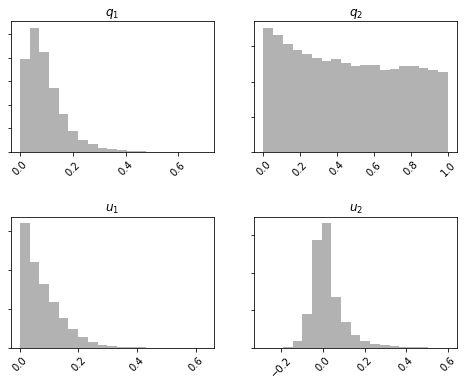

In [278]:
#Limb Darkening Coefficient

fig, axes = plt.subplots(ncols = 2, nrows = 2, figsize = (8,6))
axes[0,0].hist(samples[:,7], bins=np.linspace(np.min(samples[:,7]), np.max(samples[:,7]), 20), color='k', alpha=0.3)
axes[0,1].hist(samples[:,8], bins=np.linspace(np.min(samples[:,8]), np.max(samples[:,8]), 20), color='k', alpha=0.3)
axes[1,0].hist(u1_chain, binsu1, color='k', alpha=0.3)
axes[1,1].hist(u2_chain, binsu2, color='k', alpha=0.3)

plt.setp(axes[0,0].get_yticklabels(), visible=False)
plt.setp(axes[0,1].get_yticklabels(), visible=False)
plt.setp(axes[1,0].get_yticklabels(), visible=False)
plt.setp(axes[1,1].get_yticklabels(), visible=False)

plt.setp(axes[0,0].get_xticklabels(), rotation = 45)
plt.setp(axes[0,1].get_xticklabels(), rotation = 45)
plt.setp(axes[1,0].get_xticklabels(), rotation = 45)
plt.setp(axes[1,1].get_xticklabels(), rotation = 45)

axes[0,0].set_title('$q_1$', fontsize=12)
axes[0,1].set_title('$q_2$', fontsize=12)
axes[1,0].set_title('$u_1$', fontsize=12)
axes[1,1].set_title('$u_2$', fontsize=12)

fig.subplots_adjust(hspace=0.5)
fig.subplots_adjust(wspace=0.2)
fig.subplots_adjust(wspace=0.2)
pathplot6 = save_poly5_v2 + '06_Limb_Dark.pdf'
fig.savefig(pathplot6, bbox_inches='tight')

In [279]:
# determining in-eclipse and in-transit index

# generating transit model
trans, tsect, anomaly = models_fit.transit_model(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], 
                                                 a_mcmc[0], inc_mcmc[0], np.median(e_chain), 
                                                 np.median(np.deg2rad(w_chain)), 
                                                 np.median(u1_chain), np.median(u2_chain))
# generating secondary eclipses model
eclip = models_fit.eclipse(time, t0_mcmc[0], per_mcmc[0], rp_mcmc[0], a_mcmc[0], inc_mcmc[0], 
                           np.median(e_chain), np.median(np.deg2rad(w_chain)), np.median(u1_chain), np.median(u2_chain), 
                           fp_mcmc[0], tsect)

# get in-transit indices
ind_trans  = np.where(trans!=1)
# get in-eclipse indices
ind_eclip  = np.where((eclip!=(1+fp_mcmc[0])))
# seperating first and second eclipse
ind_ecli1 = ind_eclip[0][np.where(ind_eclip[0]<int(len(time)/2))]
ind_ecli2 = ind_eclip[0][np.where(ind_eclip[0]>int(len(time)/2))]

In [280]:
ResultMCMC_Params = Table()

for i in range(len(p0_name)):
    ResultMCMC_Params[p0_name[i]] = MCMC_Results[i]
    
for i in range(len(p0_name2)):
    ResultMCMC_Params[p0_name2[i]] = MCMC_Results2[i]
    
for i in range(len(gfit_name)):
    ResultMCMC_Params[gfit_name[i]] = gfit_bin[i]

for i in range(len(gfit_name)):
    ResultMCMC_Params[gfit_name2[i]] = gfit_full[i]
    
pathresu = save_poly5_v2 + '/mcmc_results.npy'
np.save(pathresu, ResultMCMC_Params)